In [13]:
from PIL import Image
import numpy as np 
import os 


import numpy as np
import matplotlib.pyplot as pl
import torch
import ot
import ot.plot

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Enable interactive mode
%matplotlib ipympl
os.environ["CUDA_VISIBLE_DEVICES"] = "1" # has not effect

import sys
sys.path.append("../")
device="cuda"
from tqdm import tqdm_notebook as tqdm

from gaussian_renderer import render, network_gui
from arguments import ModelParams, PipelineParams, OptimizationParams
import argparse
from scene import Scene, GaussianModel
from random import randint
from argparse import ArgumentParser, Namespace

saving_steps = [1, 100, 300, 1_000, 3_000, 7_000, 10_000, 15_000, 20_000, 30_000]
parser = ArgumentParser(description="Training script parameters")
lp = ModelParams(parser)
op = OptimizationParams(parser)
pp = PipelineParams(parser)
parser.add_argument('--ip', type=str, default="127.0.0.1")
parser.add_argument('--port', type=int, default=6009)
parser.add_argument('--debug_from', type=int, default=-1)
parser.add_argument('--detect_anomaly', action='store_true', default=False)
parser.add_argument("--test_iterations", nargs="+", type=int, default=saving_steps)
parser.add_argument("--save_iterations", nargs="+", type=int, default=saving_steps)
parser.add_argument("--quiet", action="store_true")
parser.add_argument("--checkpoint_iterations", nargs="+", type=int, default=saving_steps)# default=[])
parser.add_argument("--start_checkpoint", type=str, default = None)
args = parser.parse_args(("-s /home/dimakot55/data/nerf_synthetic/hotdog/ "+\
                         "--model_path /home/dimakot55/workspace/gaussian-splatting/notebooks/GT_lego_cluster2_test_notebook14/").split())#sys.argv[1:])
#args.save_iterations.append(args.iterations)
dataset=lp.extract(args)
pipe=pp.extract(args)
opt=op.extract(args)
os.makedirs(args.model_path, exist_ok=True)

In [14]:

# Functions from @Mateen Ulhaq and @karlo for visualizing 3d points with equal scaling of axes
def set_axes_equal(ax: plt.Axes):
    """Set 3D plot axes to equal scale.

    Make axes of 3D plot have equal scale so that spheres appear as
    spheres and cubes as cubes.  Required since `ax.axis('equal')`
    and `ax.set_aspect('equal')` don't work on 3D.
    """
    limits = np.array([
        ax.get_xlim3d(),
        ax.get_ylim3d(),
        ax.get_zlim3d(),
    ])
    origin = np.mean(limits, axis=1)
    radius = 0.5 * np.max(np.abs(limits[:, 1] - limits[:, 0]))
    _set_axes_radius(ax, origin, radius)

def _set_axes_radius(ax, origin, radius):
    x, y, z = origin
    ax.set_xlim3d([x - radius, x + radius])
    ax.set_ylim3d([y - radius, y + radius])
    ax.set_zlim3d([z - radius, z + radius])



# Load SAM masks

In [15]:
import pickle
with open('results_hotdog_SAM2.pkl', 'rb') as handle:
    results = pickle.load(handle)

## Visualize those masks

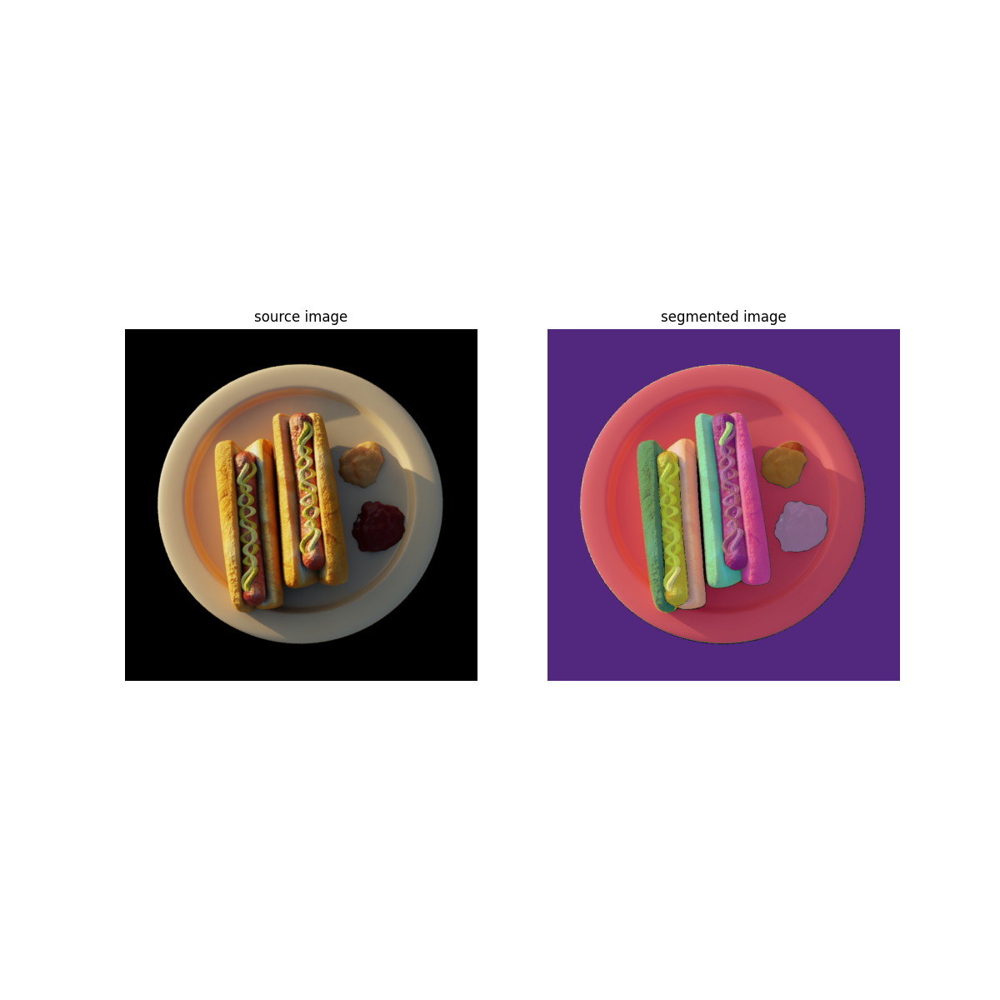

5


/home/dimakot55/miniconda3/envs/gs/lib/python3.9/site-packages/supervision/utils/notebook.py:88: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=size)


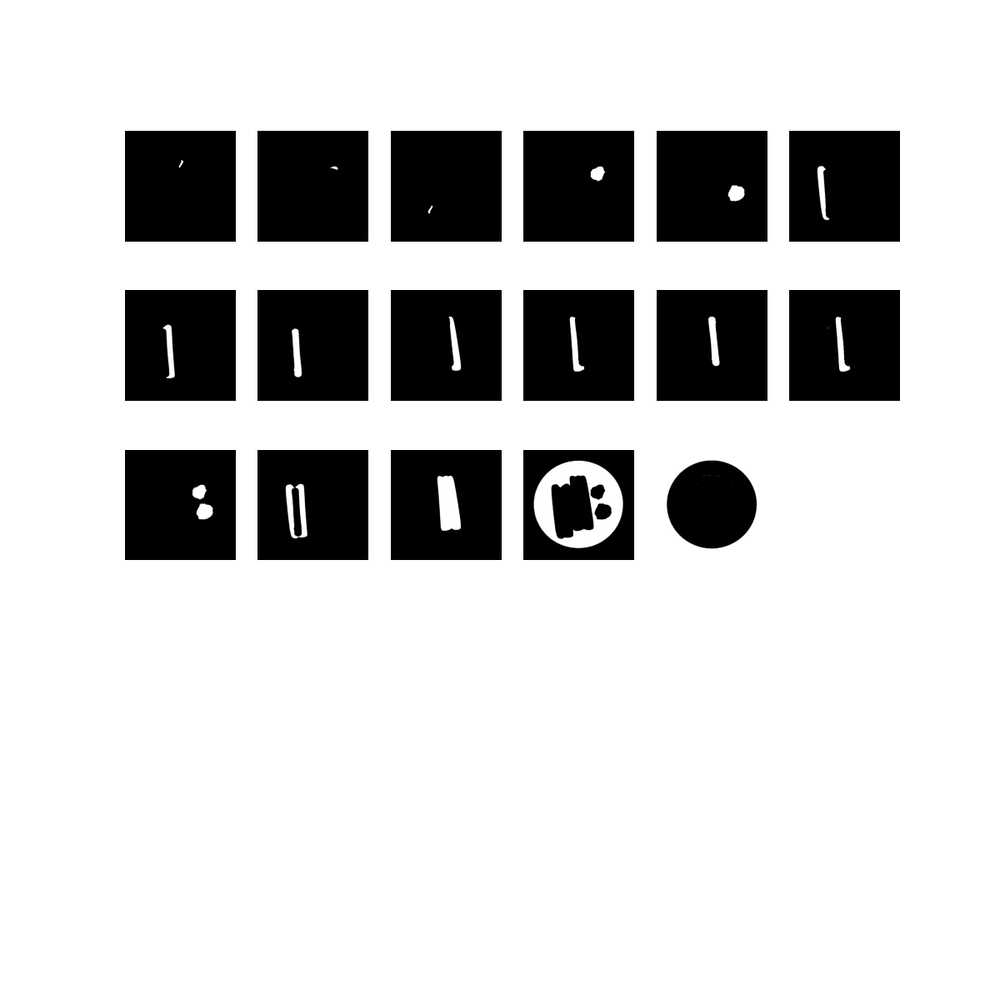

In [16]:
import supervision as sv

viewpoint_key = 0 #viewpoint_cam_idx
sv.plot_images_grid(
    images=[results[viewpoint_key]["image_bgr"], results[viewpoint_key]["annotated_image"]],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)


q = int(np.sqrt(len(results[viewpoint_key]["masks"]))) + 1
print(q)
sv.plot_images_grid(
    images=results[viewpoint_key]["masks"],
    grid_size=(q,q+1),
    size=(12, 12)
)

(800, 800)


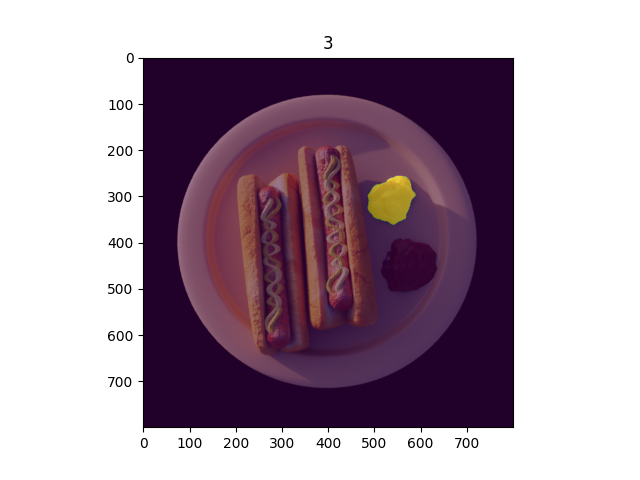

(800, 800)


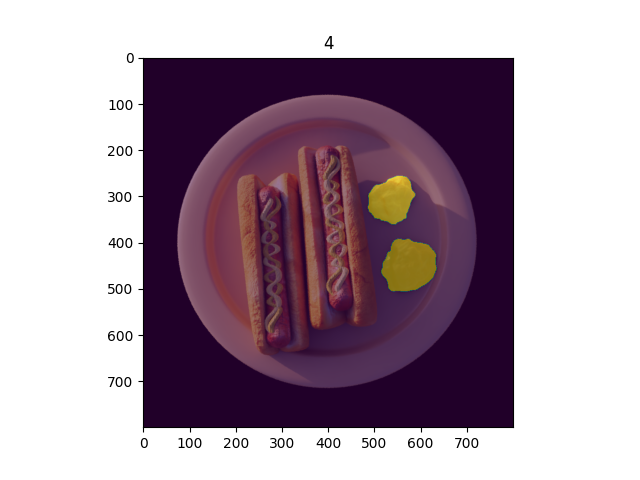

(800, 800)


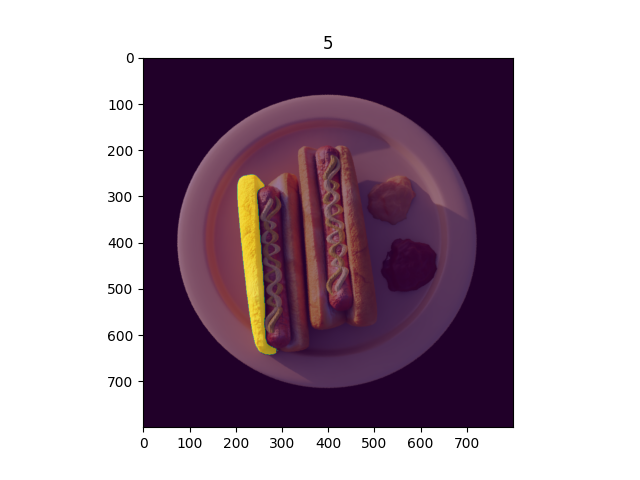

(800, 800)


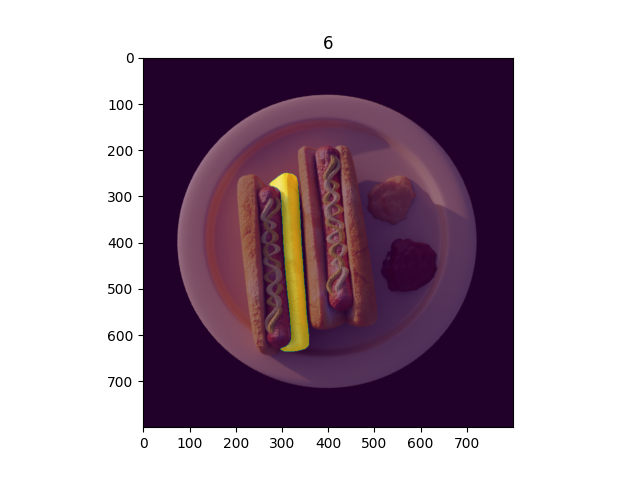

(800, 800)


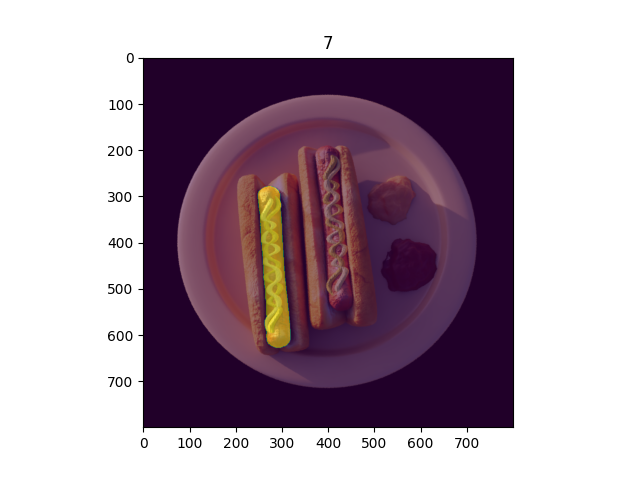

(800, 800)


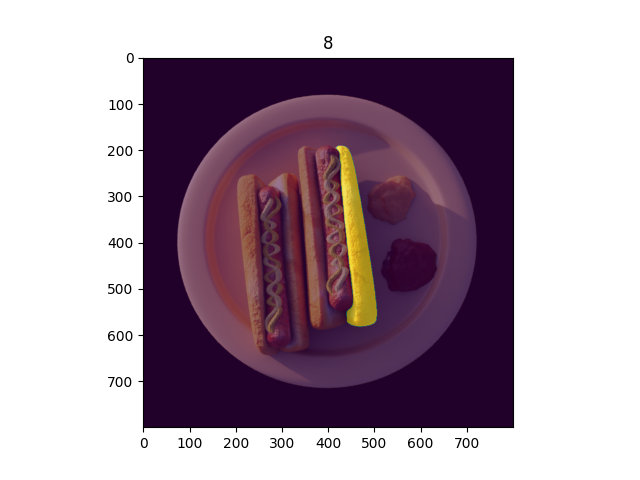

(800, 800)


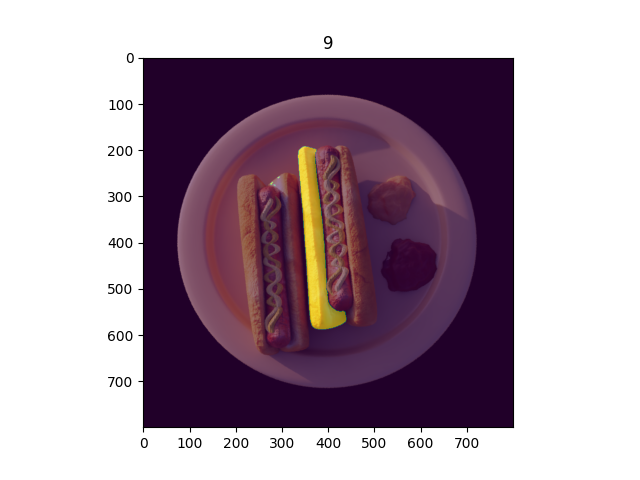

(800, 800)


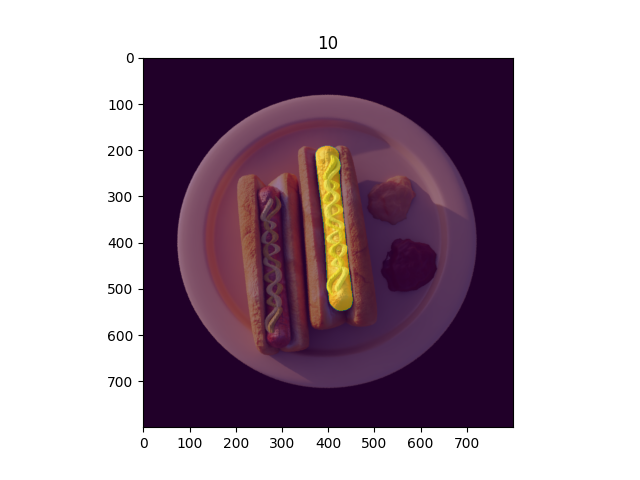

(800, 800)


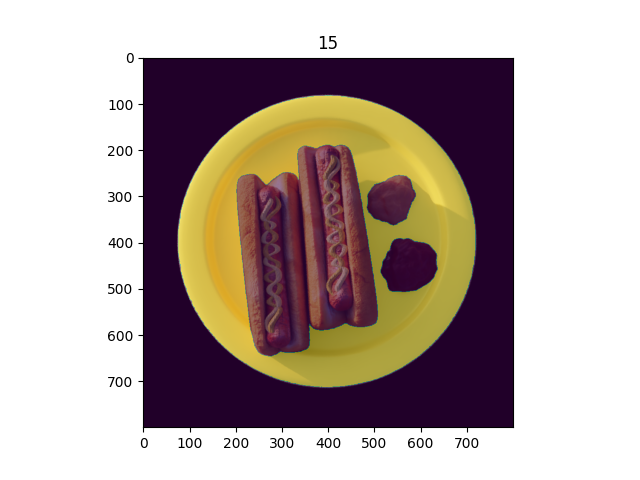

In [17]:

for mask, lbl in zip(results[viewpoint_key]["masks_clean_merged"], results[viewpoint_key]["masks_clean_lbl_merged"]):
    print(mask.shape)
    plt.figure()
    plt.title(f"{lbl}")
    plt.imshow(results[viewpoint_key]["image_rgb"])
    plt.imshow(mask, alpha=0.5)
    plt.show()
    

In [18]:
for key in results.keys():
    print(key, results[key]["masks_clean_lbl_merged"])

0 [ 3  4  5  6  7  8  9 10 15]
5 [ 4  5  6  7  8  9 10 15]
10 [ 4  7  8  9 15]
15 [15]
20 [ 5  9 10 15]
25 [ 3  4  5  7  8 15]
30 [ 4  5  6  7  8  9 10 15]
35 [ 5  6  8  9 10 15]
40 [ 5  6  7  8  9 10 15]
45 [ 4  5  6  7  8  9 10 15]
50 [ 5 15]
55 [ 4  5  6  7  8  9 10 15]
60 [ 3  4  5  6  8  9 10 15]
65 [ 5  6  7  8  9 10 15]
70 [ 4  5  6  7  8  9 10 15]
75 [ 3  4  8 15]
80 [ 5  9 10 15]
85 [ 4  5  6  8  9 15]
90 [ 4  5  6  7  8  9 10 15]
95 [ 5  6  8  9 10 15]
100 [ 4  5  6  7  8  9 10 15]
105 [ 4  5  6  7  8  9 10 15]
110 [ 4  6  7  8 10 15]
115 [ 3  4  7  8  9 10 15]
120 [ 3  4  6  7  8  9 15]
125 [ 3  4  8 10 15]
130 [ 3  4  7  8 15]
135 [ 3  4  5  7  8  9 15]
140 [ 3  4  5  6  7  8  9 10 15]
145 [ 4  5  6  7  8  9 10 15]
150 [ 5  6  7  8  9 10 15]
155 [ 5  6  7  8  9 10 15]
160 [ 5  6  8  9 10 15]
165 [ 5 10 15]
170 [ 5 10 15]
175 [ 5 10 15]
180 [ 5  9 15]
185 [ 5 15]
190 [ 5  8  9 15]
195 [ 5  8  9 15]
200 [ 6  8 15]
205 [15]
210 [15]
215 [15]
220 [15]
225 [15]
230 [15]
235 [15]

(800, 800)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


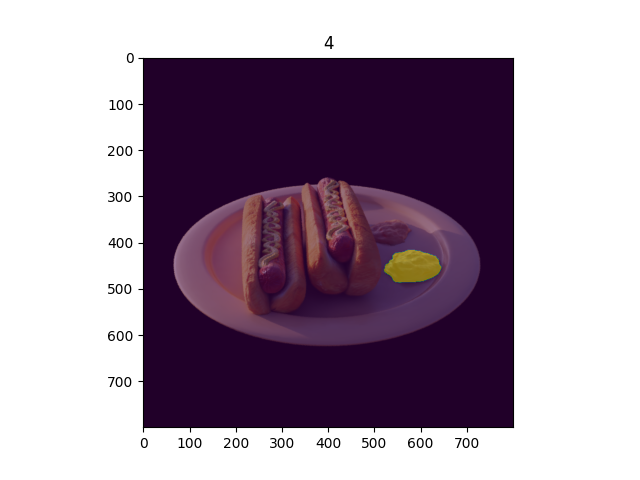

(800, 800)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


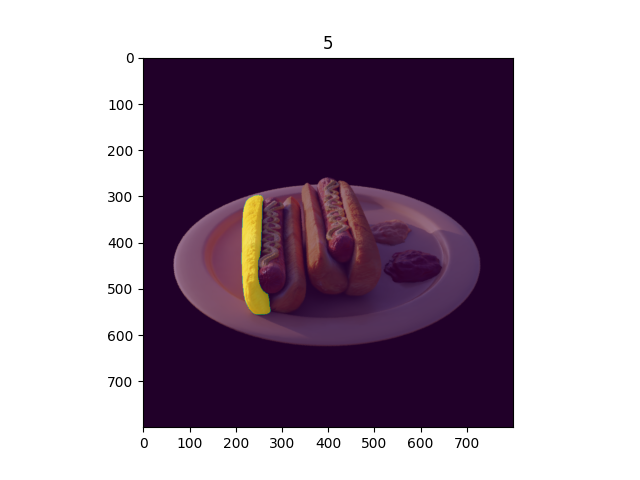

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(800, 800)


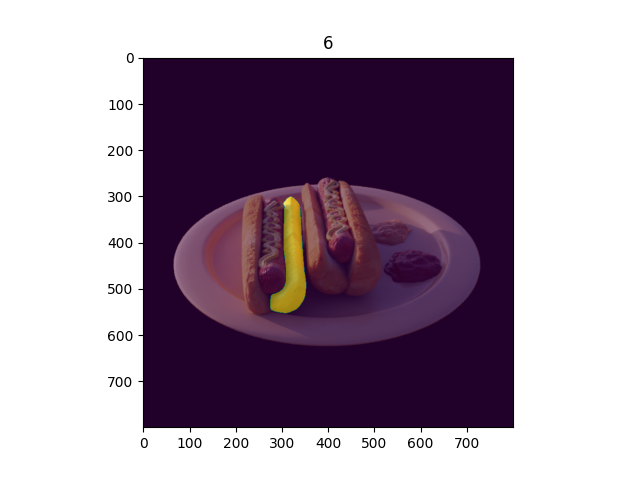

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(800, 800)


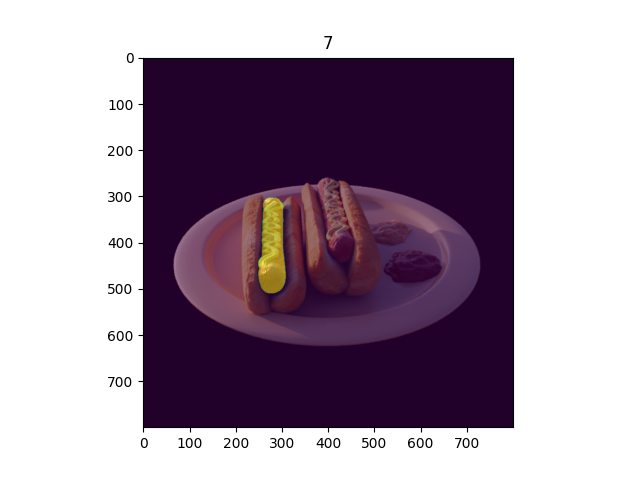

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(800, 800)


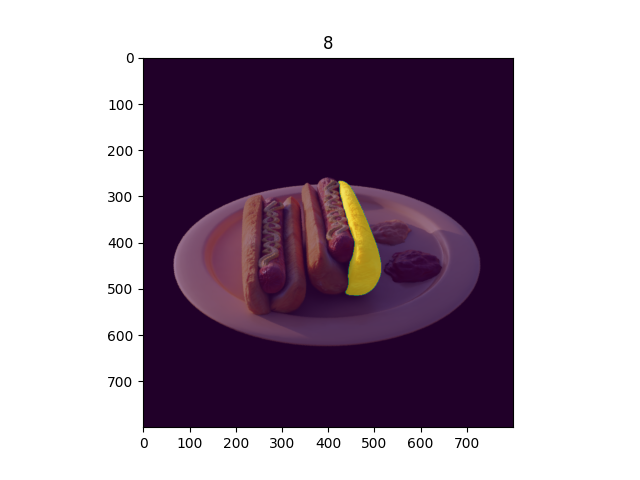

(800, 800)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


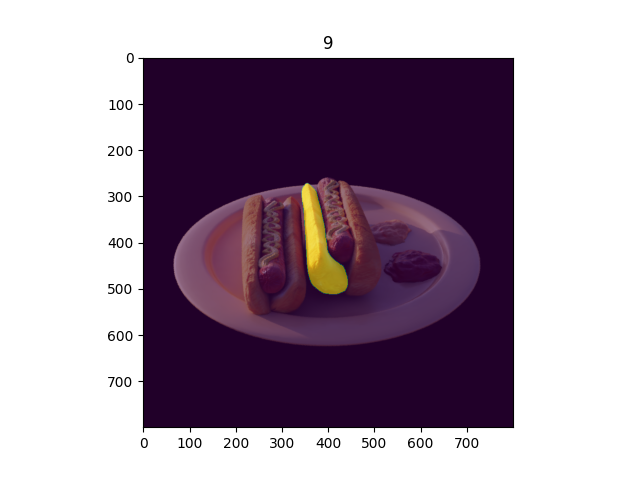

(800, 800)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


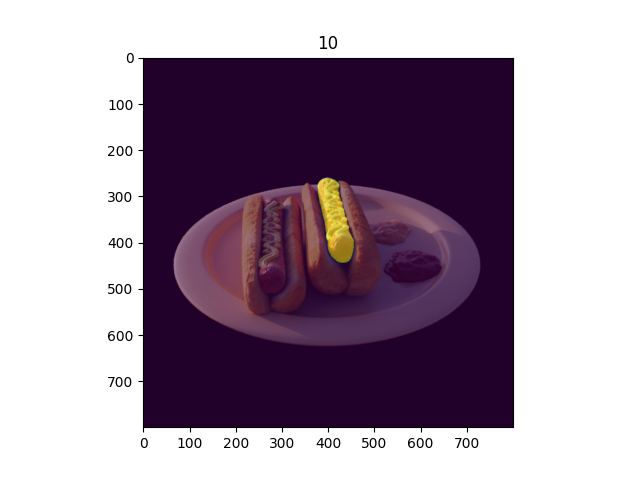

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(800, 800)


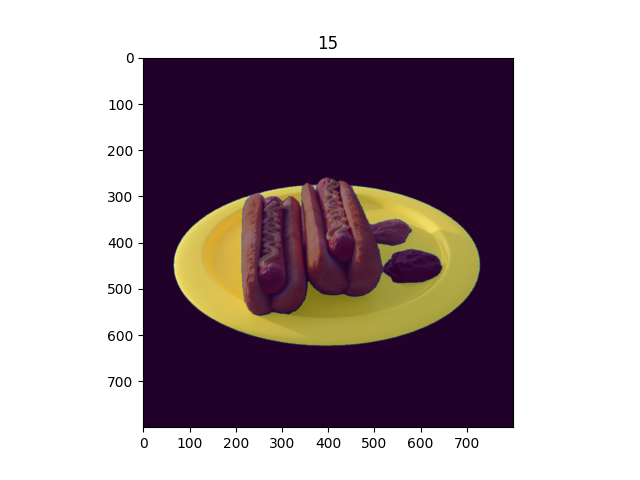

In [19]:
viewpoint_key=70
for mask, lbl in zip(results[viewpoint_key]["masks_clean_merged"], results[viewpoint_key]["masks_clean_lbl_merged"]):
    print(mask.shape)
    plt.figure()
    plt.title(f"{lbl}")
    plt.imshow(results[viewpoint_key]["image_rgb"])
    plt.imshow(mask, alpha=0.5)
    plt.show()
    

# Initialize the content scene

In [20]:
1.5e-3

0.0015

In [21]:
os.makedirs(args.model_path, exist_ok=True)
content_gaussians = GaussianModel(3)
content_scene = Scene(dataset, content_gaussians, shuffle=False)
content_gaussians.training_setup(opt)

Found transforms_train.json file, assuming Blender data set!
Reading Training Transforms
Reading Test Transforms
Loading Training Cameras
Loading Test Cameras
Number of points at initialisation :  100000


In [22]:
content_gaussians.restore(torch.load("/home/dimakot55/output_data/gs/GT_hotdog/chkpnt30000.pth")[0], opt)


In [23]:

bg_color = [1, 1, 1] if dataset.white_background else [0, 0, 0]
background = torch.tensor(bg_color, dtype=torch.float32, device=device)
viewpoint_stack = content_scene.getTrainCameras().copy()
viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
#viewpoint_cam = viewpoint_stack.pop(4) # 6, 2, 4, 5, 7


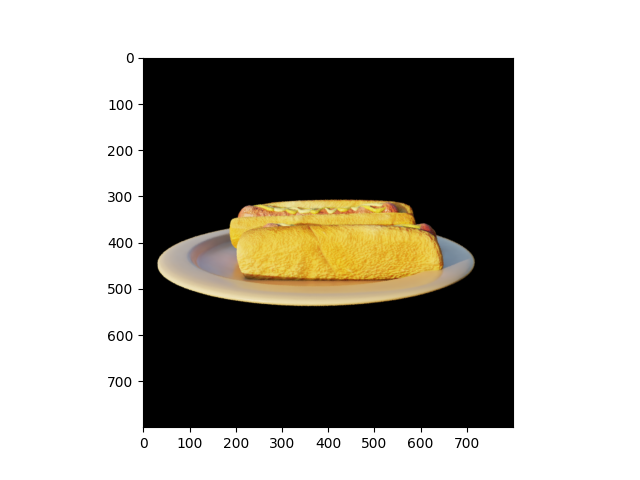

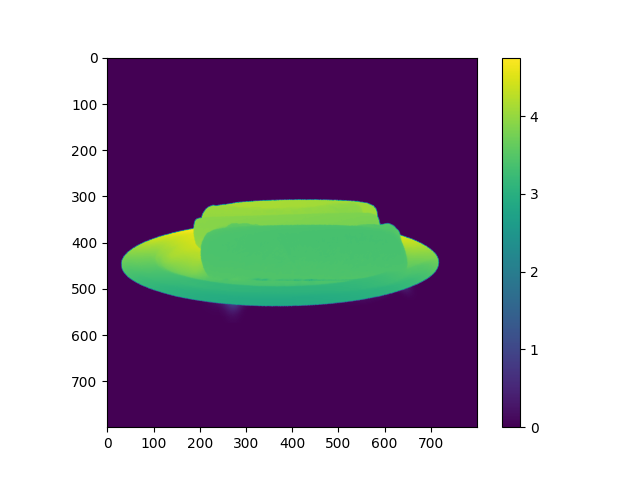

In [24]:

render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]

image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()


depth_np = depth_cont.detach().cpu().numpy()

plt.figure()
plt.imshow(depth_np)
plt.colorbar()
plt.show()


# Sample points for each mask as initialization 

In [25]:
content_gaussians._opacity.data +=  1e6
content_gaussians_features_ds_original = content_gaussians._features_dc.detach().clone()
content_gaussians._features_dc.data = content_gaussians._xyz.data.clone().detach().unsqueeze(1)
content_gaussians._features_rest.data = content_gaussians._features_rest.data * 0.


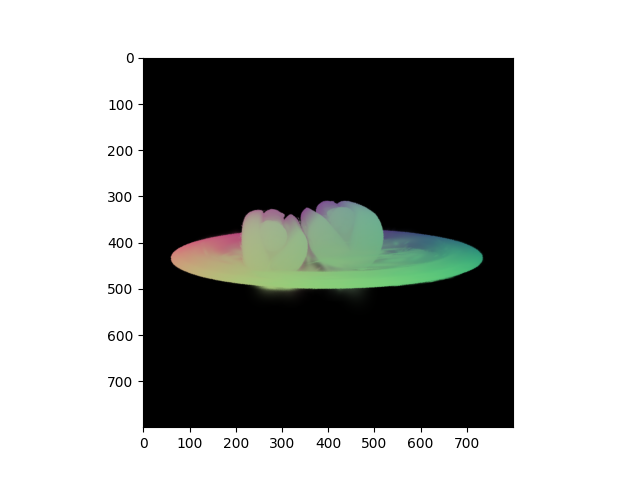

In [26]:


viewpoint_cam = viewpoint_stack[8]

render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]

image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()

# Init surface and find better initialization points.

In [27]:

def obtain_surface_pc(viewpoint_stack, gaussians, pipe, background, num_viewpoints=40, pc_size=20000):
    import numpy as np
    import skimage.measure, skimage.morphology
    import scipy

    # 1. Render from different viewpoints and extract points
    all_points = []
    for iter in range(min(num_viewpoints, len(viewpoint_stack))):
        viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
        render_pkg_cont = render(viewpoint_cam, gaussians, pipe, background)
        image = render_pkg_cont["render"]
        image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
        image_maxpool = skimage.measure.block_reduce(image_rgb, (3,3,1), np.max)
        mask = scipy.ndimage.binary_erosion(np.max(image_maxpool, axis=-1) > 0.1, structure=None, iterations=5)
        image_clean = image_maxpool * np.expand_dims(mask, axis=-1)
        all_points += list(image_clean[np.min(image_clean, axis=-1)>0.1])
    
    
    # 2. Subsample the points 
    all_points = np.array(all_points)
    all_points_idcs = np.random.choice(range(len(all_points)), size=pc_size, replace=False) 
    all_points = all_points[all_points_idcs]

    # 3. Remove poitns that are too far away from all other points.
    # Compute all pairwise distances between points
    from scipy.spatial import distance
    k=10
    pairwise_distances = distance.cdist(all_points, all_points, 'euclidean')
    # Use np.partition to find the k-th smallest distances for each row
    kth_nearest_indices = np.argpartition(pairwise_distances, k, axis=1)[:, :k]
    kth_nearest_distances = np.take_along_axis(pairwise_distances, kth_nearest_indices, axis=1)
    q_outliers = np.quantile(np.max(kth_nearest_distances, axis=-1), 0.99)
    idcs = np.where(np.max(kth_nearest_distances, axis=-1) < q_outliers)[0]
    all_points = all_points[idcs]
    return all_points
        

In [28]:

content_surface_pc = obtain_surface_pc(viewpoint_stack=viewpoint_stack, 
                               gaussians=content_gaussians, 
                               pipe=pipe, 
                               background=background,
                               num_viewpoints=40)
# Rescale back. This can be a very wrong way to do that. Check better the rasterization code for 


In [29]:
content_surface_pc_orig = np.array(content_surface_pc)
coords = content_gaussians._xyz.data.detach().cpu().numpy()
content_surface_pc = (content_surface_pc - np.min(content_surface_pc)) / (np.max(content_surface_pc)  - np.min(content_surface_pc))
content_surface_pc = content_surface_pc * (np.max(coords)  - np.min(coords)) + np.min(coords)


def normalize_points_according_to_target_distr(points):
    points_ = (points - np.min(content_surface_pc_orig)) / (np.max(content_surface_pc_orig)  - np.min(content_surface_pc_orig))
    points_ = points_ * (np.max(coords)  - np.min(coords)) + np.min(coords)
    return points_

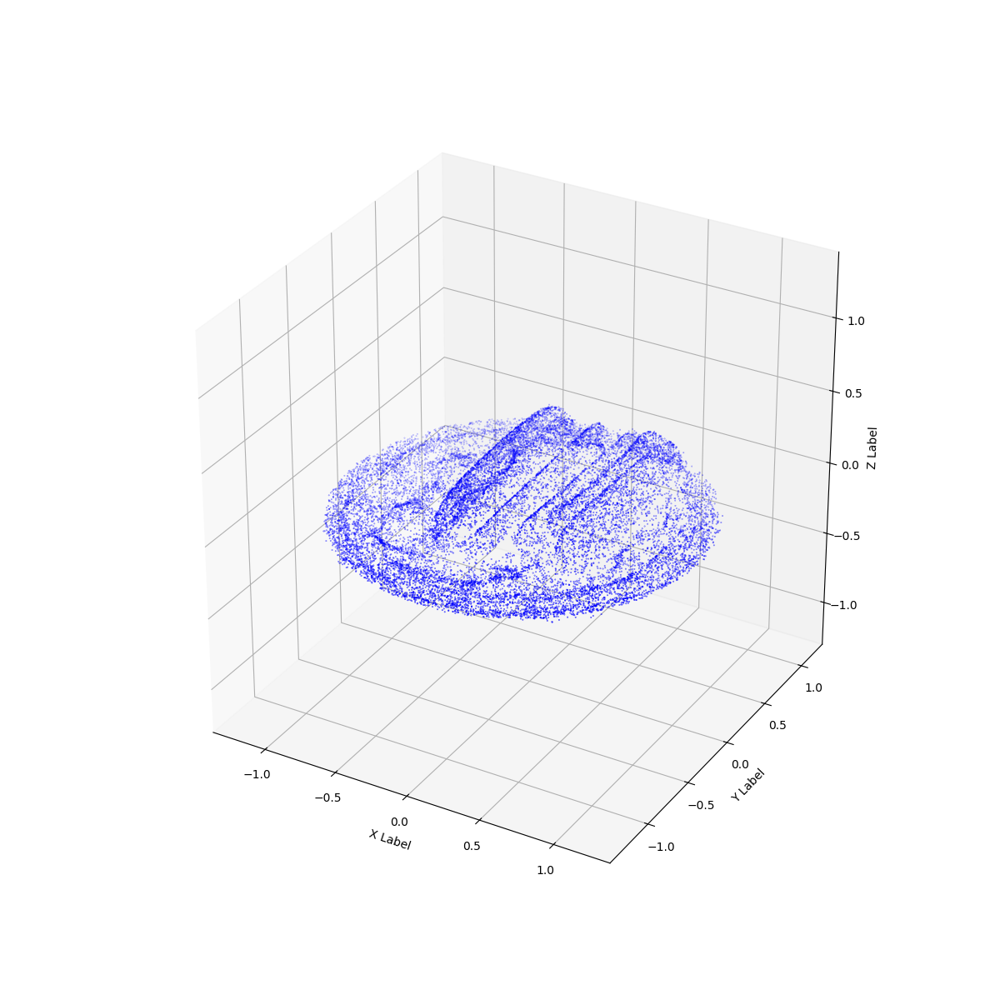

In [30]:
# Create a 3D scatter plot
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=1
if True:
    ax.scatter(content_surface_pc[::kth,0], 
               content_surface_pc[::kth,1], 
               content_surface_pc[::kth,2], c='b', marker='o',s=0.1)



# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()

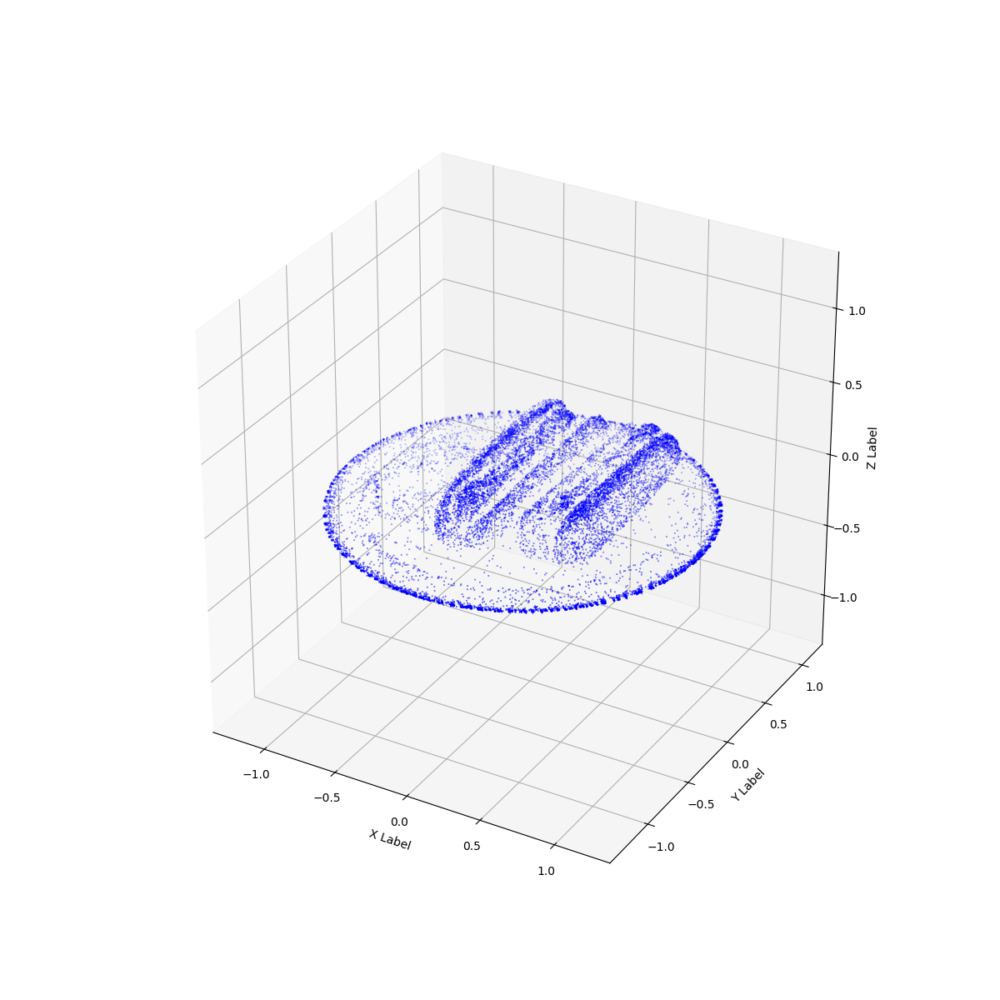

In [169]:
# Create a 3D scatter plot
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=10
if True:
    arr = content_gaussians._xyz.data.detach().cpu().numpy()
    ax.scatter(arr[::kth,0], 
               arr[::kth,1], 
               arr[::kth,2], c='b', marker='o',s=0.1)



# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()

In [31]:
results[0]["masks_clean_lbl_merged"]

array([ 3,  4,  5,  6,  7,  8,  9, 10, 15])

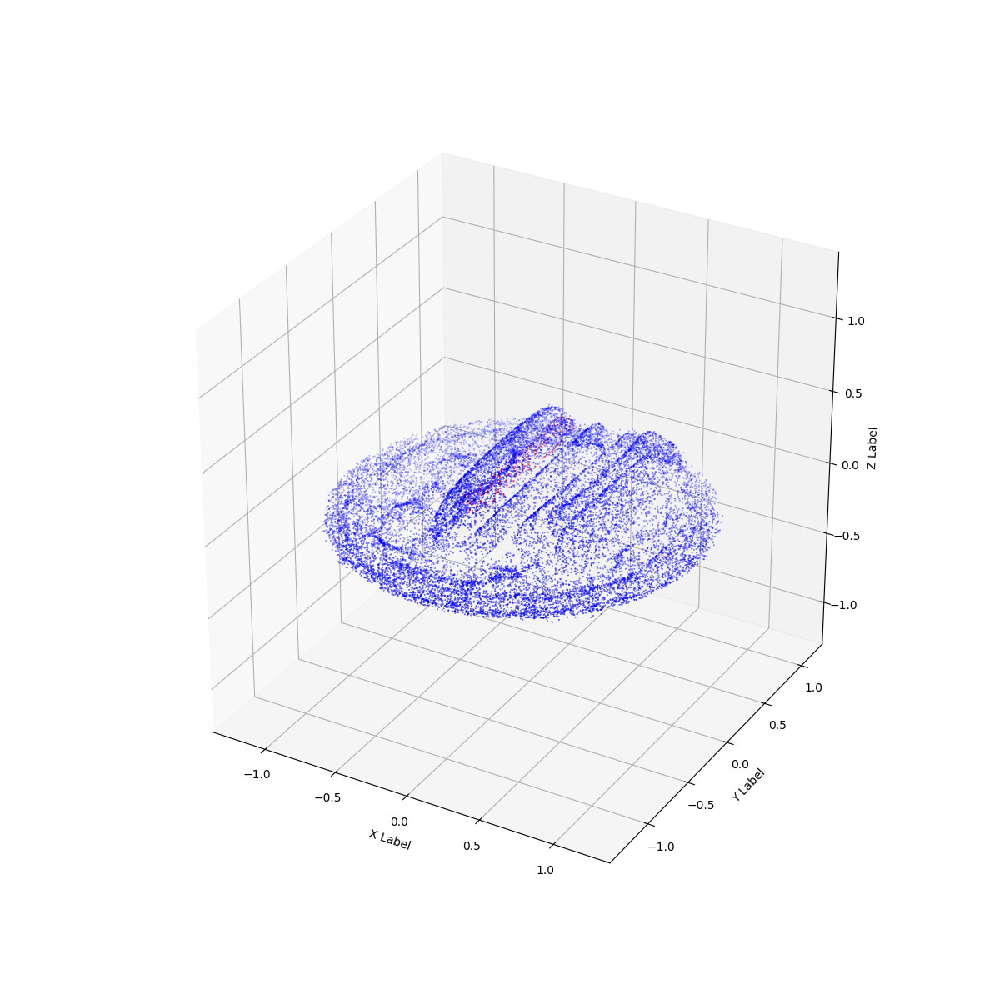

In [32]:
# Create a 3D scatter plot
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=1
if True:
    ax.scatter(content_surface_pc[::kth,0], 
               content_surface_pc[::kth,1], 
               content_surface_pc[::kth,2], c='b', marker='o',s=0.1)


kth=10
if True:
    #arr = results[0]["masks_points"][15]
    arr = normalize_points_according_to_target_distr(results[0]["masks_points"][10]) 
    ax.scatter(arr[::kth,0], 
               arr[::kth,1], 
               arr[::kth,2], c='r', marker='o',s=0.5)



# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()

In [298]:
def load_cluster(path_to_cluster="/home/dimakot55/output_data/gs_my/GT_rose_bush_spheres_clusters_30/cluster_15.npz",
                 preprocess_points=True):
    loaded_data = np.load(path_to_cluster)
    # Access the arrays by their names
    gaussians_xyz = loaded_data['_xyz']
    gaussians_features_dc = loaded_data['_features_dc']
    gaussians_features_rest = loaded_data['_features_rest']
    gaussians_rotation = loaded_data['_rotation']
    gaussians_scaling = loaded_data['_scaling']
    gaussians_opacity = loaded_data['_opacity']

    if not preprocess_points:
        return {"_xyz" : gaussians_xyz,
        "_features_dc" : gaussians_features_dc,
        "_features_rest" : gaussians_features_rest,
        "_rotation" : gaussians_rotation,
        "_scaling" : gaussians_scaling,
        "_opacity" : gaussians_opacity}
    
    # 1. Remove poitns that are too far away from all other points. These are just noise
    # Compute all pairwise distances between points
    from scipy.spatial import distance
    k=10
    pairwise_distances = distance.cdist(gaussians_xyz, gaussians_xyz, 'euclidean')
    # Use np.partition to find the k-th smallest distances for each row
    kth_nearest_indices = np.argpartition(pairwise_distances, k, axis=1)[:, :k]
    kth_nearest_distances = np.take_along_axis(pairwise_distances, kth_nearest_indices, axis=1)
    q_outliers = np.quantile(np.max(kth_nearest_distances, axis=-1), 0.925) # was 0.925
    idcs = np.where(np.max(kth_nearest_distances, axis=-1) < q_outliers)[0]
    gaussians_xyz = gaussians_xyz[idcs]
    gaussians_features_dc = gaussians_features_dc[idcs]
    gaussians_features_rest = gaussians_features_rest[idcs]
    gaussians_rotation = gaussians_rotation[idcs]
    gaussians_scaling = gaussians_scaling[idcs]
    gaussians_opacity = gaussians_opacity[idcs]
    
    
    return {"_xyz" : gaussians_xyz,
        "_features_dc" : gaussians_features_dc,
        "_features_rest" : gaussians_features_rest,
        "_rotation" : gaussians_rotation,
        "_scaling" : gaussians_scaling,
        "_opacity" : gaussians_opacity}
            

In [34]:
import kornia
def shade_image_gpu(img_color, img_depth,
                drct_lght_color = np.array([1., 1., 1.]), drct_lght_dir = np.array([0., 0., 1.]),
                ambnt_lght=np.array([0.1, 0.1, 0.1]) ):
    """
    Relights the image given by the color of every pixel and its normals. Additionally use the sf
    Implementation is taken from this video https://youtu.be/wOyavGx28uU?t=1084 .
    :param img_color: numpy array of shape [H,W,D] with values in [0,1]
    :param img_normals: numpy array of shape [H,W,D] with values in [0,1] and norm along last dim is 1
    :param 
    
    """

     
    K = torch.tensor([[1111, 0, 400],
                      [0,    1111, 400],
                      [0, 0,    1  ]], dtype=torch.float32).unsqueeze(0).to(device="cuda")
    normals = kornia.geometry.depth.depth_to_normals(depth=img_depth.unsqueeze(0).unsqueeze(0),
                                                     camera_matrix=K,
                                                     normalize_points=True)
    #normals

    #print(normals)
    #print(normals[0].shape)
    image_normals = normals.squeeze(0).squeeze(0)
    #print(image_normals.shape)
    mins = torch.min(image_normals)
    maxs = torch.max(image_normals)
    image_normals = (image_normals - mins) / (maxs - mins + 1e-6)
    # image_normals = normals.squeeze(0).squeeze(0)
    
    drct_lght_color = drct_lght_color.unsqueeze(-1).unsqueeze(-1)
    ambnt_lght = ambnt_lght.unsqueeze(-1).unsqueeze(-1)
    drct_lght_dir = drct_lght_dir / (1e-6 + torch.linalg.norm(drct_lght_dir))
    #print("drct_lght_color.shape:", drct_lght_color.shape)
    #print("image_normals.shape:", image_normals.shape)
    #print("drct_lght_dir.shape:", drct_lght_dir.shape)
    #print("ambnt_lght.shape:", ambnt_lght.shape)
    #print(torch.einsum('ihw,i->hw', image_normals, drct_lght_dir))
    reflected_light = drct_lght_color * (torch.clamp(torch.einsum('ihw,i->hw', image_normals, drct_lght_dir), 0.,1.).unsqueeze(0))
    #print("reflected_light.shape:", reflected_light.shape)
    color =  img_color * torch.clamp((reflected_light*(1.-torch.max(ambnt_lght))+ambnt_lght), 0., 1.)
    return color 


In [35]:
# cluster_lego = load_cluster("/home/dimakot55/output_data/gs/GT_lego_spheres_v5_clusters_100/cluster_51.npz")
# cluster_rose_bush = load_cluster(os.path.join("/home/dimakot55/output_data/gs_my/GT_rose_bush_spheres_clusters_30/", "cluster_15.npz"))
# cluster_coast_rocks = load_cluster("/home/dimakot55/output_data/gs_my/GT_coast_rocks_spheres_clusters_30/cluster_14.npz")

# content_shape_style_clusters = {"plate" : (cluster_rose_bush, 15),
#                        "ketchup" : (cluster_coast_rocks, 1),
#                        "mustard" : (cluster_coast_rocks, 1),
#                        "central_hotdog_sausage" : (cluster_coast_rocks, 2),
#                        "central_hotdog_bun_central" : (cluster_lego, 10),
#                        "central_hotdog_bun_outter" : (cluster_lego, 10),
#                        "outter_hotdog_sausage" : (cluster_coast_rocks, 2),
#                        "outter_hotdog_bun_central" : (cluster_lego, 10),
#                        "outter_hotdog_bun_outter" : (cluster_lego, 10)}




# content_shape_style_clusters = {"plate" : (cluster3, 10),
#                        "ketchup" : (cluster_coast_rocks, 1),
#                        "mustard" : (cluster_coast_rocks, 1),
#                        "central_hotdog_sausage" : (cluster2, 2),
#                        "central_hotdog_bun_central" : (cluster1, 4),
#                        "central_hotdog_bun_outter" : (cluster1, 4),
#                        "outter_hotdog_sausage" : (cluster2, 2),
#                        "outter_hotdog_bun_central" : (cluster1, 4),
#                        "outter_hotdog_bun_outter" : (cluster1, 4)}





In [36]:
! ls /home/dimakot55/output_data/gs/

GT_chair   GT_hotdog_spheres_v1  GT_lego_cluster3		  GT_materials
GT_drums   GT_lego		 GT_lego_spheres_v5		  GT_mic
GT_ficus   GT_lego_cluster1	 GT_lego_spheres_v5_clusters_100  GT_ship
GT_hotdog  GT_lego_cluster2	 GT_lego_spheres_v5_clusters_500


In [37]:
! ls /home/dimakot55/output_data/gs_my

GT_grass_spheres_clusters_2    style_scenes_spheres_anisotropic
GT_pebbles_spheres_clusters_5  style_scenes_spheres_new


In [297]:
! ls /home/dimakot55/output_data/style_clusters/

GT_anthurium_spheres_1_clusters      GT_pine_cone_spheres_1_clusters
GT_bark_fragment_spheres_5_clusters  GT_rocks4_spheres_10_clusters
GT_bark_spheres_6_clusters	     GT_rocks4_spheres_6_clusters
GT_brickwall_spheres_9_clusters      GT_rose_bush_spheres_10_clusters
GT_cotoneaster2_spheres_6_clusters   GT_rose_bush_spheres_5_clusters
GT_grass_spheres_3_clusters	     GT_skull_spheres_1_clusters
GT_pebbles_spheres_10_clusters	     GT_wicker_basket_spheres_10_clusters
GT_pebbles_spheres_5_clusters


In [42]:


# cluster_lego = load_cluster("/home/dimakot55/output_data/gs_my/GT_pebbles_spheres_clusters_4/cluster_1.npz")
# cluster_rose_bush = load_cluster(os.path.join("/home/dimakot55/output_data/gs_my/GT_rose_bush_spheres_clusters_30/", "cluster_15.npz"))
# cluster_coast_rocks = load_cluster("/home/dimakot55/output_data/gs_my/GT_skull_spheres_clusters_3/cluster_0.npz")



# cluster1 = load_cluster("/home/dimakot55/output_data/style_clusters/GT_bark_fragment_spheres_5_clusters/cluster_1.npz")
cluster1 = load_cluster("/home/dimakot55/output_data/style_clusters/GT_skull_spheres_1_clusters/cluster_0.npz")
print(cluster1["_xyz"].shape)

#cluster_rose_bush = load_cluster(os.path.join("/home/dimakot55/output_data/gs_my/GT_anthurium_spheres_clusters_1/", "cluster_0.npz"))
# cluster_rose_bush = load_cluster("/home/dimakot55/output_data/gs_my/GT_rocks4_spheres_clusters_4/cluster_0.npz")
#cluster2 = load_cluster("/home/dimakot55/output_data/style_clusters/GT_rocks4_spheres_10_clusters/cluster_0.npz")
cluster2 = load_cluster("/home/dimakot55/output_data/style_clusters/GT_grass_spheres_3_clusters/cluster_0.npz")
print(cluster2["_xyz"].shape)

# cluster_rose_bush = load_cluster(os.path.join("/home/dimakot55/output_data/gs_my/GT_anthurium_spheres_clusters_5/", "cluster_0.npz"))
cluster3 = load_cluster("/home/dimakot55/output_data/style_clusters/GT_pebbles_spheres_10_clusters/cluster_1.npz")
print(cluster3["_xyz"].shape)





(20853, 3)
(21029, 3)
(12553, 3)


In [600]:
! ls /home/dimakot55/output_data/gs_my/

GT_grass_spheres_clusters_2    style_scenes_spheres_anisotropic
GT_pebbles_spheres_clusters_5  style_scenes_spheres_new


In [623]:


cluster1 = load_cluster("/home/dimakot55/output_data/style_clusters/GT_pebbles_spheres_10_clusters/cluster_1.npz",
                       preprocess_points=False)
print(cluster1["_xyz"].shape)
cluster2 = load_cluster("/home/dimakot55/output_data/style_clusters/GT_rose_bush_spheres_10_clusters/cluster_1.npz",
                       preprocess_points=False)
print(cluster2["_xyz"].shape)
cluster3 = load_cluster("/home/dimakot55/output_data/style_clusters/GT_rocks4_spheres_10_clusters/cluster_0.npz",
                       preprocess_points=False)
print(cluster3["_xyz"].shape)





(13571, 3)
(22987, 3)
(22735, 3)


In [100]:
# cluster1["_xyz"] /= 2.
# cluster1["_scaling"]*= 1.2

# cluster2["_xyz"] /= 2.
# cluster2["_scaling"] *=  1.2

# Plot masks from a target view
afterwards define a dictionary mapping label to the cluster and number of those clusters

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(800, 800)


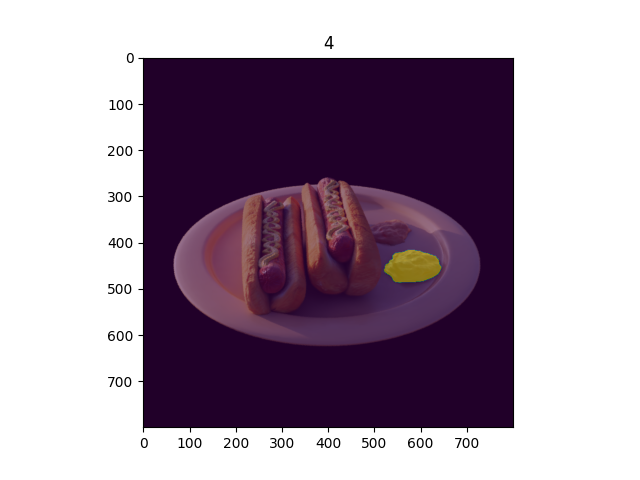

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(800, 800)


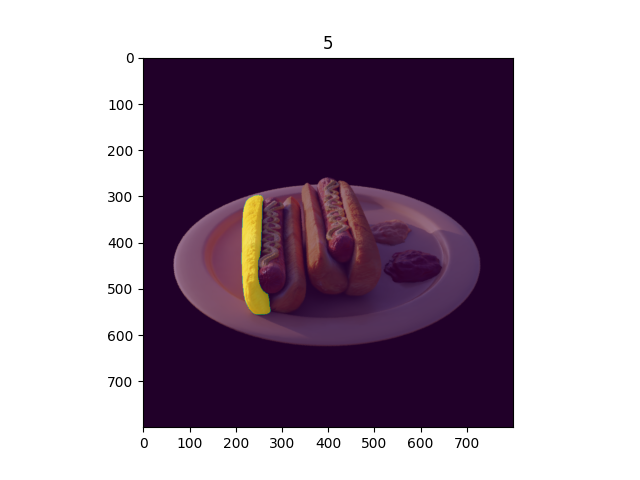

(800, 800)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


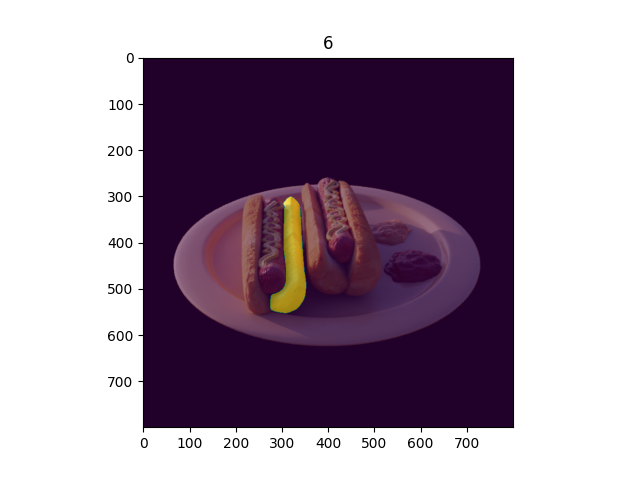

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(800, 800)


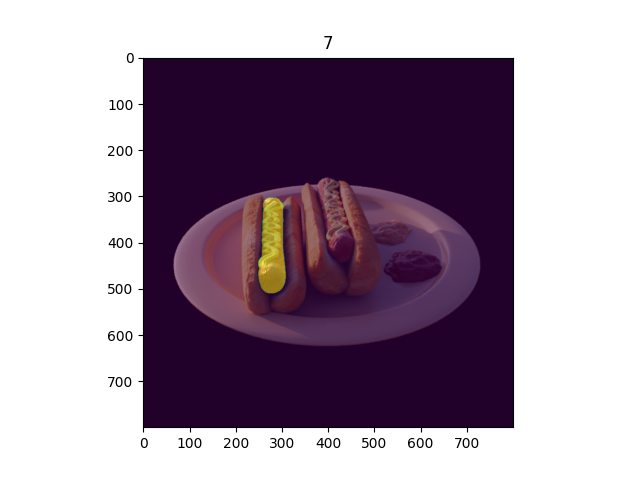

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(800, 800)


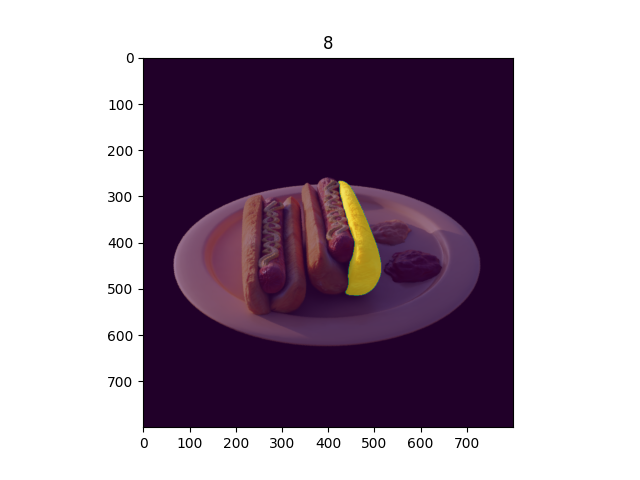

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(800, 800)


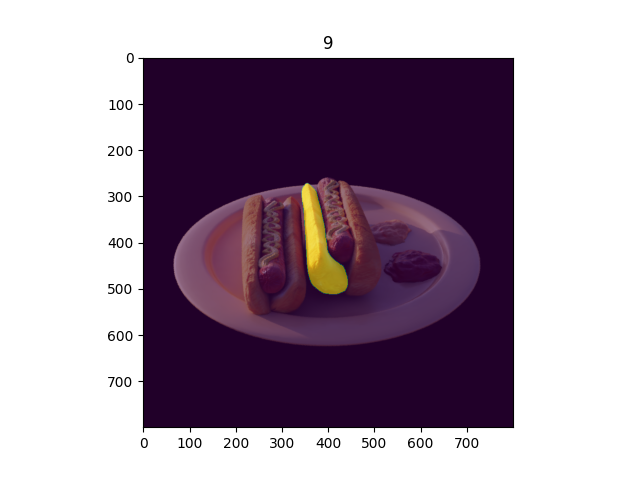

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(800, 800)


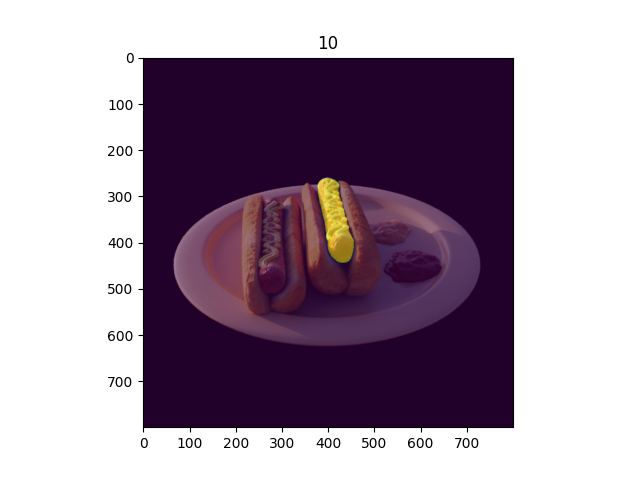

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(800, 800)


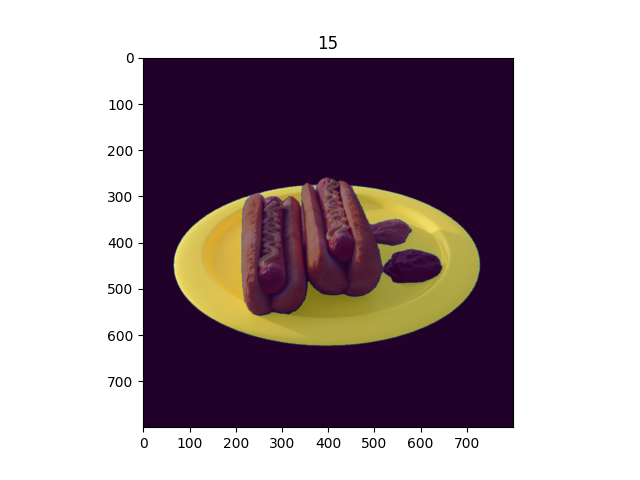

In [43]:

for mask, lbl in zip(results[viewpoint_key]["masks_clean_merged"], results[viewpoint_key]["masks_clean_lbl_merged"]):
    print(mask.shape)
    plt.figure()
    plt.title(f"{lbl}")
    plt.imshow(results[viewpoint_key]["image_rgb"])
    plt.imshow(mask, alpha=0.5)
    plt.show()
    

In [624]:

# cluster1 = load_cluster("/home/dimakot55/output_data/gs_my/GT_bark_fragment_spheres_clusters_5/cluster_1.npz")
# cluster1 = load_cluster("/home/dimakot55/output_data/gs_my/GT_rose_bush_spheres_clusters_10/cluster_1.npz")
# cluster2 = load_cluster("/home/dimakot55/output_data/gs_my/GT_rocks4_spheres_clusters_10/cluster_0.npz")
# cluster3 = load_cluster("/home/dimakot55/output_data/gs_my/GT_pebbles_spheres_clusters_10/cluster_1.npz")

content_shape_style_clusters = {3 : (cluster2, 1),
                                4 : (cluster2, 2),
                                5 : (cluster1, 5),
                                 6 : (cluster1, 5),
                                 8 : (cluster1, 5),
                                 9 : (cluster1, 5),
                                7 : (cluster2, 5),
                                10 : (cluster2, 5),
                                15 : (cluster3, 10)}
                                


# Better intialization of points.
Cluster content points. For each key_points obtained perform clustering. compute radius of key_points cluster and style cluster
renormalize accordingly cluster["_xyz"] accordingly.


In [260]:

# content_shape_style_clusters = {4 : (cluster1, 2),
#                                 5 : (cluster1, 5),
#                                  6 : (cluster1, 5),
#                                  8 : (cluster1, 5),
#                                  9 : (cluster1, 5),
#                                 7 : (cluster1, 5),
#                                 10 : (cluster1, 5),
#                                 15 : (cluster3, 10)}

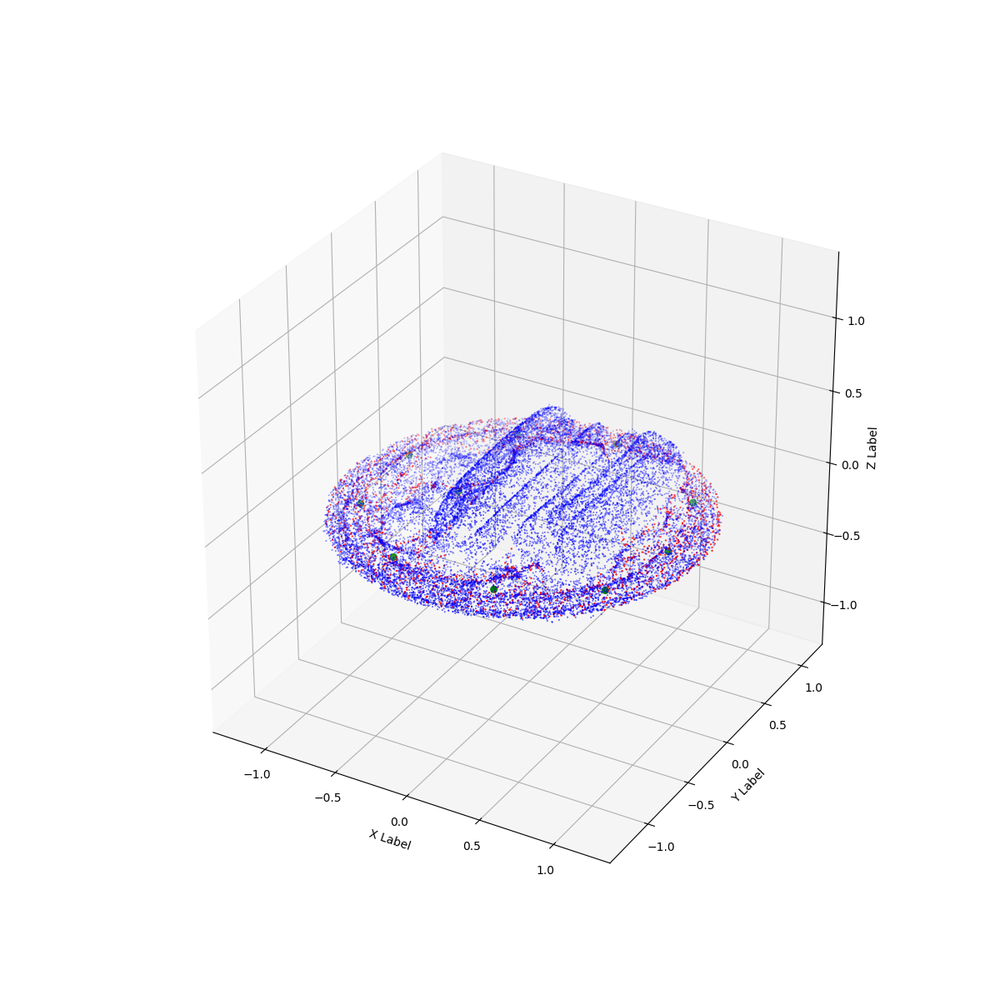

In [182]:
# Create a 3D scatter plot
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=1
if True:
    ax.scatter(content_surface_pc[::kth,0], 
               content_surface_pc[::kth,1], 
               content_surface_pc[::kth,2], c='b', marker='o',s=0.1)


kth=10
if True:
    #arr = results[0]["masks_points"][15]
    arr = normalize_points_according_to_target_distr(results[0]["masks_points"][key])
    ax.scatter(arr[::kth,0], 
               arr[::kth,1], 
               arr[::kth,2], c='r', marker='o',s=0.5)


kth=1
if True:
    #arr = results[0]["masks_points"][15]
    arr = kmeans.cluster_centers_
    ax.scatter(arr[::kth,0], 
               arr[::kth,1], 
               arr[::kth,2], c='g', marker='o',s=30.5)



# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()

In [625]:

if False:
    # Simple version with random sampling of cluster centers.
    
    
    content_shape_cluster_centers = []
    #obj_to_num_points_style_cluster = 
    for key in content_shape_style_clusters.keys():
        key_points = normalize_points_according_to_target_distr(results[0]["masks_points"][key])
        
        idcs = np.random.choice(len(key_points), size=content_shape_style_clusters[key][1], replace=False)
        content_shape_cluster_centers += list(key_points[idcs])
else:
    # More clever version where we first compute K-means clustering on points to cover. And we compute 
    # the diameter of each of those cluster as well as the diameter of the style cluster. And we bring
    # them both in accordance with each other

    
    content_shape_cluster_centers = []
    content_shape_cluster_scalings = []
    for key in content_shape_style_clusters.keys():
        print(key)
        key_points = normalize_points_according_to_target_distr(results[0]["masks_points"][key])

        from sklearn.cluster import KMeans
        kmeans = KMeans(n_clusters=content_shape_style_clusters[key][1])
        kmeans.fit(key_points)
        
        # Centers gonna be kmeans cluster_centers
        content_shape_cluster_centers += list(kmeans.cluster_centers_)

        # Now find optimal scalings
        # First for style cluster
        # only take every 10th point to accelerate computation of large clusters
        cluster_points = torch.tensor(content_shape_style_clusters[key][0]["_xyz"][::10]).to("cuda")
        cluster_distances = torch.cdist(cluster_points, cluster_points)
        style_cluster_diameter = torch.max(cluster_distances)
        style_cluster_diameter = float(style_cluster_diameter.detach().cpu().numpy())
        print(cluster_diameter)

        # Now for each k_means.cluster
        # get diameters of clusters of the kmeans clustering

        # Initialize maximum diameter variable for each cluster
        max_diameters = np.zeros(kmeans.n_clusters)
        
        # Calculate diameter (max distance) for each cluster
        for cluster in range(kmeans.n_clusters):
            # Extract points belonging to the current cluster
            cluster_points = key_points[kmeans.labels_ == cluster]
        
            # Calculate pairwise distances within the cluster
            if len(cluster_points) > 1:
                cluster_points = torch.tensor(cluster_points).to("cuda")
                distances = torch.cdist(cluster_points, cluster_points)
                max_diameters[cluster] = float(torch.max(distances).detach().cpu().numpy())
        
        print("Maximum diameters for each cluster:", max_diameters)
        print("\n\n")

        content_shape_cluster_scalings += list(max_diameters/style_cluster_diameter)

        
        
                                                 

3
tensor(0.6314, device='cuda:0')
Maximum diameters for each cluster: [0.48819554]



4
tensor(0.6314, device='cuda:0')
Maximum diameters for each cluster: [0.38813752 0.49550024]



5
tensor(0.6314, device='cuda:0')
Maximum diameters for each cluster: [0.29546434 0.28597373 0.28088456 0.32762325 0.33527112]



6


/home/dimakot55/miniconda3/envs/gs/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/home/dimakot55/miniconda3/envs/gs/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/home/dimakot55/miniconda3/envs/gs/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/home/dimakot55/miniconda3/envs/gs/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The 

tensor(0.6314, device='cuda:0')
Maximum diameters for each cluster: [0.28445065 0.28454617 0.32567427 0.2845915  0.31396428]



8
tensor(0.6314, device='cuda:0')
Maximum diameters for each cluster: [0.28122085 0.33224419 0.3636606  0.28259322 0.29404131]



9
tensor(0.6314, device='cuda:0')
Maximum diameters for each cluster: [0.29595724 0.32607108 0.30721253 0.27898243 0.30938113]



7
tensor(0.6314, device='cuda:0')
Maximum diameters for each cluster: [0.26665252 0.27257818 0.27447471 0.25957337 0.25016862]



10


/home/dimakot55/miniconda3/envs/gs/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/home/dimakot55/miniconda3/envs/gs/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/home/dimakot55/miniconda3/envs/gs/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/home/dimakot55/miniconda3/envs/gs/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The 

tensor(0.6314, device='cuda:0')
Maximum diameters for each cluster: [0.27060711 0.27813828 0.25317106 0.27525884 0.27378201]



15


/home/dimakot55/miniconda3/envs/gs/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


tensor(0.6314, device='cuda:0')
Maximum diameters for each cluster: [0.78184241 0.81179976 0.85878509 0.88558704 0.77533668 0.82790691
 0.83994681 0.78823948 0.8137027  0.71638215]





In [626]:
content_shape_cluster_scalings

[0.44091550818996844,
 0.35054775820883666,
 0.4475127719451847,
 0.47408565480962145,
 0.45885755076815726,
 0.4506917613916214,
 0.5256860565669943,
 0.5379574069090256,
 0.45641370527450964,
 0.4565669656511218,
 0.5225588275968525,
 0.456639698578681,
 0.5037696314348556,
 0.45123135268325687,
 0.5331005592736539,
 0.5835095947212249,
 0.45343337673399414,
 0.4718023382034269,
 0.4748765357359205,
 0.5231955395826842,
 0.492936155122263,
 0.44763970412570236,
 0.49641576341073723,
 0.2408281601540719,
 0.2461799365232898,
 0.24789279457837105,
 0.23443459722951798,
 0.22594066556554812,
 0.2443997613728747,
 0.251201560356976,
 0.2286523252094528,
 0.24860098334099723,
 0.24726718432373532,
 0.8209118201600715,
 0.8523661717320318,
 0.9016994015111202,
 0.9298406639370819,
 0.8140809949818957,
 0.8692782029224702,
 0.8819197480052092,
 0.8276285562637812,
 0.8543642012391087,
 0.7521804437307741]

In [609]:

def sigmoid(x):
  return 1 / (1 + np.exp(-x))
def sigmoid_inverse(x):
    return -np.log(1/x -1.)

# print(cluster1["_scaling"][:5])
# print(sigmoid(cluster1["_scaling"])[:5])
# print(sigmoid_inverse(sigmoid(cluster1["_scaling"]))[:5])

# print(sigmoid_inverse(sigmoid(cluster1["_scaling"])) - cluster1["_scaling"])


In [627]:

dict_name_to_style_idcs = {}
start_idx = 0
for key in content_shape_style_clusters.keys():
    num_elements = len(content_shape_style_clusters[key][0]["_xyz"]) * content_shape_style_clusters[key][1]
    dict_name_to_style_idcs[key] = (start_idx, start_idx+ num_elements)
    start_idx = start_idx+ num_elements
    
dict_name_to_style_idcs

{3: (0, 22987),
 4: (22987, 68961),
 5: (68961, 136816),
 6: (136816, 204671),
 8: (204671, 272526),
 9: (272526, 340381),
 7: (340381, 455316),
 10: (455316, 570251),
 15: (570251, 797601)}

In [628]:
#style_clusters = [cluster_rose_bush]*20 + [cluster_lego]*20 + [cluster_coast_rocks]*20

style_clusters = []
for key in content_shape_style_clusters.keys():
    style_clusters += [content_shape_style_clusters[key][0]] * content_shape_style_clusters[key][1]

In [265]:
# Load randomly.
import random
if False:
    if False:
    
        CLUSTERS_DIR = "/home/dimakot55/output_data/gs_my/GT_rose_bush_spheres_clusters_30/"
        style_clusters = []
        ! date
        for _ in tqdm(range(len(content_shape_cluster_centers))):
            cluster_name = random.choice(os.listdir(CLUSTERS_DIR))
            style_clusters.append(load_cluster(os.path.join(CLUSTERS_DIR, cluster_name)))
        ! date
    else:
        CLUSTERS_DIR = "/home/dimakot55/output_data/gs_my/GT_rose_bush_spheres_clusters_30/"
        
        style_clusters = []
        
        cluster = load_cluster(os.path.join(CLUSTERS_DIR, "cluster_15.npz"))
        style_clusters = [cluster]*len(content_shape_cluster_centers)
                               
        

In [629]:
gaussians_opt = GaussianModel(3)#.to(device="cuda")
scene_opt = Scene(dataset, gaussians_opt, shuffle=True)


Found transforms_train.json file, assuming Blender data set!
Reading Training Transforms
Reading Test Transforms
Loading Training Cameras
Loading Test Cameras
Number of points at initialisation :  100000


In [630]:
C = len(content_shape_cluster_centers)
gaussians_opt._features_dc.data = torch.concat([torch.tensor(x["_features_dc"]).to(device=device) for x in style_clusters])
gaussians_opt._features_rest.data = torch.concat([torch.tensor(x["_features_rest"]).to(device=device) for x in style_clusters])
gaussians_opt._rotation.data = torch.concat([torch.tensor(x["_rotation"]).to(device=device) for x in style_clusters])
gaussians_opt._scaling.data = torch.concat([torch.tensor(x["_scaling"]).to(device=device) for x in style_clusters])
gaussians_opt._opacity.data = torch.concat([torch.tensor(x["_opacity"]).to(device=device) for x in style_clusters])

N = len(gaussians_opt._features_dc.data)
gaussians_opt.max_radii2D.data = torch.concat([torch.tensor(content_gaussians.max_radii2D[:1])]*N).to(device=device)
gaussians_opt.xyz_gradient_accum.data = torch.concat([torch.tensor(content_gaussians.xyz_gradient_accum[:1])]*N).to(device=device)
gaussians_opt.denom.data = torch.concat([torch.tensor(content_gaussians.denom[:1])]*N).to(device=device)


/tmp/ipykernel_719905/2013949410.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  gaussians_opt.max_radii2D.data = torch.concat([torch.tensor(content_gaussians.max_radii2D[:1])]*N).to(device=device)
/tmp/ipykernel_719905/2013949410.py:10: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  gaussians_opt.xyz_gradient_accum.data = torch.concat([torch.tensor(content_gaussians.xyz_gradient_accum[:1])]*N).to(device=device)
/tmp/ipykernel_719905/2013949410.py:11: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  gaussians_opt.denom.data = torch.concat

In [631]:
# Make clusters a bit larger
#content_shape_cluster_scalings = [x/(1.2*1.05) for x in content_shape_cluster_scalings]

In [632]:
gaussians_opt_features_dc_original = gaussians_opt._features_dc.data.detach().clone()
gaussians_opt_features_rest_original = gaussians_opt._features_rest.data.detach().clone()

# No scaling version
# gaussians_opt._xyz.data = torch.concat([torch.tensor( (cluster["_xyz"] - np.mean(cluster["_xyz"], axis=0))*1. + cluster_center).to(device=device) 
#                                           for cluster, cluster_center in zip(style_clusters, content_shape_cluster_centers)])
SCALING_CONSTANT = 1.05
# Version with scaling
gaussians_opt._xyz.data = torch.concat(
    [torch.tensor( (cluster["_xyz"] - np.mean(cluster["_xyz"], axis=0))*cluster_scaling*SCALING_CONSTANT + cluster_center).to(device=device) 
     for cluster, cluster_center, cluster_scaling in zip(style_clusters, content_shape_cluster_centers, content_shape_cluster_scalings)])

In [633]:
# Scale the very scaling parameter accordingly

gaussians_opt._scaling.data = torch.concat(
    [torch.tensor( sigmoid_inverse(sigmoid(cluster["_scaling"]) * cluster_scaling * SCALING_CONSTANT)).to(device=device) 
     for cluster, cluster_scaling in zip(style_clusters, content_shape_cluster_scalings)])


In [635]:

with torch.no_grad():
    gaussians_opt._features_dc.data = gaussians_opt._xyz.data.clone().detach().unsqueeze(1)
    gaussians_opt._features_rest.data = gaussians_opt._features_rest.data * 0.

In [109]:
# colors = torch.nn.Parameter(torch.randn((C,3), dtype=torch.float32))
# colors_gaussians = torch.concat([torch.stack([x]*N, dim=0) for x in colors], dim=0).unsqueeze(1).to(device=device)
# gaussians_opt._features_dc.data = gaussians_opt._features_dc.data + colors_gaussians.data

In [519]:
gaussians_opt._scaling.data /=  1.1

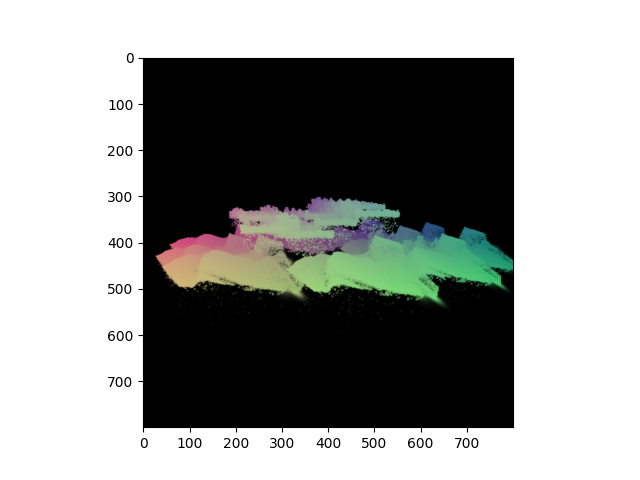

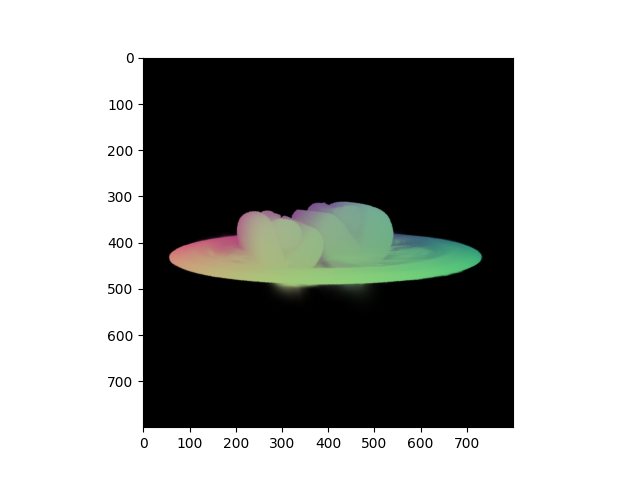

In [636]:
SCALING_FACTOR=1.0 #
# Sample camera
viewpoint_stack = scene_opt.getTrainCameras().copy()
viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
gaussians_opt._scaling.data /=  SCALING_FACTOR





# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]

gaussians_opt._scaling.data *=  SCALING_FACTOR


# Visualize
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()



In [55]:
# sample viewpoint
import random
viewpoint_key = random.choice(list(results.keys()))
viewpoint_key

opacity_original = gaussians_opt._opacity.data.detach().clone()
viewpoint_cam = results[viewpoint_key]["viewpoint_cam"]

render_pkg = render(viewpoint_cam, gaussians_opt , pipe, background)
image_full, depth_full = render_pkg["render"], render_pkg["depth"]
# Iterate over masks
loss_pixel_masks = 0.


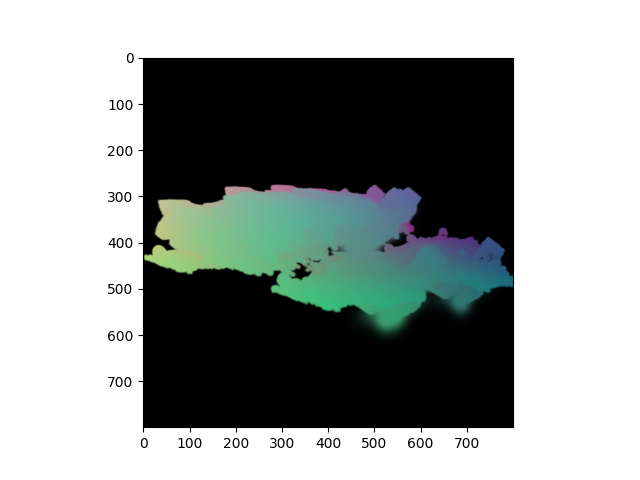

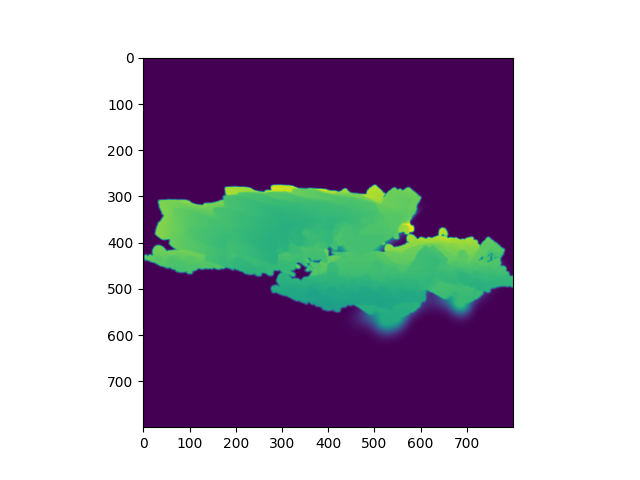

In [56]:
# Visualize
image_rgb = image_full.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()

# Visualize
image_rgb = depth_full.detach().cpu().numpy()
plt.figure()
plt.imshow(image_rgb)
plt.show()

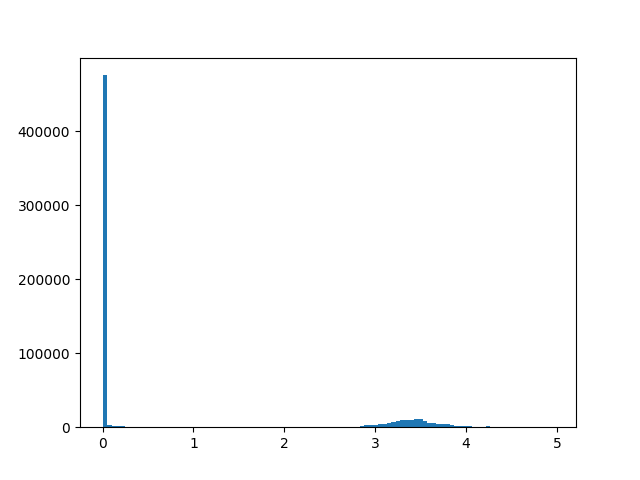

In [57]:
plt.figure()
plt.hist(depth_full.detach().cpu().numpy().flatten(), bins=100)
plt.show()

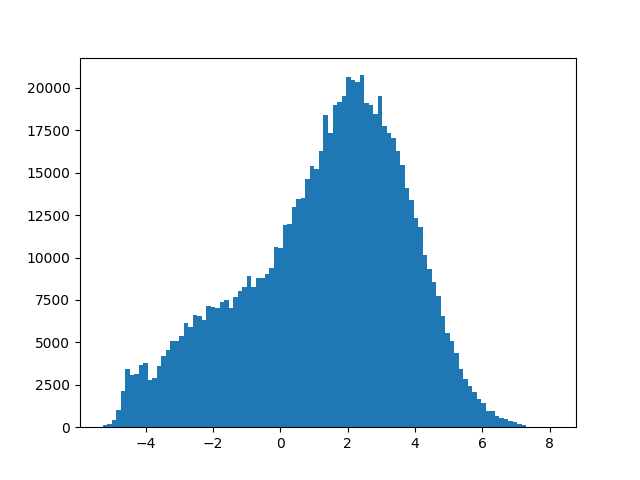

In [58]:
plt.figure()
plt.hist(opacity_original.detach().cpu().numpy().flatten(), bins=100)
plt.show()

15


/tmp/ipykernel_719905/1879807104.py:18: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  visibility_mask = torch.tensor(visibility_mask).to(device)


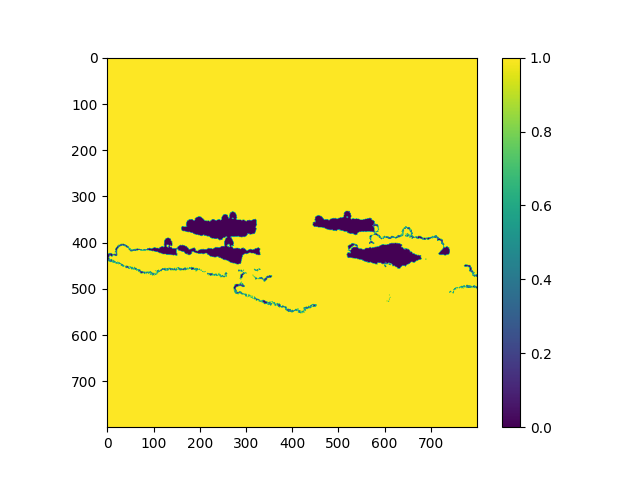

tensor(0.0177, device='cuda:0', grad_fn=<MeanBackward0>)


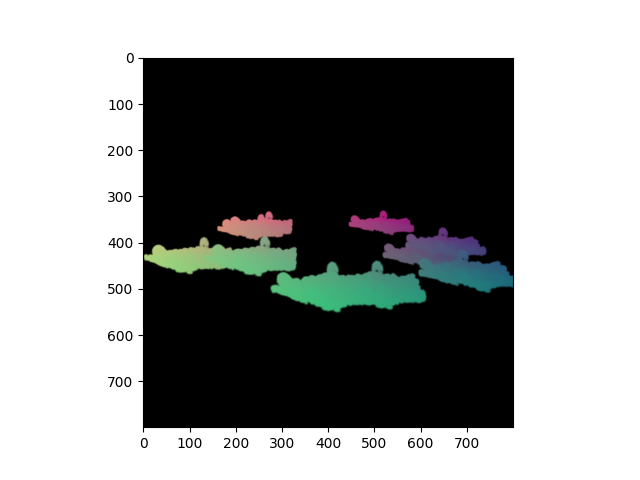

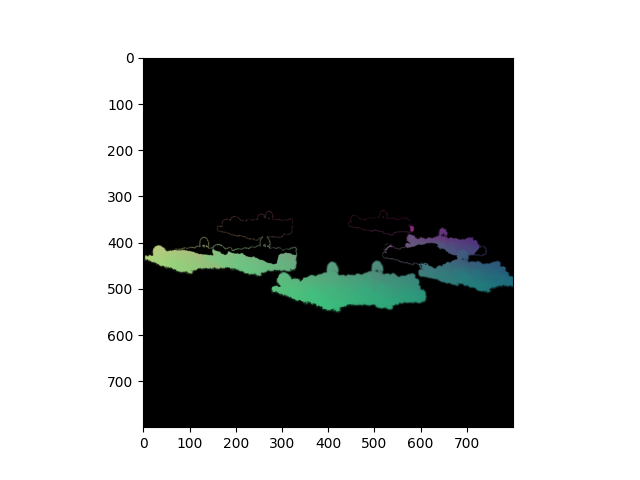

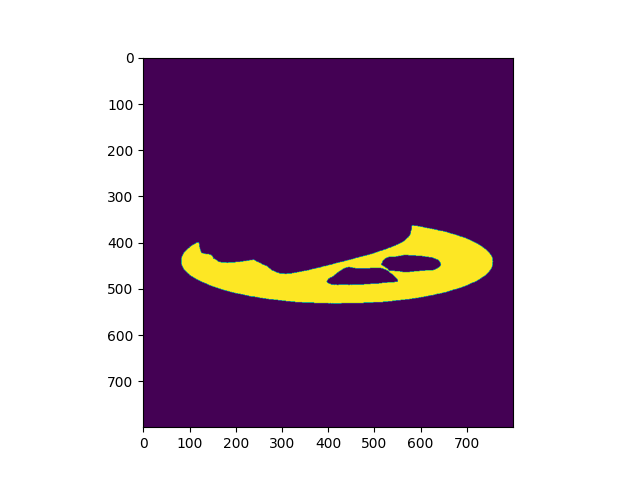

In [68]:
for mask_lbl_target, mask_target in zip(results[viewpoint_key]["masks_clean_lbl_merged"],
                           results[viewpoint_key]["masks_clean_merged"]):
    print(mask_lbl_target)
    

    mask_start_idx, mask_end_idx = dict_name_to_style_idcs[mask_lbl_target]
    
    
    #gaussians_opt._opacity.data = gaussians_opt._opacity.data - 1e8 #- (1e6 * (~image_visibility).to(torch.float32)).unsqueeze(-1)
    gaussians_opt._opacity.data = gaussians_opt._opacity.data - 1e8
    
    gaussians_opt._opacity.data[mask_start_idx:mask_end_idx] = ((opacity_original[mask_start_idx:mask_end_idx] > -5.)*10.).to(torch.float32)
    render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
    image, depth= render_pkg["render"], render_pkg["depth"]

    eps = 1e-3
    visibility_mask = depth  < (depth_full  + 1e-1)   
    visibility_mask = torch.tensor(visibility_mask).to(device)
    image_rgb = visibility_mask.detach().cpu().numpy()
    plt.figure()
    plt.imshow(image_rgb)
    plt.colorbar()
    plt.show()
    
    loss_pixel = l1_loss(image * visibility_mask, image_full * torch.tensor(mask_target).to(device) * visibility_mask) 
    print(loss_pixel)

    #loss_pixel = l1_loss(image, image_full) 
    
    #print(loss_pixel)
    loss_pixel_masks += loss_pixel
    gaussians_opt._opacity.data = opacity_original.clone()


    # Visualize
    image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
    plt.figure()
    plt.imshow(image_rgb)
    
    plt.show()
    
    # Visualize visible part
    image_rgb = (image*visibility_mask).detach().cpu().numpy().transpose(1, 2, 0)
    plt.figure()
    plt.imshow(image_rgb)
    plt.show()

    plt.figure()
    plt.imshow(mask_target)
    plt.show()
    

gaussians_opt._opacity.data = opacity_original.clone()

4


/tmp/ipykernel_740863/3083423937.py:17: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  visibility_mask = torch.tensor(visibility_mask).to(device)


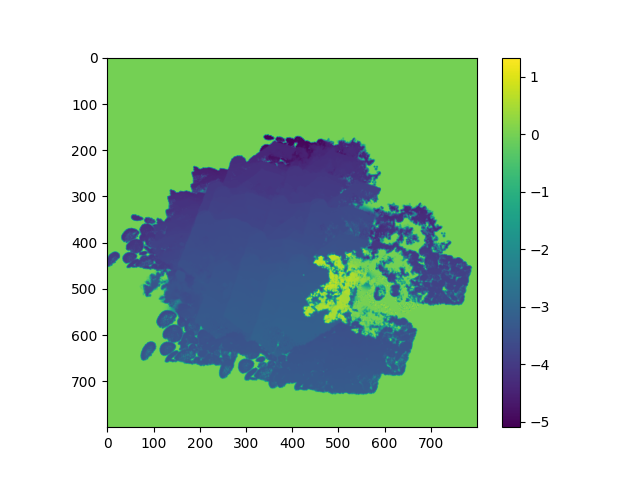

tensor(0.0201, device='cuda:0', grad_fn=<MeanBackward0>)


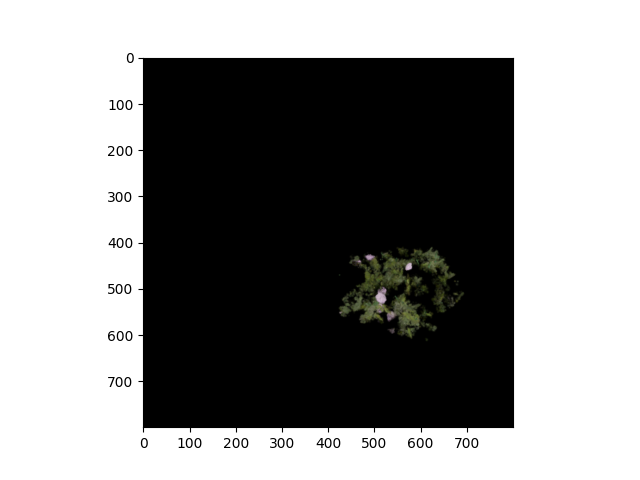

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


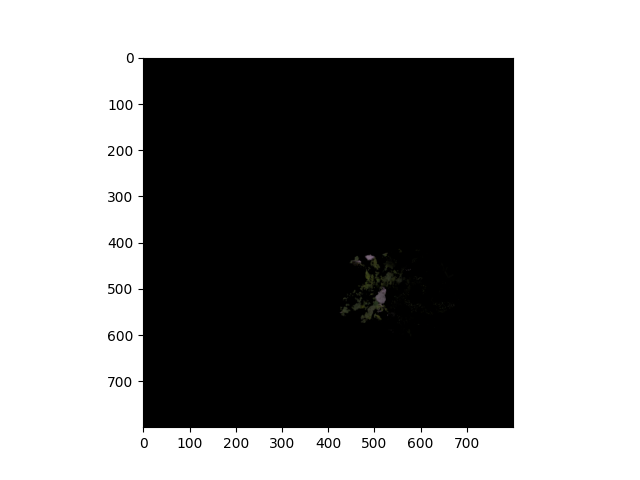

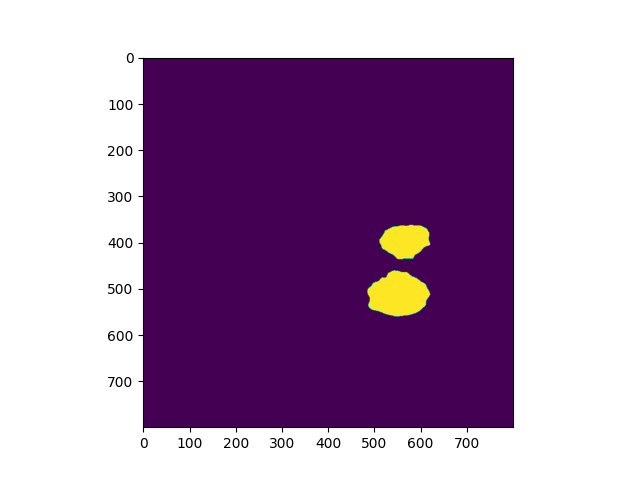

5


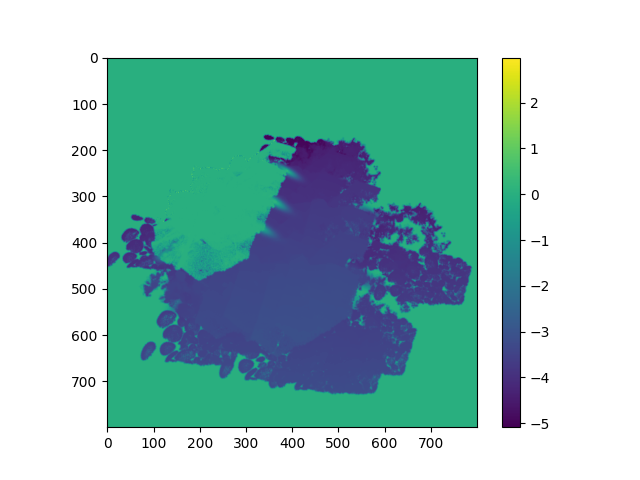

tensor(0.0136, device='cuda:0', grad_fn=<MeanBackward0>)


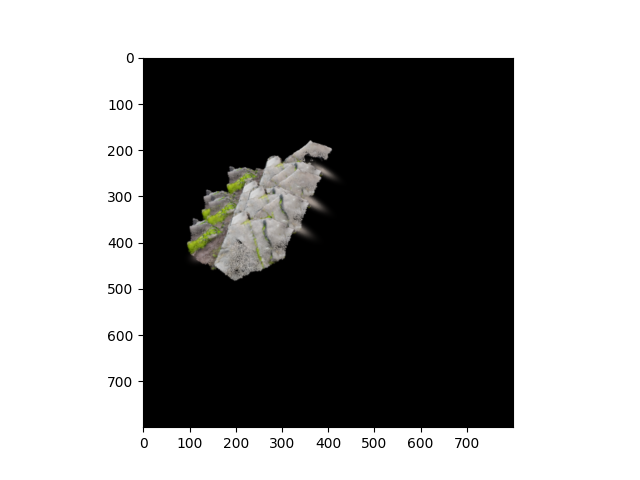

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


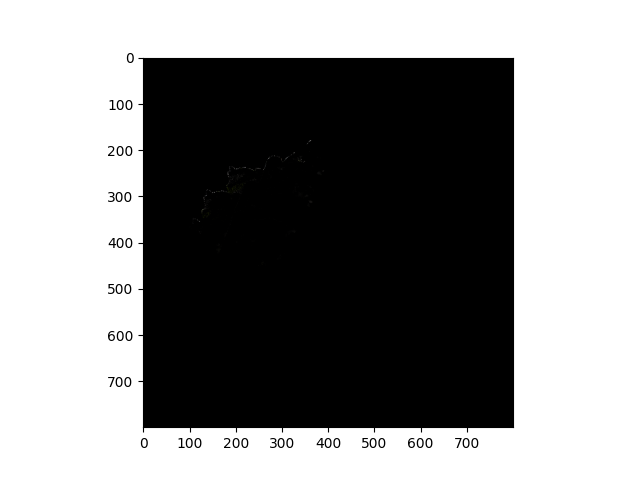

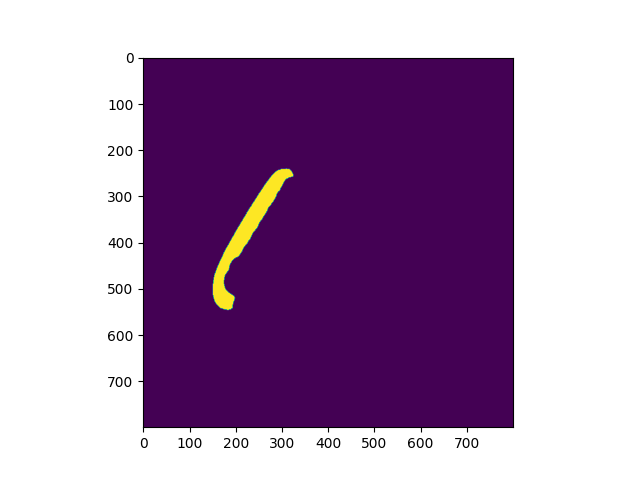

6


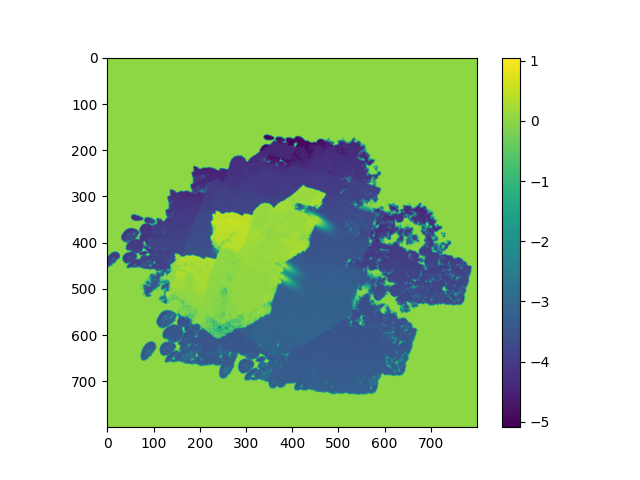

tensor(0.0174, device='cuda:0', grad_fn=<MeanBackward0>)


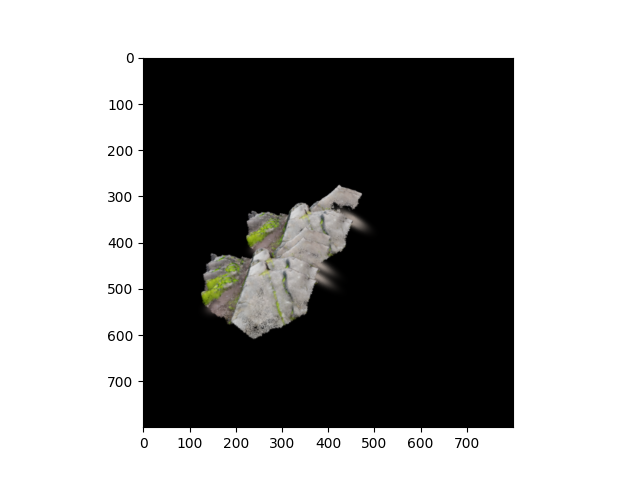

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


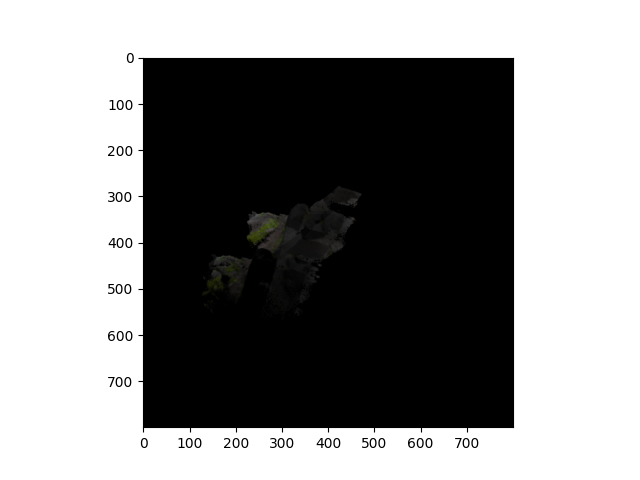

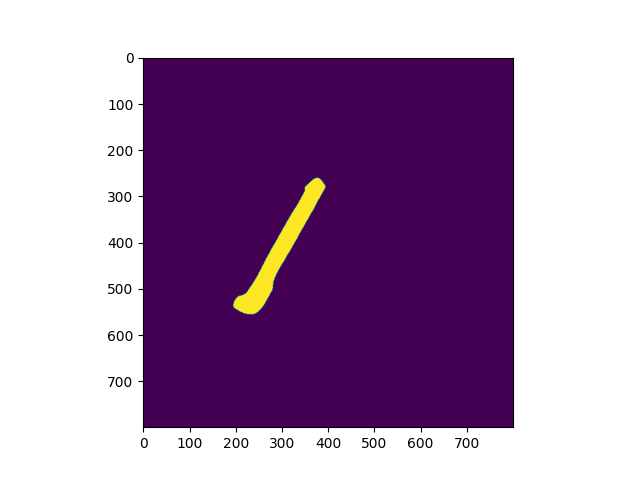

7


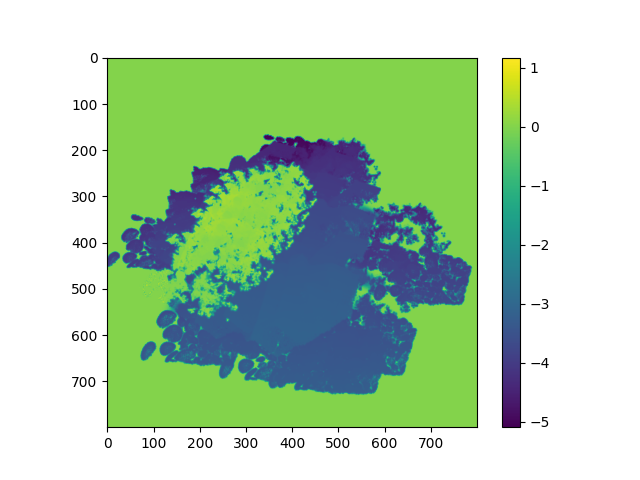

tensor(0.0108, device='cuda:0', grad_fn=<MeanBackward0>)


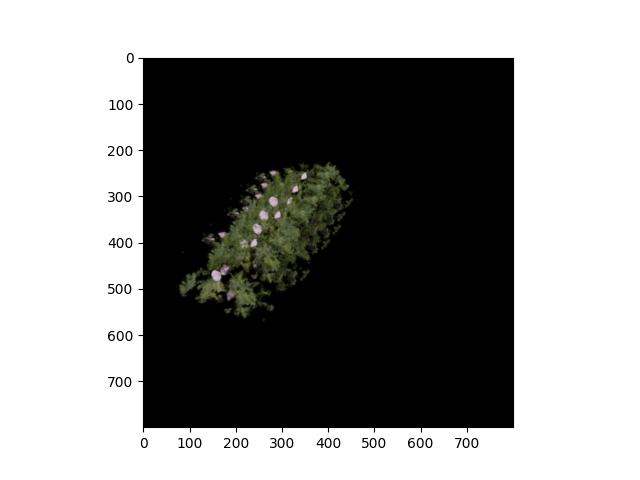

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


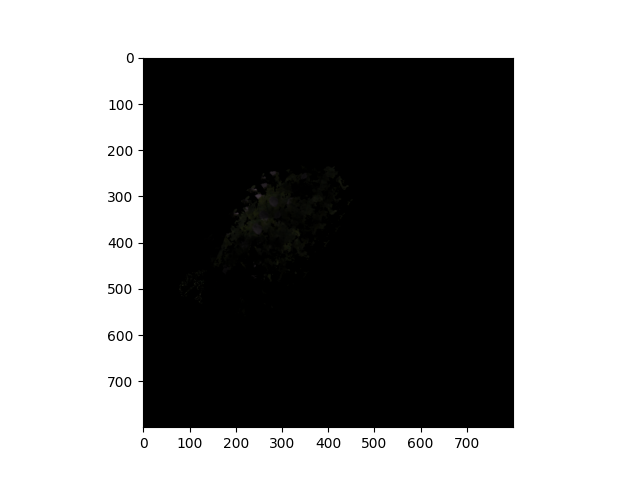

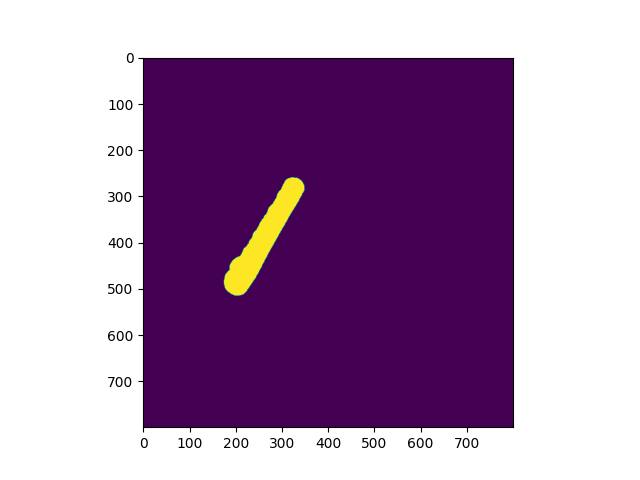

8


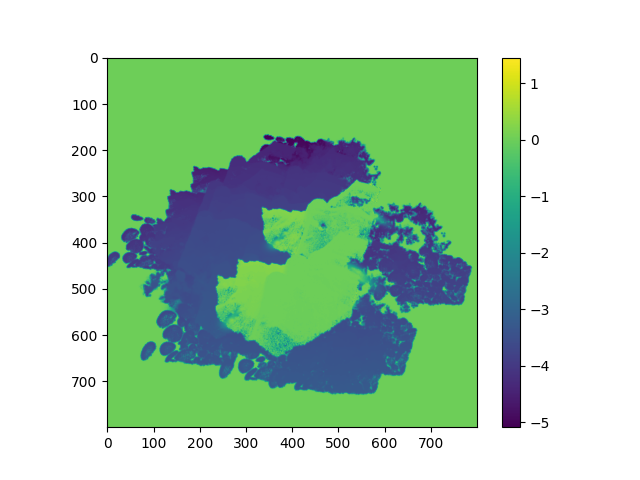

tensor(0.0164, device='cuda:0', grad_fn=<MeanBackward0>)


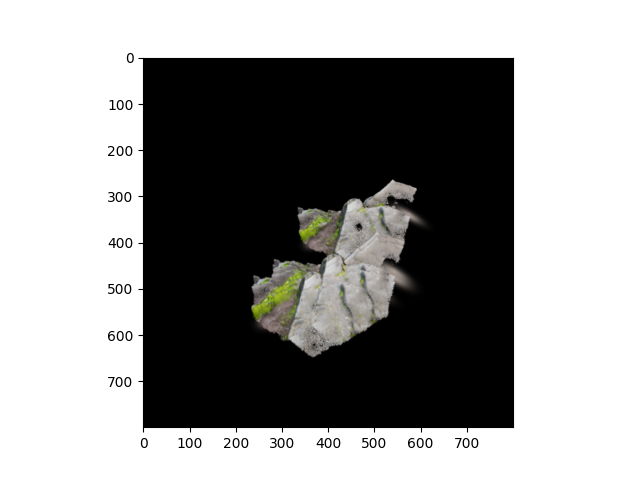

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


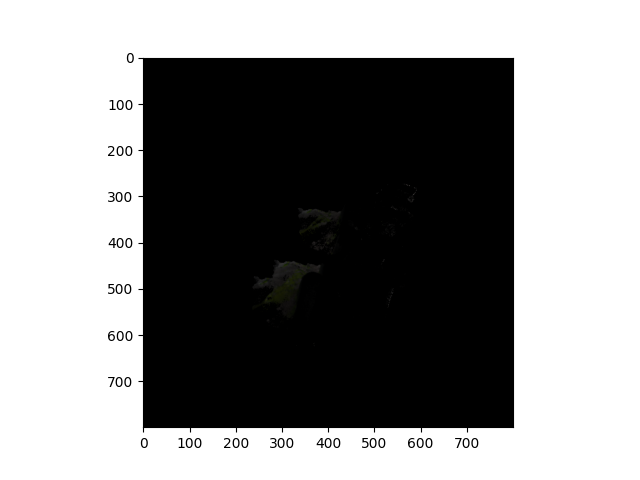

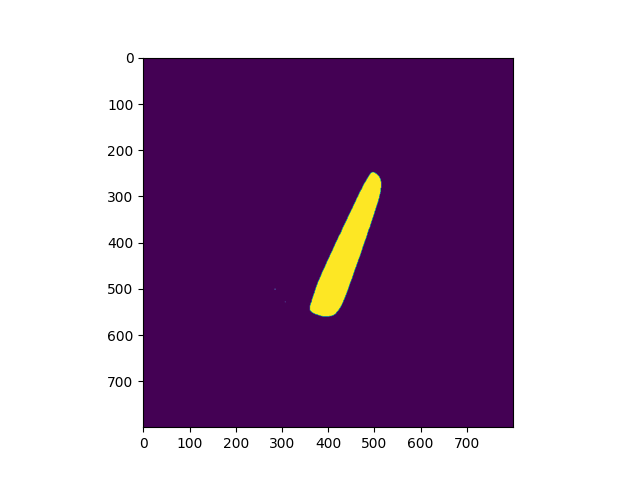

9


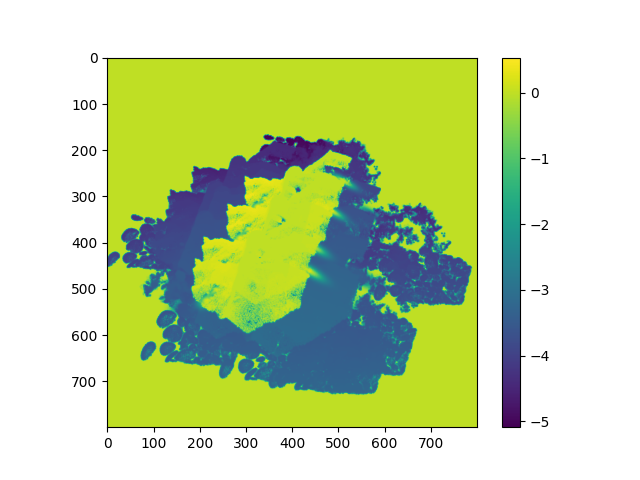

tensor(0.0129, device='cuda:0', grad_fn=<MeanBackward0>)


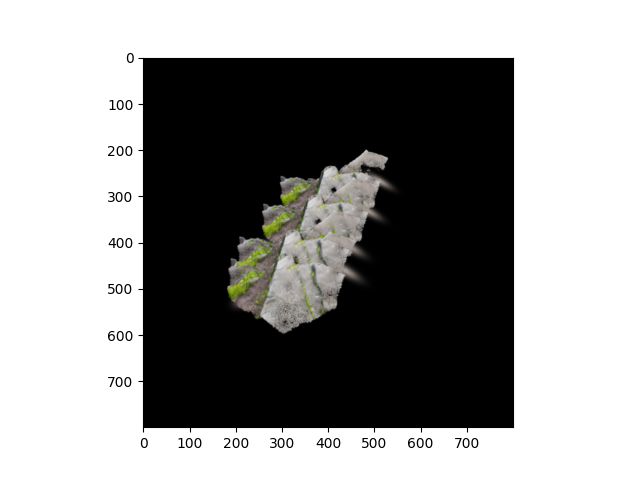

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


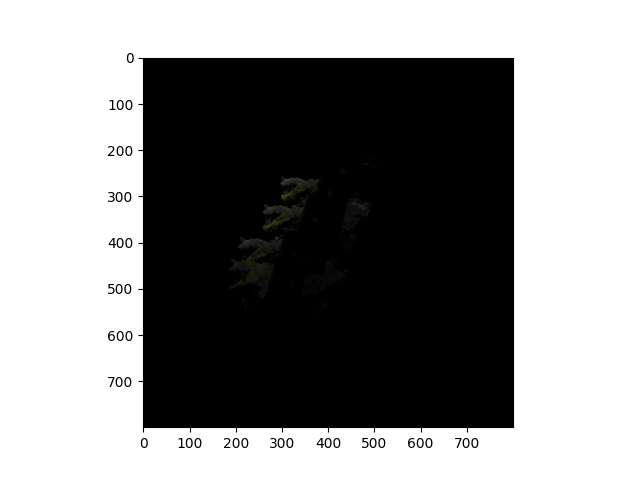

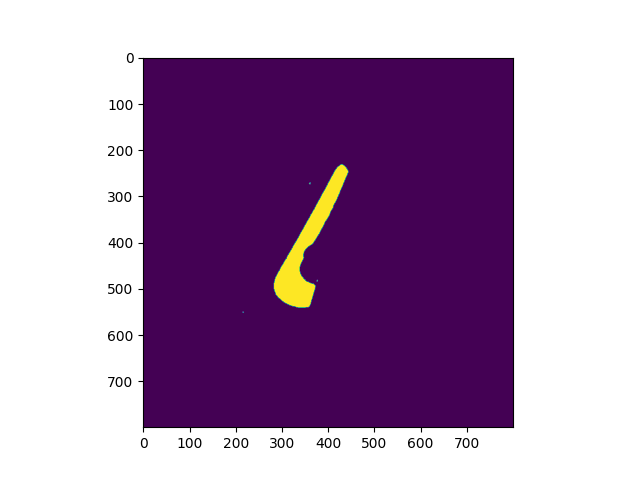

10


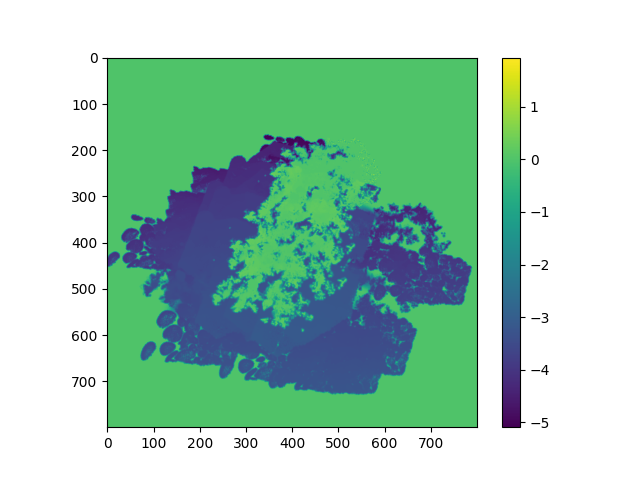

tensor(0.0123, device='cuda:0', grad_fn=<MeanBackward0>)


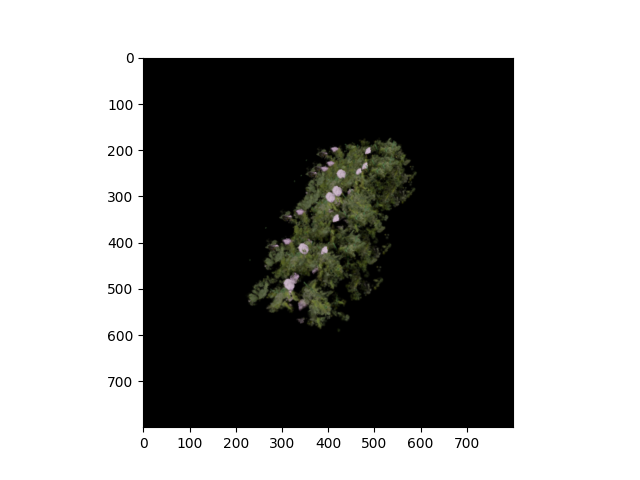

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


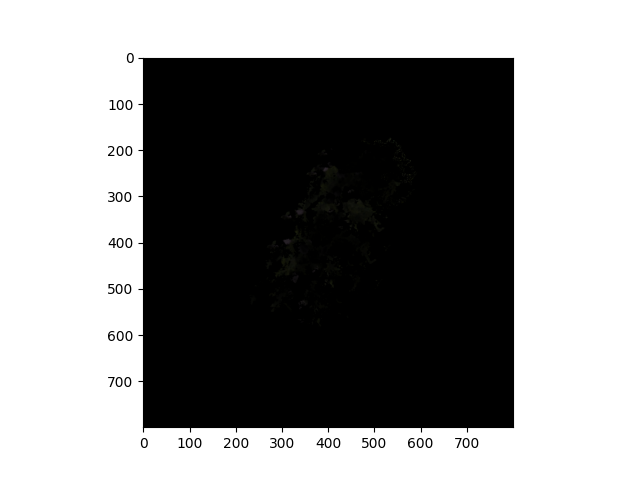

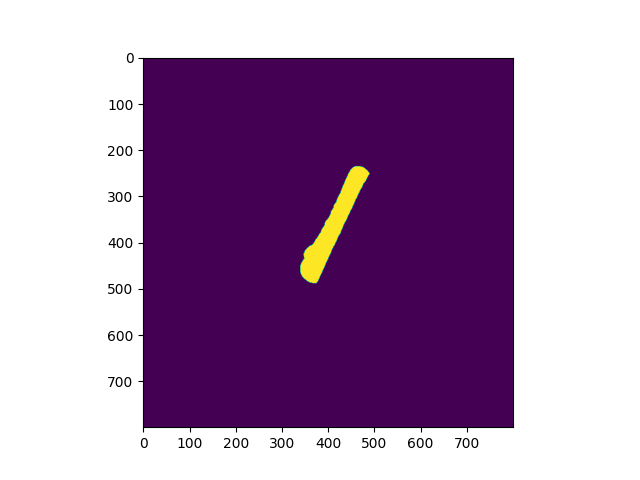

15


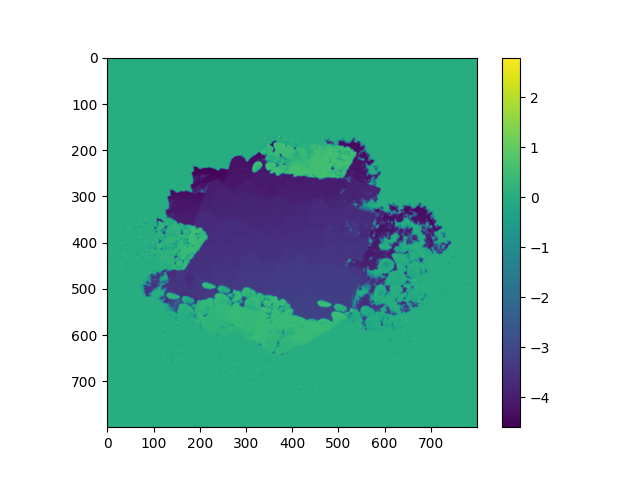

tensor(0.1301, device='cuda:0', grad_fn=<MeanBackward0>)


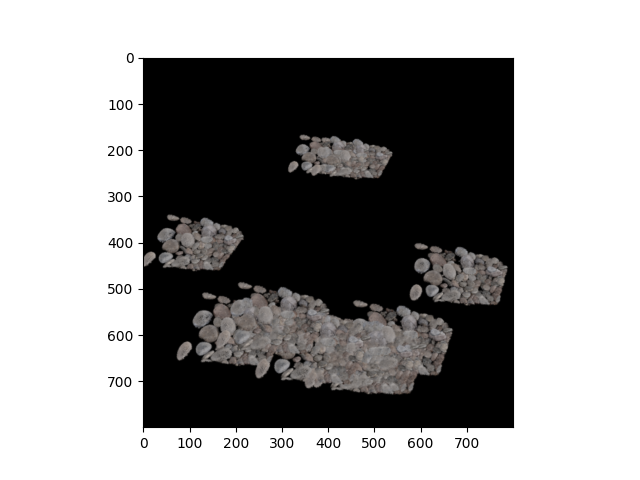

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


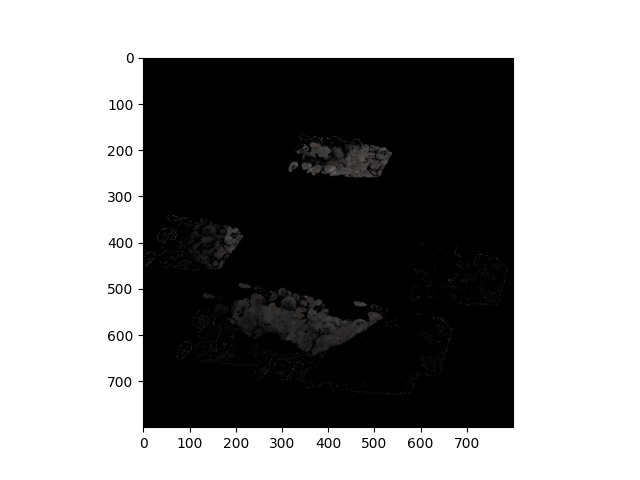

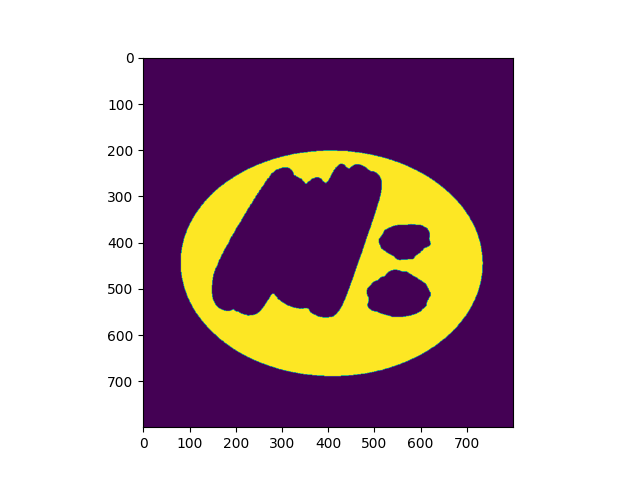

In [225]:
for mask_lbl_target, mask_target in zip(results[viewpoint_key]["masks_clean_lbl_merged"],
                           results[viewpoint_key]["masks_clean_merged"]):
    print(mask_lbl_target)
    

    mask_start_idx, mask_end_idx = dict_name_to_style_idcs[mask_lbl_target]
    
    
    gaussians_opt._opacity.data = gaussians_opt._opacity.data - 1e6 #- (1e6 * (~image_visibility).to(torch.float32)).unsqueeze(-1)
    gaussians_opt._opacity.data = gaussians_opt._opacity.data - 1e6
    
    gaussians_opt._opacity.data[mask_start_idx:mask_end_idx] = opacity_original[mask_start_idx:mask_end_idx]
    render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
    image, depth= render_pkg["render"], render_pkg["depth"]

    eps = 1e-3
    visibility_mask = depth - depth_full   
    visibility_mask = torch.tensor(visibility_mask).to(device)
    image_rgb = visibility_mask.detach().cpu().numpy()
    plt.figure()
    plt.imshow(image_rgb)
    plt.colorbar()
    plt.show()
    
    loss_pixel = l1_loss(image * visibility_mask, image_full * torch.tensor(mask_target).to(device) * visibility_mask) 
    print(loss_pixel)

    #loss_pixel = l1_loss(image, image_full) 
    
    #print(loss_pixel)
    loss_pixel_masks += loss_pixel
    gaussians_opt._opacity.data = opacity_original.clone()


    # Visualize
    image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
    plt.figure()
    plt.imshow(image_rgb)
    
    plt.show()
    
    # Visualize visible part
    image_rgb = (image*visibility_mask).detach().cpu().numpy().transpose(1, 2, 0)
    plt.figure()
    plt.imshow(image_rgb)
    plt.show()

    plt.figure()
    plt.imshow(mask_target)
    plt.show()
    

gaussians_opt._opacity.data = opacity_original.clone()

In [224]:
gaussians_opt._opacity.data = opacity_original.clone()

3
tensor(0.0077, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.1431, device='cuda:0', grad_fn=<MeanBackward0>)


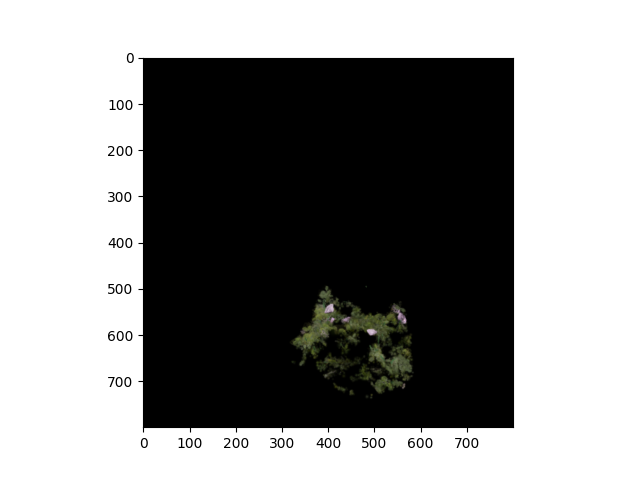

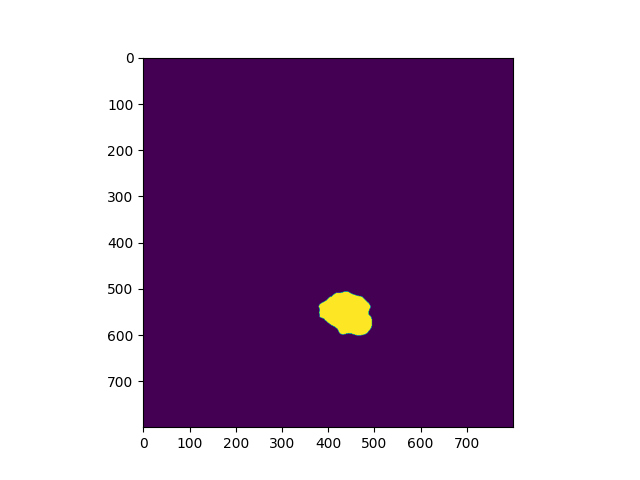

4
tensor(0.0071, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.1439, device='cuda:0', grad_fn=<MeanBackward0>)


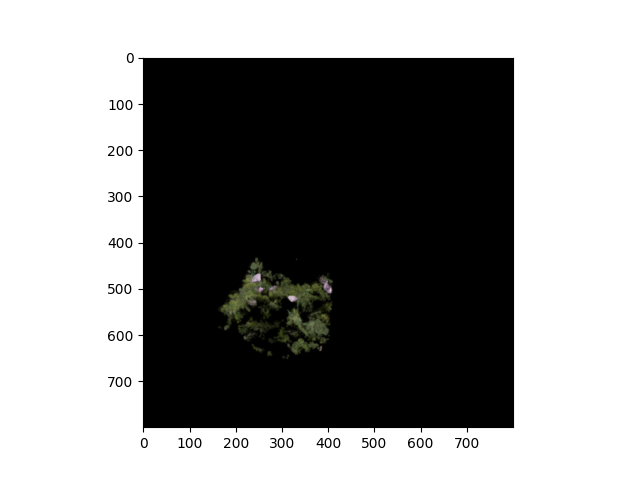

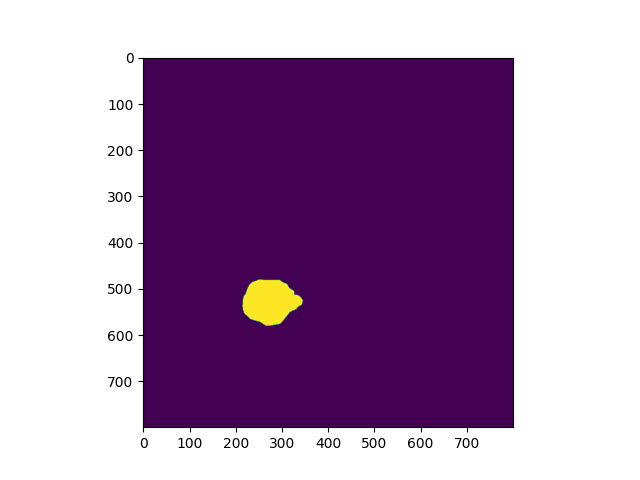

7
tensor(0.0176, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.1363, device='cuda:0', grad_fn=<MeanBackward0>)


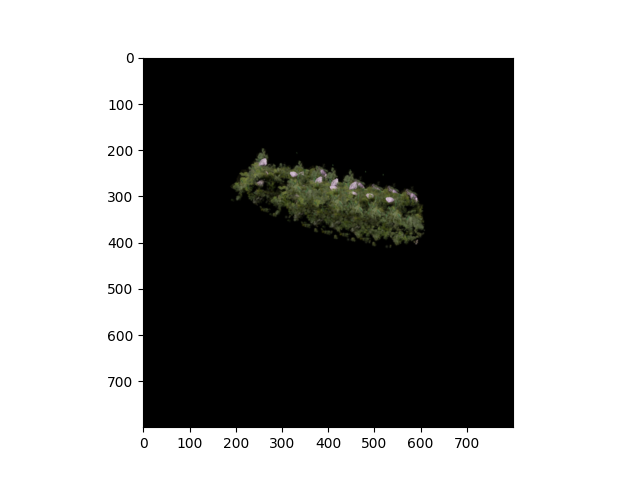

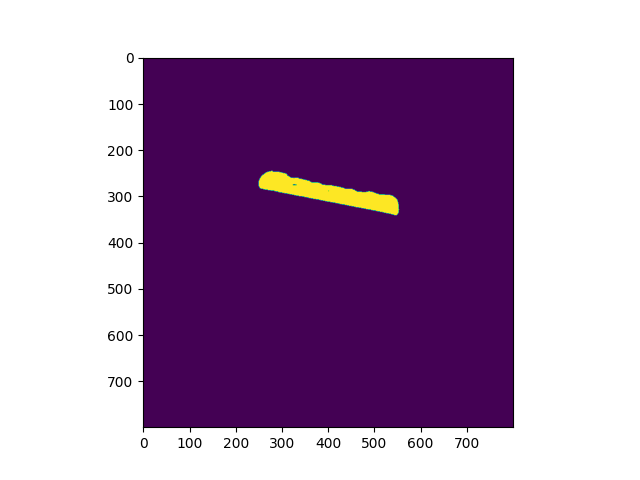

8
tensor(0.0258, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.1136, device='cuda:0', grad_fn=<MeanBackward0>)


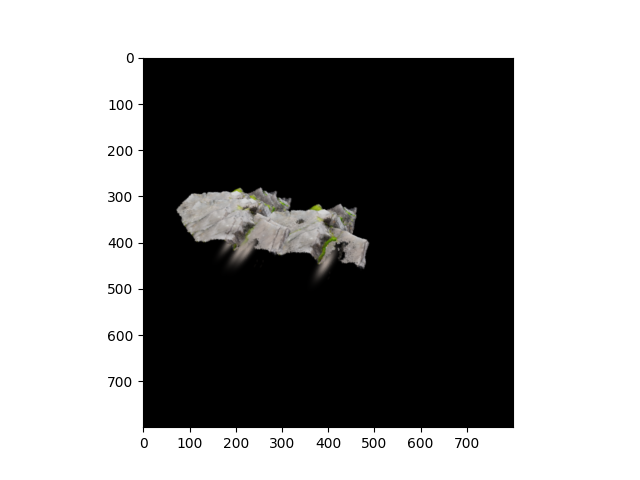

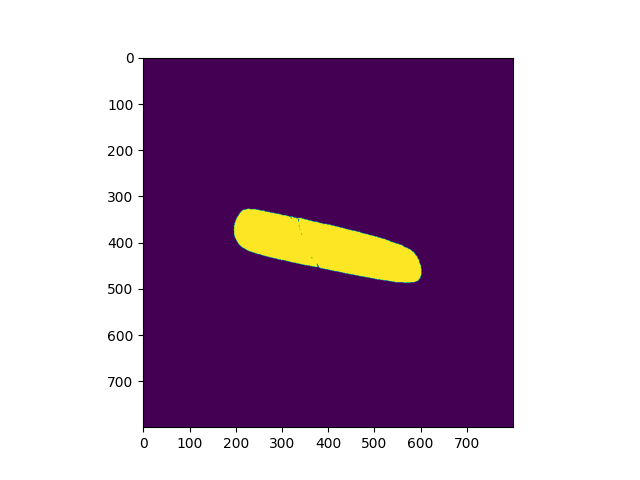

15
tensor(0.0507, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.0906, device='cuda:0', grad_fn=<MeanBackward0>)


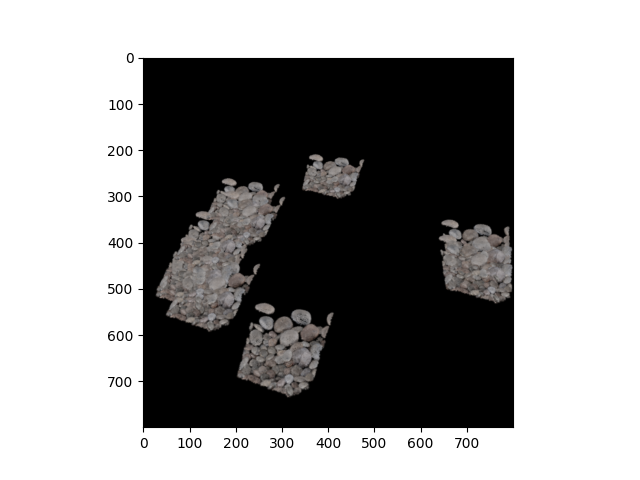

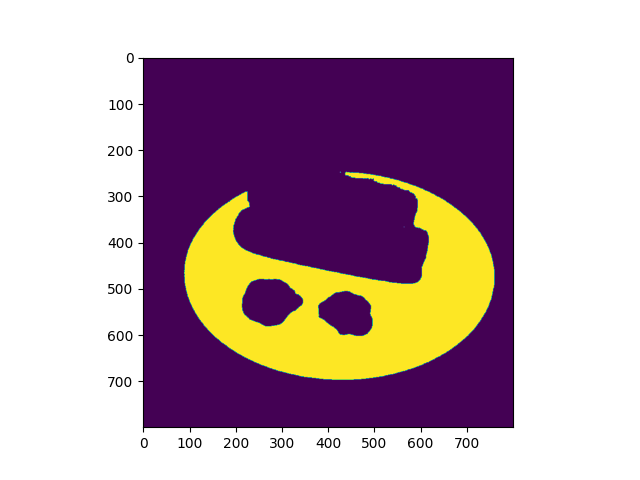

In [182]:
for mask_lbl_target, mask_target in zip(results[viewpoint_key]["masks_clean_lbl_merged"],
                           results[viewpoint_key]["masks_clean_merged"]):
    print(mask_lbl_target)
    

    mask_start_idx, mask_end_idx = dict_name_to_style_idcs[mask_lbl_target]

    gaussians_opt._opacity.data = gaussians_opt._opacity.data - 1e6 #- (1e6 * (~image_visibility).to(torch.float32)).unsqueeze(-1)
    
    gaussians_opt._opacity.data[mask_start_idx:mask_end_idx] = opacity_original[mask_start_idx:mask_end_idx]
    render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
    image, depth= render_pkg["render"], render_pkg["depth"]
    loss_pixel = l1_loss(image, image_cont * torch.tensor(mask_target).to(device)) 
    print(loss_pixel)

    loss_pixel = l1_loss(image, image_cont) 
    
    print(loss_pixel)
    loss_pixel_masks += loss_pixel
    gaussians_opt._opacity.data = opacity_original.clone()


    # Visualize
    image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
    plt.figure()
    plt.imshow(image_rgb)
    plt.show()

    plt.figure()
    plt.imshow(mask_target)
    plt.show()

gaussians_opt._opacity.data = opacity_original.clone()

In [61]:

for mask_name in dict_name_to_style_idcs.keys():
    print(mask_name)
    mask_start_idx, mask_end_idx = dict_name_to_style_idcs[mask_name]
    print(mask_start_idx, mask_end_idx)

3
0 21029
4
21029 63087
5
63087 167352
6
167352 271617
8
271617 375882
9
375882 480147
7
480147 585292
10
585292 690437
15
690437 815967


In [ ]:

for mask_name in dict_name_to_style_idcs.keys():
    print(mask_name)
    #gaussians_opt._opacity.data = opacity_original.clone()
    
    mask_start_idx, mask_end_idx = dict_name_to_style_idcs[mask_name]
    print(mask_start_idx, mask_end_idx)
    gaussians_opt._opacity.data = gaussians_opt._opacity.data - 1e6
    gaussians_opt._opacity.data[mask_start_idx:mask_end_idx] = opacity_original[mask_start_idx:mask_end_idx]
    render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
    mask_current = obj_to_view_to_mask[mask_name][8][0]
    image, depth= render_pkg["render"], render_pkg["depth"]
    loss_pixel = l1_loss(image, image_cont * torch.tensor(mask_current).to(device)) 
    print(loss_pixel)

    loss_pixel = l1_loss(image, image_cont) 
    print(loss_pixel)

        
    # Visualize
    image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
    plt.figure()
    plt.imshow(image_rgb)
    plt.show()

    plt.figure()
    plt.imshow(mask_current)
    plt.show()
    
gaussians_opt._opacity.data = opacity_original.clone()

In [62]:

gaussians_opt.training_setup(opt)

In [63]:
gaussians_opt._xyz.data.shape

torch.Size([815967, 3])

In [159]:
import sys
sys.path.append("../")

from scene import GaussianModel
MODEL_DIR = './dummy_scene/'
MODEL_DIR_NEW = './fit_hotdog_with_pebbles_bark_fragment_rocks4_init/'
os.makedirs(MODEL_DIR_NEW, exist_ok = True)

! cp -r {MODEL_DIR}* {MODEL_DIR_NEW}
# ls MODEL_DIR


iteration=1
torch.save((gaussians_opt.capture(), iteration), MODEL_DIR_NEW + "/chkpnt" + str(iteration) + ".pth")
gaussians_opt.save_ply(os.path.join(MODEL_DIR_NEW, "point_cloud/iteration_1/", "point_cloud.ply"))



In [192]:
gaussians_opt._scaling.data *=  1.1

In [637]:
def calculate_ema(values, alpha=0.01):
    ema = [values[0]]  # Initial value is the same as the first value in the list

    for i in range(1, len(values)):
        ema.append(alpha * values[i] + (1 - alpha) * ema[-1])

    return ema


def l1_loss(network_output, gt):
    return torch.abs((network_output - gt)).mean()


def tv_loss(img):
    return 0.5 * (torch.abs(img[..., 1:, :] - img[..., :-1, :]).mean() +
                  torch.abs(img[..., :, 1:] - img[..., :, :-1]).mean())



In [638]:

def get_descriptors(X, X_nns_indices):
    """
    Returns a matrix of distances between all points specified in the X_nns_indices matrix.
    :param X: tensor or shape [N,d]
    :param X_nns_indices: tensor of shape [N,k]
    :return 
        distances_nns : tensor of shape [N, k,k] with pairwise distances between all of the 
            k NNs for every sample in X.
    """

    #print("X.shape:", X.shape)
    #print("X_nns_indices:", X_nns_indices)
    X_nns = X[X_nns_indices]
    # All pairs can be too much
    # distances_nns = torch.norm(X_nns.unsqueeze(1) - X_nns.unsqueeze(2), dim=-1)
    # Just take all distances to the nearest neighbors
    distances_nns = torch.norm(X_nns[:,1:] - X_nns[:,0].unsqueeze(1), dim=-1)
    return distances_nns
    
def get_style_patch_descriptors_loss(clusters_to_opt_list, nns_indices, target_descriptor_cluster):
    """
    For every cluster of points in the clusters_to_opt_list we compute its descriptor of spatial 
    positions between all pairs of points within this cluster. Afterwards we compare this descriptor
    with the target descriptor.
    """
    loss_local_descriptor_list = []
    loss = 0.
    if type(nns_indices) is not list:
        for cluster_points in clusters_to_opt_list:
            descriptor_points = get_descriptors(X=cluster_points, X_nns_indices=nns_indices)
            loss_local_descriptor = torch.mean(torch.square(descriptor_points - target_descriptor_cluster))
            loss += loss_local_descriptor 
            loss_local_descriptor_list.append(loss_local_descriptor)
    else:
        for cluster_points, cluster_points_nns_indices, cluster_target_descriptor in \
            zip(clusters_to_opt_list, nns_indices, target_descriptor_cluster):
                #print("cluster_points_nns_indices.shape:", cluster_points_nns_indices.shape)
                descriptor_points = get_descriptors(X=cluster_points, X_nns_indices=cluster_points_nns_indices)
                loss_local_descriptor = torch.mean(torch.square(descriptor_points - cluster_target_descriptor))
                loss += loss_local_descriptor 
                loss_local_descriptor_list.append(loss_local_descriptor)
                    

    return loss / len(clusters_to_opt_list)



In [639]:

# now find initial descriptors 

num_nns = 200
kth_nn = 20

num_nns = 50
kth_nn = 2
num_nns_fine = 10 # was 100
kth_nn_fine = 1


N_start, N_end = 0, 0
target_descriptor_clusters = []
style_clusters_indcs = []
style_clusters_nns_indcs = []
style_clusters_descriptors = []
for style_cluster in style_clusters:
    N_start = N_end 
    N_end = N_start + len(style_cluster["_xyz"])
    style_clusters_indcs.append((N_start, N_end))
    distances = torch.cdist(gaussians_opt._xyz.data[N_start:N_end], 
                            gaussians_opt._xyz.data[N_start:N_end])
    _, nns_indices = torch.topk(distances, k=num_nns, largest=False, dim=-1)
    nns_indices = nns_indices[:, ::kth_nn]
    style_clusters_nns_indcs.append(nns_indices)
    target_descriptor_cluster = get_descriptors(X=gaussians_opt._xyz.data[N_start:N_end], 
                                                X_nns_indices=nns_indices)
    
    target_descriptor_cluster = target_descriptor_cluster.clone().detach()
    style_clusters_descriptors.append(target_descriptor_cluster)

    #_, nns_indices_fine = torch.topk(distances, k=num_nns_fine, largest=False, dim=-1)
    #nns_indices_fine = nns_indices[:, ::kth_nn]
    # target_descriptor_cluster_fine = get_descriptors(X=gaussians_opt._xyz.data[:N], 
    #                                             X_nns_indices=nns_indices_fine)
    # target_descriptor_cluster_fine = target_descriptor_cluster_fine.clone().detach()
    #target_descriptor_cluster.shape, target_descriptor_cluster_fine.shape

In [640]:
[x.shape for x in style_clusters_descriptors]

[torch.Size([22987, 24]),
 torch.Size([22987, 24]),
 torch.Size([22987, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([13571, 24]),
 torch.Size([22987, 24]),
 torch.Size([22987, 24]),
 torch.Size([22987, 24]),
 torch.Size([22987, 24]),
 torch.Size([22987, 24]),
 torch.Size([22987, 24]),
 torch.Size([22987, 24]),
 torch.Size([22987, 24]),
 torch.Size([22987, 24]),
 torch.Size([22987, 24]),
 torch.Size([22735, 24]),
 torch.Size([22735, 24]),
 torch.Size([22735, 24]),
 torch.Size([22735, 24]),
 torch.Size([22735, 24]),
 torch.Size(

In [527]:
target_descriptor_cluster.shape

torch.Size([12553, 24])

In [431]:


# get_style_patch_descriptors_loss(clusters_to_opt_list=[gaussians_opt._xyz[:N]],
#                                  nns_indices=nns_indices,
#                                  target_descriptor_cluster=target_descriptor_cluster)



In [641]:

get_style_patch_descriptors_loss(
    clusters_to_opt_list=[gaussians_opt._xyz[N_start:N_end] for (N_start, N_end) in style_clusters_indcs],
    nns_indices=style_clusters_nns_indcs,
    target_descriptor_cluster=style_clusters_descriptors)


tensor(0., device='cuda:0', grad_fn=<DivBackward0>)

In [642]:
losses_full=[]
losses_pixel = []
losses_reg = []
losses_tv = []
losses_loc_descr = []
losses_loc_descr_fine = []


gaussians_opt.training_setup(opt)
# for param_group in gaussians_opt.optimizer.param_groups:
#         param_group['lr'] = 1e-4


gaussians_opt._xyz.requires_grad = True
gaussians_opt._features_dc.requires_grad = True
gaussians_opt._features_rest.requires_grad = False
gaussians_opt._scaling.requires_grad = False
gaussians_opt._rotation.requires_grad = False
gaussians_opt._opacity.requires_grad = False
gaussians_opt.max_radii2D.requires_grad = False


In [34]:
# optimizer = torch.optim.Adam([gaussians_opt._xyz, colors], lr=1e0)

In [643]:

# Random sampling viewpoint



# def loss_to_depth_target(d, d_trg):
#     return torch.mean(torch.square(d - d_trg) * (d_trg>0.5))

def loss_to_depth_target(d, d_trg):
    return torch.mean(torch.square(d - d_trg))


from torchvision.transforms import v2
blurrer = v2.GaussianBlur(kernel_size=(31, 31), sigma=(30., 30.))


def loss_to_depth_target(d, d_trg, make_BG_large=False, blur_depth=False, blr_sgm=1.):
    d_ = d
    d_trg_ = d_trg
    if make_BG_large:
        d_trg_ = d_trg_ + (d_trg_<1e-2) * 1e2
    if blur_depth:
        d_ = gaussian_filter_2d(d_, sigma=blr_sgm)
        d_trg_ = gaussian_filter_2d(d_trg_, sigma=blr_sgm)
    return torch.mean(torch.square(d_ - d_trg_))# * (d_trg>0.01))

def renorm_cluster(cluster):
    """
    Provided a cluster of coordinates center it and normalize
    """
    return (cluster - torch.mean(cluster, dim=-1, keepdim=True)) / torch.std(cluster, dim=-1, keepdim=True)

In [188]:

# for step in tqdm(range(5001)):
#     gaussians_opt.optimizer.zero_grad()
#     if True:
#         # Pick a random Camera
#         if not viewpoint_stack:
#            viewpoint_stack = scene_opt.getTrainCameras().copy()
#         viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
#     # Optimization gaussians
#     render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
#     image, depth= render_pkg["render"], render_pkg["depth"]
#     # Content gaussians
#     render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
#     image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


#     depth_target = depth_cont.clone().detach().to(device=device)
#     loss_descriptor_local = get_style_patch_descriptors_loss(
#         clusters_to_opt_list=[gaussians_opt._xyz[i*N:(i+1)*N] for i in range(C)],
#         nns_indices=nns_indices,
#         target_descriptor_cluster=target_descriptor_cluster)

#     loss_descriptor_local_fine = get_style_patch_descriptors_loss(
#         clusters_to_opt_list=[gaussians_opt._xyz[i*N:(i+1)*N] for i in range(C)],
#         nns_indices=nns_indices_fine,
#         target_descriptor_cluster=target_descriptor_cluster_fine)

#     #loss_pixel = l1_loss(image, image_cont)
#     #image_cont_sobel_filters_mask = (image_cont_sobel_filters > 0.2).float()
#     loss_pixel = l1_loss(image, image_cont) 
    
#     l_tv = tv_loss(image)
#     l_reg = torch.mean(torch.square(gaussians_opt._xyz.unsqueeze(1) - gaussians_opt._features_dc))
    
#     # loss = loss_pixel * 5e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 4e6 # was 1e4
#     loss = loss_pixel * 5e1  + l_tv * 0e-5 + l_reg * 1e1 + loss_descriptor_local * 4e3 + loss_descriptor_local_fine * 4e6 # was 1e4
#     # loss = loss_pixel * 5e1  + l_tv * 0e-5 + l_reg * 1e1 + loss_descriptor_local * 4e0 # was 1e4
#     loss.backward()

#     gaussians_opt.optimizer.step()
#     losses_full.append(float(loss.detach().cpu().numpy()))
#     losses_pixel.append(float(loss_pixel.detach().cpu().numpy()))
#     losses_reg.append(float(l_reg.detach().cpu().numpy()))
#     losses_tv.append(float(l_tv.detach().cpu().numpy()))
#     losses_loc_descr.append(float(loss_descriptor_local.detach().cpu().numpy()))
#     losses_loc_descr_fine.append(float(loss_descriptor_local_fine.detach().cpu().numpy()))



    
#     if step % 100 == 0:
#         print(f"l_reg:{l_reg:.7f}",
#               f"loss_descriptor_local:{loss_descriptor_local:.7f}, loss_descriptor_local_fine:{loss_descriptor_local_fine:.7f},",
#               f"l_tv:{l_tv:.7f}, loss_pixel:{loss_pixel:.7f}, loss:{loss:.7f}")



/tmp/ipykernel_2908427/2514892362.py:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for step in tqdm(range(5001)):


  0%|          | 0/5001 [00:00<?, ?it/s]

l_reg:0.0039320 loss_descriptor_local:0.0000008, loss_descriptor_local_fine:0.0000004, l_tv:0.0163392, loss_pixel:0.0504536, loss:4.1747160
l_reg:0.0042481 loss_descriptor_local:0.0000007, loss_descriptor_local_fine:0.0000003, l_tv:0.0170019, loss_pixel:0.0585228, loss:4.2851648


KeyboardInterrupt: 

In [202]:
obj_to_view_to_mask

{'plate': {8: [], 7: [], 2: [], 5: [], 6: []},
 'ketchup': {8: [], 7: [], 2: [], 5: [], 6: []},
 'mustard': {8: [], 7: [], 2: [], 5: [], 6: []},
 'central_hotdog_sausage': {8: [], 7: [], 2: [], 5: [], 6: []},
 'central_hotdog_bun_central': {8: [], 7: [], 2: [], 5: [], 6: []},
 'central_hotdog_bun_outter': {8: [], 7: [], 2: [], 5: [], 6: []},
 'outter_hotdog_sausage': {8: [], 7: [], 2: [], 5: [], 6: []},
 'outter_hotdog_bun_central': {8: [], 7: [], 2: [], 5: [], 6: []},
 'outter_hotdog_bun_outter': {8: [], 7: [], 2: [], 5: [], 6: []}}

In [201]:

viewpoint_stack = content_scene.getTrainCameras().copy()
opacity_original = gaussians_opt._opacity.data.detach().clone()
viewpoint_cam = viewpoint_stack[8]
for mask_name in dict_name_to_style_idcs.keys():
    print(mask_name)
    #gaussians_opt._opacity.data = opacity_original.clone()
    
    mask_start_idx, mask_end_idx = dict_name_to_style_idcs[mask_name]
    print(mask_start_idx, mask_end_idx)
    gaussians_opt._opacity.data = gaussians_opt._opacity.data - 1e6
    gaussians_opt._opacity.data[mask_start_idx:mask_end_idx] = opacity_original[mask_start_idx:mask_end_idx]
    render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
    mask_current = obj_to_view_to_mask[mask_name][8][0]
    image, depth= render_pkg["render"], render_pkg["depth"]
    loss_pixel = l1_loss(image, image_cont * torch.tensor(mask_current).to(device)) 
    print(loss_pixel)

    loss_pixel = l1_loss(image, image_cont) 
    print(loss_pixel)

        
    # Visualize
    image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
    plt.figure()
    plt.imshow(image_rgb)
    plt.show()

    plt.figure()
    plt.imshow(mask_current)
    plt.show()
    
gaussians_opt._opacity.data = opacity_original.clone()

4
0 55596


KeyError: 4

In [621]:
viewpoint_stack = content_scene.getTrainCameras().copy()
opacity_original = gaussians_opt._opacity.data.detach().clone()
viewpoint_cam = viewpoint_stack[8]
for mask_name in dict_name_to_style_idcs.keys():
    print(mask_name)
    #gaussians_opt._opacity.data = opacity_original.clone()
    
    mask_start_idx, mask_end_idx = dict_name_to_style_idcs[mask_name]
    print(mask_start_idx, mask_end_idx)
    gaussians_opt._opacity.data = gaussians_opt._opacity.data - 1e6
    gaussians_opt._opacity.data[mask_start_idx:mask_end_idx] = opacity_original[mask_start_idx:mask_end_idx]
    render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
    mask_current = obj_to_view_to_mask[mask_name][8][0]
    image, depth= render_pkg["render"], render_pkg["depth"]
    loss_pixel = l1_loss(image, image_cont * torch.tensor(mask_current).to(device)) 
    print(loss_pixel)

    loss_pixel = l1_loss(image, image_cont) 
    print(loss_pixel)

gaussians_opt._opacity.data = opacity_original.clone()

plate
0 363300
tensor(0.1194, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.1843, device='cuda:0', grad_fn=<MeanBackward0>)
ketchup
363300 380000
tensor(0.0129, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.1716, device='cuda:0', grad_fn=<MeanBackward0>)
mustard
380000 396700
tensor(0.0121, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.1668, device='cuda:0', grad_fn=<MeanBackward0>)
central_hotdog_sausage
396700 421750
tensor(0.0277, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.1384, device='cuda:0', grad_fn=<MeanBackward0>)
central_hotdog_bun_central
421750 462490
tensor(0.0265, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.1487, device='cuda:0', grad_fn=<MeanBackward0>)
central_hotdog_bun_outter
462490 503230
tensor(0.0302, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.1528, device='cuda:0', grad_fn=<MeanBackward0>)
outter_hotdog_sausage
503230 528280
tensor(0.0238, device='cuda:0', grad_fn=<MeanBackward0>)
tensor(0.1436, device='cuda:0', grad_fn=<MeanB

In [669]:
opacity_original = gaussians_opt._opacity.data.detach().clone()
for step in tqdm(range(5001)):
    gaussians_opt.optimizer.zero_grad()
    if True:
        # Pick a random Camera
        if not viewpoint_stack:
           viewpoint_stack = scene_opt.getTrainCameras().copy()
        viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
    # Optimization gaussians
    render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
    image, depth= render_pkg["render"], render_pkg["depth"]
    # Content gaussians
    render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
    image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


    depth_target = depth_cont.clone().detach().to(device=device)
    loss_descriptor_local = \
        get_style_patch_descriptors_loss(
            clusters_to_opt_list=[gaussians_opt._xyz[N_start:N_end] for (N_start, N_end) in style_clusters_indcs],
            nns_indices=style_clusters_nns_indcs,
            target_descriptor_cluster=style_clusters_descriptors)
    # get_style_patch_descriptors_loss(
    #     clusters_to_opt_list=[gaussians_opt._xyz[i*N:(i+1)*N] for i in range(C)],
    #     nns_indices=nns_indices,
    #     target_descriptor_cluster=target_descriptor_cluster)

    
    #loss_pixel = l1_loss(image, image_cont)
    #image_cont_sobel_filters_mask = (image_cont_sobel_filters > 0.2).float()
    loss_pixel = l1_loss(image, image_cont) 
    
    l_tv = tv_loss(image)
    l_reg = torch.mean(torch.square(gaussians_opt._xyz.unsqueeze(1) - gaussians_opt._features_dc))
    
    # loss = loss_pixel * 5e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 4e6 # was 1e4
    loss = loss_pixel * 5e1  + l_tv * 0e-5 + l_reg * 1e1 + loss_descriptor_local * 4e8 #+ loss_descriptor_local_fine * 4e6 # was 1e4
    # loss = loss_pixel * 5e1  + l_tv * 0e-5 + l_reg * 1e1 + loss_descriptor_local * 4e0 # was 1e4
    loss.backward()

    gaussians_opt.optimizer.step()
    losses_full.append(float(loss.detach().cpu().numpy()))
    losses_pixel.append(float(loss_pixel.detach().cpu().numpy()))
    losses_reg.append(float(l_reg.detach().cpu().numpy()))
    losses_tv.append(float(l_tv.detach().cpu().numpy()))
    losses_loc_descr.append(float(loss_descriptor_local.detach().cpu().numpy()))
    losses_loc_descr_fine.append(float(loss_descriptor_local.detach().cpu().numpy()))



    
    if step % 100 == 0:
        print(f"l_reg:{l_reg:.7f}",
              f"loss_descriptor_local:{loss_descriptor_local:.7f}, loss_descriptor_local_fine:{loss_descriptor_local:.7f},",
              f"l_tv:{l_tv:.7f}, loss_pixel:{loss_pixel:.7f}, loss:{loss:.7f}")
    
    # Second step with pixel loss per mask.
    if False:
    
        gaussians_opt.optimizer.zero_grad()
        # Render target view
        viewpoint_stack = content_scene.getTrainCameras().copy()
        
        viewpoint_cam = viewpoint_stack[8]
        render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
        image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]
        # Iterate over masks
        loss_pixel_masks = 0.
        for mask_name in dict_name_to_style_idcs.keys():
            gaussians_opt._opacity.data = opacity_original.clone()
            mask_start_idx, mask_end_idx = dict_name_to_style_idcs[mask_name]
            gaussians_opt._opacity.data = gaussians_opt._opacity.data - 1e6
            gaussians_opt._opacity.data[mask_start_idx:mask_end_idx] = opacity_original[mask_start_idx:mask_end_idx]
            render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
            mask_current = obj_to_view_to_mask[mask_name][8][0]
            image, depth= render_pkg["render"], render_pkg["depth"]
            loss_pixel = l1_loss(image, image_cont * torch.tensor(mask_current).to(device)) 
            loss_pixel_masks += loss_pixel
            
        gaussians_opt._opacity.data = opacity_original.clone()
        loss = loss_pixel_masks * 5e1
        loss.backward()
        gaussians_opt.optimizer.step()


/tmp/ipykernel_719905/1887843822.py:2: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for step in tqdm(range(5001)):


  0%|          | 0/5001 [00:00<?, ?it/s]

l_reg:0.0037090 loss_descriptor_local:0.0000015, loss_descriptor_local_fine:0.0000015, l_tv:0.0026152, loss_pixel:0.0074318, loss:586.5921021
l_reg:0.0030400 loss_descriptor_local:0.0000006, loss_descriptor_local_fine:0.0000006, l_tv:0.0055027, loss_pixel:0.0193693, loss:256.0571594
l_reg:0.0026667 loss_descriptor_local:0.0000006, loss_descriptor_local_fine:0.0000006, l_tv:0.0045506, loss_pixel:0.0166764, loss:223.3084564
l_reg:0.0025211 loss_descriptor_local:0.0000005, loss_descriptor_local_fine:0.0000005, l_tv:0.0045612, loss_pixel:0.0171255, loss:206.1937256
l_reg:0.0024996 loss_descriptor_local:0.0000005, loss_descriptor_local_fine:0.0000005, l_tv:0.0072458, loss_pixel:0.0220545, loss:195.9672394
l_reg:0.0025502 loss_descriptor_local:0.0000005, loss_descriptor_local_fine:0.0000005, l_tv:0.0063082, loss_pixel:0.0222153, loss:189.0915070
l_reg:0.0026014 loss_descriptor_local:0.0000005, loss_descriptor_local_fine:0.0000005, l_tv:0.0036417, loss_pixel:0.0133063, loss:182.9422760
l_reg:

KeyboardInterrupt: 

In [668]:
loss_pixel * 5e1, loss_pixel_masks * 5e1, loss_descriptor_local * 4e8

(tensor(1.3601, device='cuda:0', grad_fn=<MulBackward0>),
 tensor(2.1083, device='cuda:0', grad_fn=<MulBackward0>),
 tensor(599.0832, device='cuda:0', grad_fn=<MulBackward0>))

In [317]:
dict_name_to_style_idcs

{3: (0, 28966),
 4: (28966, 86898),
 5: (86898, 189943),
 6: (189943, 292988),
 8: (292988, 396033),
 9: (396033, 499078),
 7: (499078, 643908),
 10: (643908, 788738),
 15: (788738, 899728)}

In [692]:
opacity_original = gaussians_opt._opacity.data.detach().clone()
for step in tqdm(range(5001)):
    gaussians_opt.optimizer.zero_grad()
    if True:
        # Pick a random Camera
        if not viewpoint_stack:
           viewpoint_stack = scene_opt.getTrainCameras().copy()
        viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
    # Optimization gaussians
    render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
    image, depth= render_pkg["render"], render_pkg["depth"]
    # Content gaussians
    render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
    image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


    depth_target = depth_cont.clone().detach().to(device=device)
    loss_descriptor_local = \
        get_style_patch_descriptors_loss(
            clusters_to_opt_list=[gaussians_opt._xyz[N_start:N_end] for (N_start, N_end) in style_clusters_indcs],
            nns_indices=style_clusters_nns_indcs,
            target_descriptor_cluster=style_clusters_descriptors)
    # get_style_patch_descriptors_loss(
    #     clusters_to_opt_list=[gaussians_opt._xyz[i*N:(i+1)*N] for i in range(C)],
    #     nns_indices=nns_indices,
    #     target_descriptor_cluster=target_descriptor_cluster)

    
    #loss_pixel = l1_loss(image, image_cont)
    #image_cont_sobel_filters_mask = (image_cont_sobel_filters > 0.2).float()
    loss_pixel = l1_loss(image, image_cont) 
    
    l_tv = tv_loss(image)
    l_reg = torch.mean(torch.square(gaussians_opt._xyz.unsqueeze(1) - gaussians_opt._features_dc))
    
    # loss = loss_pixel * 5e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 4e6 # was 1e4
    loss = loss_pixel * 5e1  + l_tv * 0e-5 + l_reg * 1e1 + loss_descriptor_local * 1e6 #+ loss_descriptor_local_fine * 4e6 # was 1e4
    # loss = loss_pixel * 5e1  + l_tv * 0e-5 + l_reg * 1e1 + loss_descriptor_local * 4e0 # was 1e4
    loss.backward()

    gaussians_opt.optimizer.step()
    losses_full.append(float(loss.detach().cpu().numpy()))
    losses_pixel.append(float(loss_pixel.detach().cpu().numpy()))
    losses_reg.append(float(l_reg.detach().cpu().numpy()))
    losses_tv.append(float(l_tv.detach().cpu().numpy()))
    losses_loc_descr.append(float(loss_descriptor_local.detach().cpu().numpy()))
    losses_loc_descr_fine.append(float(loss_descriptor_local.detach().cpu().numpy()))



    
    if step % 100 == 0:
        print(f"l_reg:{l_reg:.7f}",
              f"loss_descriptor_local:{loss_descriptor_local:.7f}, loss_descriptor_local_fine:{loss_descriptor_local:.7f},",
              f"l_tv:{l_tv:.7f}, loss_pixel:{loss_pixel:.7f}, loss:{loss:.7f}")
    
    # Second step with pixel loss per mask.
    if True:
    
        gaussians_opt.optimizer.zero_grad()

        # sample viewpoint
        import random
        viewpoint_key = random.choice(list(results.keys()))
        opacity_original = gaussians_opt._opacity.data.detach().clone()
        viewpoint_cam = results[viewpoint_key]["viewpoint_cam"]
        render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
        image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]
        
        render_pkg_full = render(viewpoint_cam, gaussians_opt , pipe, background)
        image_full, depth_full = render_pkg_full["render"], render_pkg_full["depth"]
        # Iterate over masks
        loss_pixel_masks = 0.
        for mask_lbl_target, mask_target in zip(results[viewpoint_key]["masks_clean_lbl_merged"],
                                   results[viewpoint_key]["masks_clean_merged"]):
            mask_start_idx, mask_end_idx = dict_name_to_style_idcs[mask_lbl_target]
            gaussians_opt._opacity.data = gaussians_opt._opacity.data - 1e8
            gaussians_opt._opacity.data[mask_start_idx:mask_end_idx] = ((opacity_original[mask_start_idx:mask_end_idx] > -5.)*10.).to(torch.float32)
            render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
            image, depth= render_pkg["render"], render_pkg["depth"]
        
            eps = 1e-3
            visibility_mask = depth  < (depth_full  + 1e-1)   
            visibility_mask = torch.tensor(visibility_mask).to(device)
            image_rgb = visibility_mask.detach().cpu().numpy()
            loss_pixel = l1_loss(image * visibility_mask, image_cont * torch.tensor(mask_target).to(device)) 
            loss_pixel_masks += loss_pixel
            gaussians_opt._opacity.data = opacity_original.clone()

        loss = loss_pixel_masks * 5e1
        loss.backward()
        gaussians_opt.optimizer.step()
gaussians_opt._opacity.data = opacity_original.clone()


/tmp/ipykernel_719905/3246097661.py:2: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for step in tqdm(range(5001)):


  0%|          | 0/5001 [00:00<?, ?it/s]

/tmp/ipykernel_719905/3246097661.py:84: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  visibility_mask = torch.tensor(visibility_mask).to(device)


l_reg:0.0075126 loss_descriptor_local:0.0000004, loss_descriptor_local_fine:0.0000004, l_tv:0.0021552, loss_pixel:0.0079873, loss:0.9179475
l_reg:0.0072360 loss_descriptor_local:0.0000006, loss_descriptor_local_fine:0.0000006, l_tv:0.0053076, loss_pixel:0.0092598, loss:1.1201520
l_reg:0.0069277 loss_descriptor_local:0.0000007, loss_descriptor_local_fine:0.0000007, l_tv:0.0041014, loss_pixel:0.0082483, loss:1.1394019
l_reg:0.0066105 loss_descriptor_local:0.0000006, loss_descriptor_local_fine:0.0000006, l_tv:0.0049954, loss_pixel:0.0108813, loss:1.2512654
l_reg:0.0062941 loss_descriptor_local:0.0000007, loss_descriptor_local_fine:0.0000007, l_tv:0.0072330, loss_pixel:0.0154389, loss:1.4917138
l_reg:0.0061085 loss_descriptor_local:0.0000007, loss_descriptor_local_fine:0.0000007, l_tv:0.0020509, loss_pixel:0.0049487, loss:0.9857612
l_reg:0.0058356 loss_descriptor_local:0.0000007, loss_descriptor_local_fine:0.0000007, l_tv:0.0022078, loss_pixel:0.0050260, loss:0.9888470
l_reg:0.0056179 loss

KeyboardInterrupt: 

In [693]:
gaussians_opt._opacity.data = opacity_original.clone()

In [ ]:
# # sample viewpoint
# import random
# viewpoint_key = random.choice(list(results.keys()))
# viewpoint_key

# opacity_original = gaussians_opt._opacity.data.detach().clone()
# viewpoint_cam = results[viewpoint_key]["viewpoint_cam"]

# render_pkg = render(viewpoint_cam, gaussians_opt , pipe, background)
# image_full, depth_full = render_pkg["render"], render_pkg["depth"]
# # Iterate over masks
# loss_pixel_masks = 0.

# for mask_lbl_target, mask_target in zip(results[viewpoint_key]["masks_clean_lbl_merged"],
#                            results[viewpoint_key]["masks_clean_merged"]):
#     mask_start_idx, mask_end_idx = dict_name_to_style_idcs[mask_lbl_target]
#     gaussians_opt._opacity.data = gaussians_opt._opacity.data - 1e8
#     gaussians_opt._opacity.data[mask_start_idx:mask_end_idx] = ((opacity_original[mask_start_idx:mask_end_idx] > -5.)*10.).to(torch.float32)
#     render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
#     image, depth= render_pkg["render"], render_pkg["depth"]

#     eps = 1e-3
#     visibility_mask = depth  < (depth_full  + 1e-1)   
#     visibility_mask = torch.tensor(visibility_mask).to(device)
#     image_rgb = visibility_mask.detach().cpu().numpy()
#     loss_pixel = l1_loss(image * visibility_mask, image_full * torch.tensor(mask_target).to(device) * visibility_mask) 
#     loss_pixel_masks += loss_pixel
#     gaussians_opt._opacity.data = opacity_original.clone()


In [73]:

# for step in tqdm(range(5001)):
#     optimizer.zero_grad()
#     # Pick a random Camera
    
#     if not viewpoint_stack:
#         viewpoint_stack = scene_opt.getTrainCameras().copy()
    
#     # if step < 2:
#     viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
#     # Optimization gaussians
#     render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
#     image, depth= render_pkg["render"], render_pkg["depth"]
#     # Content gaussians
#     render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
#     image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]

#     # Render using original colors to get the edges.
#     content_gaussians._features_dc.data = content_gaussians_features_dc_orig.clone()
#     content_gaussians._features_rest.data = content_gaussians_features_rest_orig.clone()
#     render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
#     image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]

#     # Get edges
#     image_cont_sobel_filters = kornia.filters.sobel(input=image_cont.unsqueeze(0))
#     content_gaussians._features_dc.data = content_gaussians._xyz.data.clone().detach().unsqueeze(1)
#     content_gaussians._features_rest.data = content_gaussians._features_rest.data*0.
    


#     depth_target = depth_cont.clone().detach().to(device=device)
#     loss_descriptor_local = get_style_patch_descriptors_loss(
#         clusters_to_opt_list=[gaussians_opt._xyz[i*N:(i+1)*N] for i in range(C)],
#         nns_indices=nns_indices,
#         target_descriptor_cluster=target_descriptor_cluster)

#     #loss_pixel = l1_loss(image, image_cont)
#     image_cont_sobel_filters_mask = (image_cont_sobel_filters > 0.2).float()
#     loss_pixel = l1_loss(image, image_cont) + \
#         l1_loss(image*image_cont_sobel_filters_mask, image_cont*image_cont_sobel_filters_mask) *1e1
        
#     l_tv = tv_loss(image)
#     l_reg = torch.mean(torch.square(gaussians_opt._xyz.unsqueeze(1) - gaussians_opt._features_dc)) * 0.
    
#     # loss = loss_pixel * 5e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 4e6 # was 1e4
#     loss = loss_pixel * 5e0  + l_tv * 0e-5 + l_reg * 1e1 + loss_descriptor_local * 4e4 # was 1e4
#     # loss = loss_pixel * 5e1  + l_tv * 0e-5 + l_reg * 1e1 + loss_descriptor_local * 4e0 # was 1e4
#     loss.backward()

#     optimizer.step()
#     losses_full.append(float(loss.detach().cpu().numpy()))
#     losses_pixel.append(float(loss_pixel.detach().cpu().numpy()))
#     losses_reg.append(float(l_reg.detach().cpu().numpy()))
#     losses_tv.append(float(l_tv.detach().cpu().numpy()))
#     losses_loc_descr.append(float(loss_descriptor_local.detach().cpu().numpy()))



    
#     if step % 100 == 0:
#         print(f"l_reg:{l_reg:.7f}, loss_descriptor_local:{loss_descriptor_local:.7f},",
#               f"l_tv:{l_tv:.7f}, loss_pixel:{loss_pixel:.7f}, loss:{loss:.7f}")



/tmp/ipykernel_504340/3720943213.py:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for step in tqdm(range(5001)):


  0%|          | 0/5001 [00:00<?, ?it/s]

l_reg:0.0000000, loss_descriptor_local:0.0000083, l_tv:0.0216458, loss_pixel:0.1020662, loss:0.8419408
l_reg:0.0000000, loss_descriptor_local:0.0000596, l_tv:0.0061619, loss_pixel:0.0564668, loss:2.6661730
l_reg:0.0000000, loss_descriptor_local:0.0000221, l_tv:0.0251694, loss_pixel:0.1240353, loss:1.5031353
l_reg:0.0000000, loss_descriptor_local:0.0000253, l_tv:0.0168531, loss_pixel:0.1102248, loss:1.5625436
l_reg:0.0000000, loss_descriptor_local:0.0000396, l_tv:0.0158936, loss_pixel:0.0524475, loss:1.8470757
l_reg:0.0000000, loss_descriptor_local:0.0000553, l_tv:0.0093628, loss_pixel:0.0483533, loss:2.4524634
l_reg:0.0000000, loss_descriptor_local:0.0000668, l_tv:0.0135215, loss_pixel:0.0475018, loss:2.9081287
l_reg:0.0000000, loss_descriptor_local:0.0000711, l_tv:0.0243107, loss_pixel:0.1190981, loss:3.4375665
l_reg:0.0000000, loss_descriptor_local:0.0001214, l_tv:0.0381721, loss_pixel:0.1285718, loss:5.5008407
l_reg:0.0000000, loss_descriptor_local:0.0001356, l_tv:0.0216420, loss_pi

KeyboardInterrupt: 

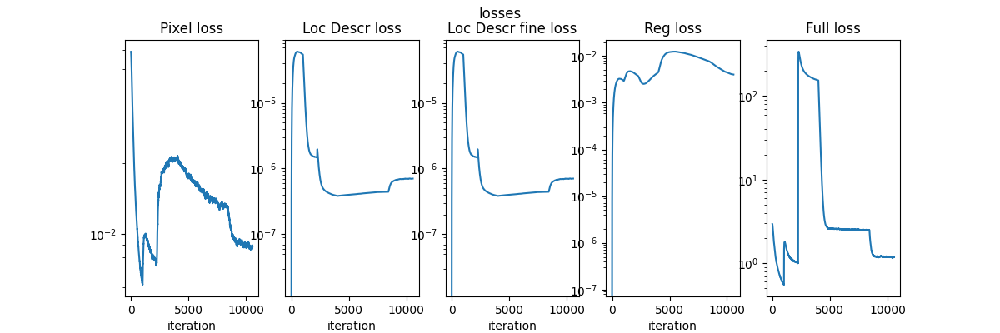

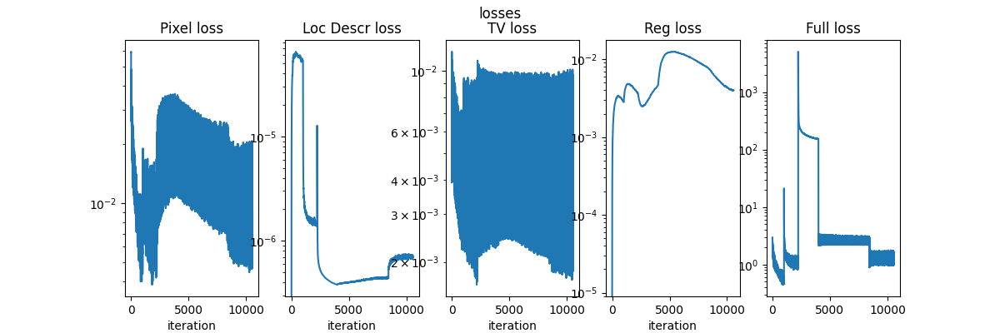

In [694]:
fig, ax = plt.subplots(nrows=1, ncols=5, figsize=(12,4))
fig.suptitle("losses")
ax[0].set_title("Pixel loss")
ax[0].plot(calculate_ema(losses_pixel))
ax[0].set_yscale('log')
ax[1].set_title("Loc Descr loss")
ax[1].plot(calculate_ema(losses_loc_descr))
ax[1].set_yscale('log')

# ax[2].set_title("TV loss")
# ax[2].plot(calculate_ema(losses_tv))
# ax[2].set_yscale('log')

ax[2].set_title("Loc Descr fine loss")
ax[2].plot(calculate_ema(losses_loc_descr_fine))
ax[2].set_yscale('log')

ax[3].set_title("Reg loss")
ax[3].plot(calculate_ema(losses_reg))
ax[3].set_yscale('log')
ax[4].set_title("Full loss")
ax[4].plot(calculate_ema(losses_full))
ax[4].set_yscale('log')

for i in range(4): ax[i].set_xlabel("iteration")

plt.show()

fig, ax = plt.subplots(nrows=1, ncols=5, figsize=(12,4))
fig.suptitle("losses")
ax[0].set_title("Pixel loss")
ax[0].plot(losses_pixel)
ax[0].set_yscale('log')
ax[1].set_title("Loc Descr loss")
ax[1].plot(losses_loc_descr)
ax[1].set_yscale('log')

ax[2].set_title("TV loss")
ax[2].plot(losses_tv)
ax[2].set_yscale('log')
ax[3].set_title("Reg loss")
ax[3].plot(losses_reg)
ax[3].set_yscale('log')
ax[4].set_title("Full loss")
ax[4].plot(losses_full)
ax[4].set_yscale('log')

for i in range(4): ax[i].set_xlabel("iteration")

plt.show()


In [695]:
gaussians_opt_features_dc_fitted = gaussians_opt._features_dc.data.detach().clone()

In [697]:
gaussians_opt._features_dc.data = gaussians_opt_features_dc_original.clone()
gaussians_opt._features_rest.data = gaussians_opt_features_rest_original.clone()

In [465]:
gaussians_opt._scaling.data /=  1.1

In [543]:
start_idx, end_idx = dict_name_to_style_idcs[15]
gaussians_opt._scaling.data[start_idx:end_idx] *= 1.05

In [659]:
viewpoint_stack = scene_opt.getTrainCameras().copy()
viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


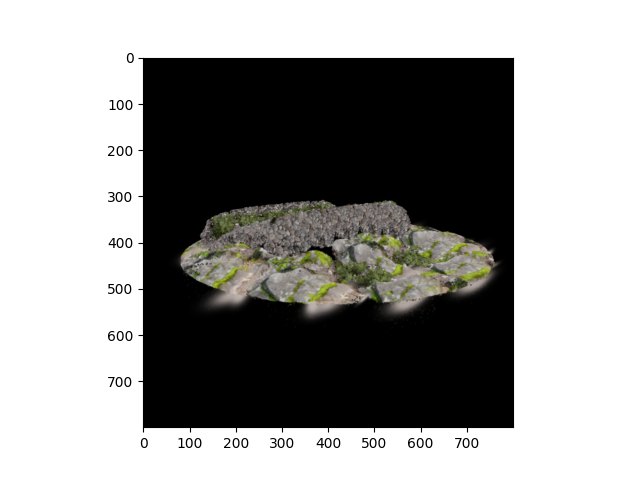

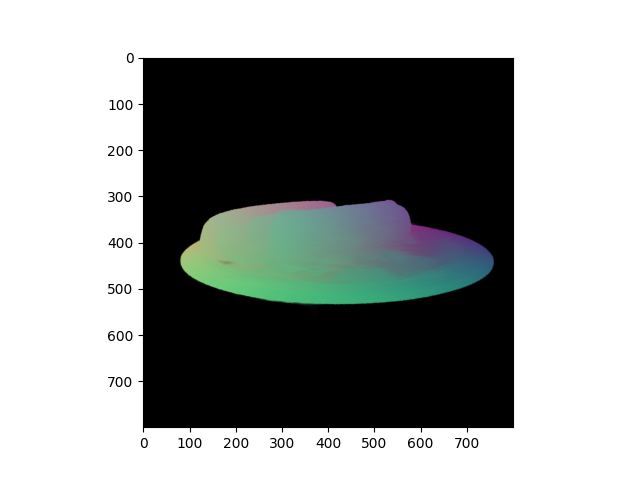

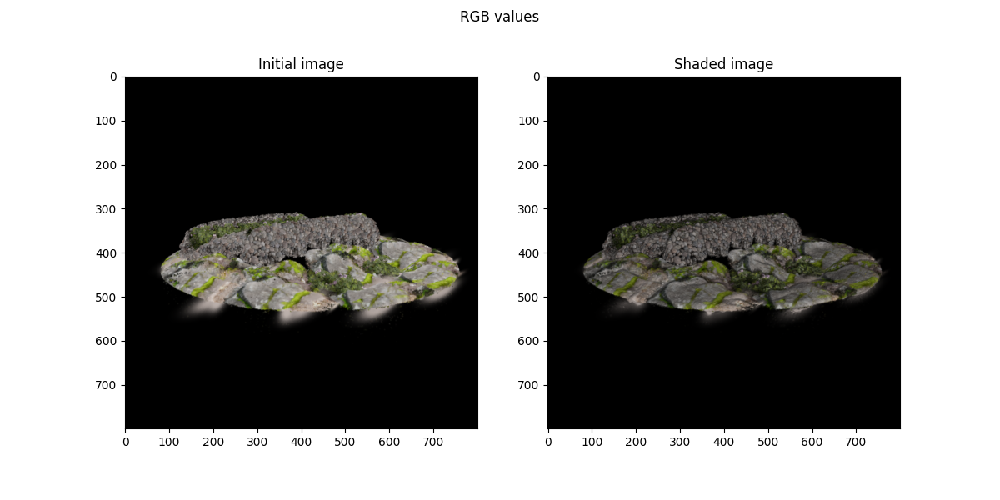

In [698]:
SCALING_FACTOR = 1.
# Sample camera

gaussians_opt._scaling.data /=  SCALING_FACTOR





# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


# Visualize
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()







scaling_for_depth_blurring = 1.1

render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, _= render_pkg["render"], render_pkg["depth"]


gaussians_opt._scaling.data /= scaling_for_depth_blurring
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
_, depth_scaled= render_pkg["render"], render_pkg["depth"]
image_shaded = shade_image_gpu(img_color=image,
                               img_depth=depth_scaled,
                          ambnt_lght=torch.tensor(np.array([.1,.1,.1])*.5, dtype=torch.float32).to(device=device),
                          drct_lght_color=torch.tensor(np.array([1., 1., 1.]), dtype=torch.float32).to(device=device),
                          drct_lght_dir =torch.tensor(np.array([-.2, -.3, 2.6]), dtype=torch.float32).to(device=device))
                          # drct_lght_dir =torch.tensor(np.array([.2, .3, 6.6]), dtype=torch.float32).to(device=device))
                               # drct_lght_dir =torch.tensor(np.array([-1.0, 2.001, 3.0001]), dtype=torch.float32).to(device=device))
gaussians_opt._scaling.data *= scaling_for_depth_blurring



gaussians_opt._scaling.data *=  SCALING_FACTOR

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12,6))
fig.suptitle("RGB values")
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
image_rgb = np.clip(image_rgb*255, 0, 255).astype(np.uint8) 
ax0 = ax[0].imshow(image_rgb)
ax[0].set_title("Initial image")

image_rgb = image_shaded.detach().cpu().numpy().transpose(1, 2, 0)
image_rgb = np.clip(image_rgb*255, 0, 255).astype(np.uint8) 
ax1 = ax[1].imshow(image_rgb)
ax[1].set_title("Shaded image")

plt.show()




In [1]:
print("yo")

yo


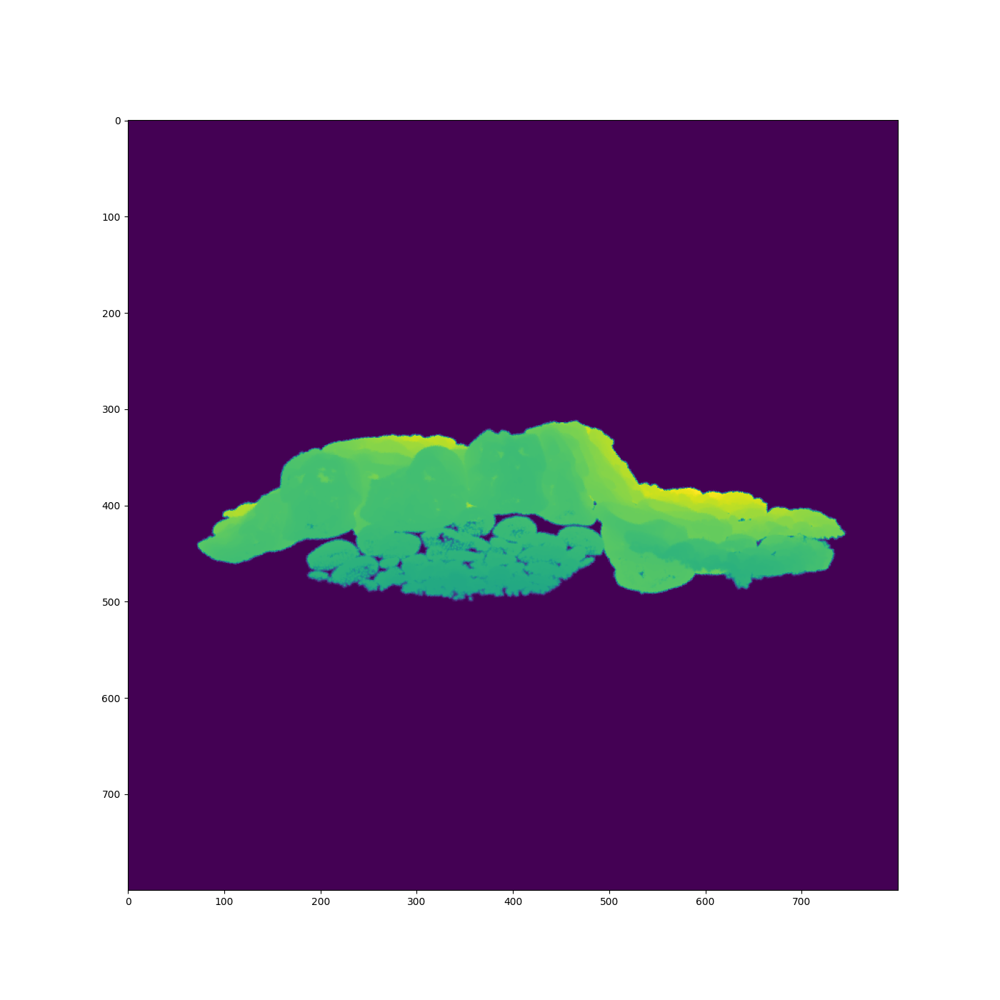

In [438]:
# Visualize
image_rgb = depth.detach().cpu().numpy()
plt.figure(figsize=(14,14))
plt.imshow(image_rgb)
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


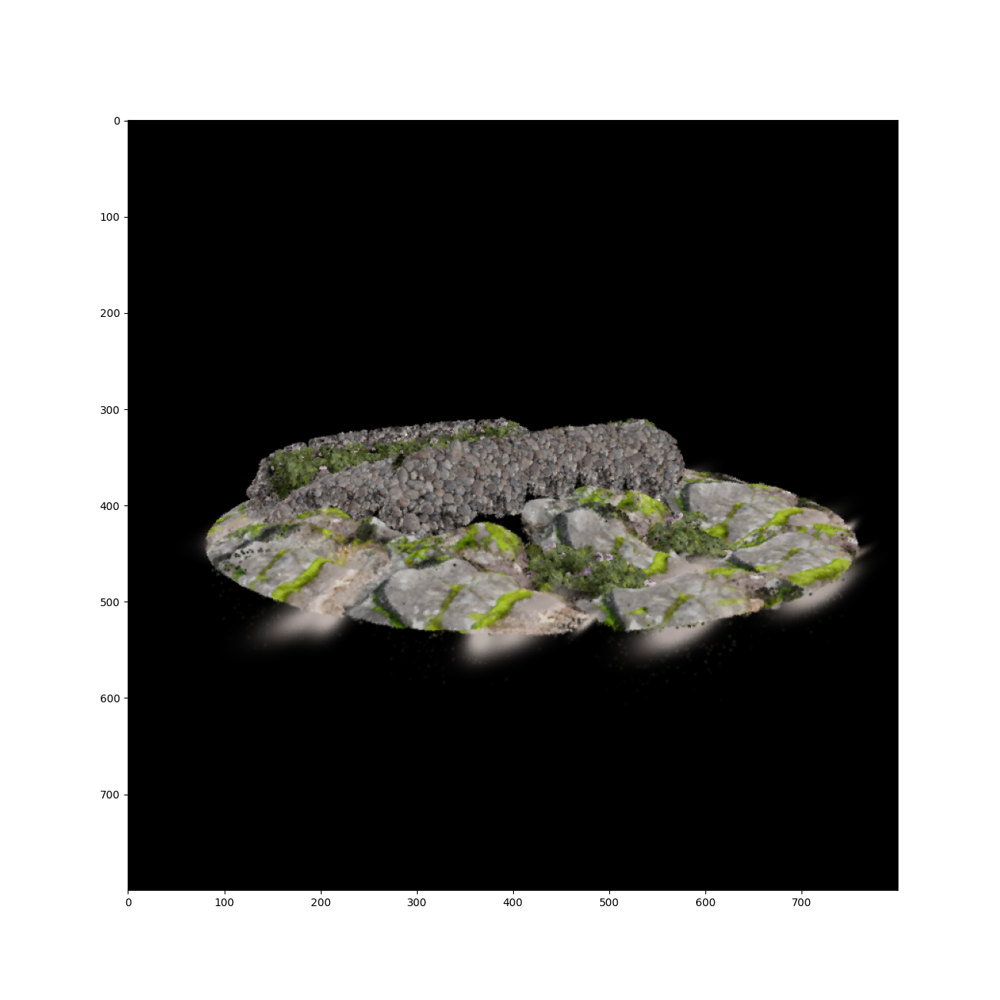

In [699]:
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure(figsize=(13,13))
plt.imshow(image_rgb)
plt.show()

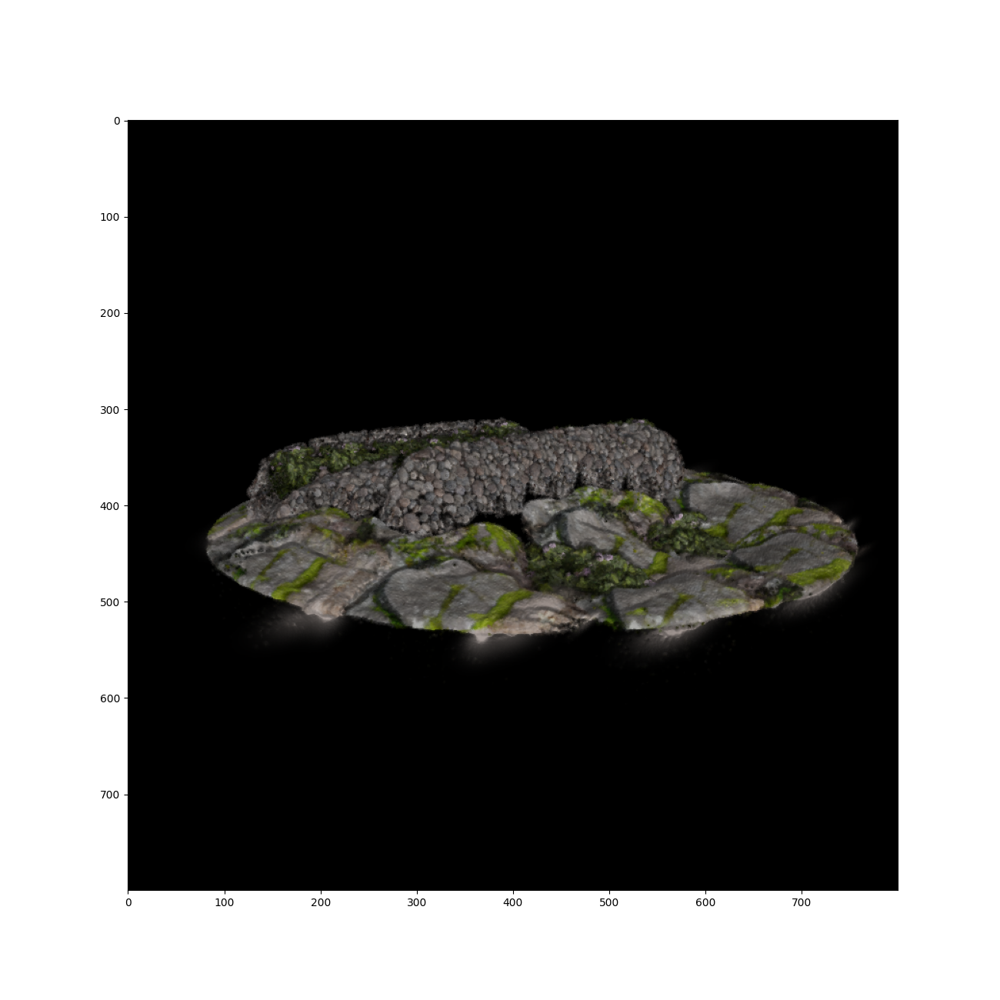

In [700]:

image_rgb = image_shaded.detach().cpu().numpy().transpose(1, 2, 0)
image_rgb = np.clip(image_rgb*255, 0, 255).astype(np.uint8) 
plt.figure(figsize=(13,13))
plt.imshow(image_rgb)
plt.show()

In [189]:
print("you")

you


In [691]:
gaussians_opt._features_dc.data = gaussians_opt_features_dc_fitted.clone()
gaussians_opt._features_rest.data *= 0.

In [701]:
import sys
sys.path.append("../")

from scene import GaussianModel
MODEL_DIR = './dummy_scene/' 
# MODEL_DIR_NEW = './fit_hotdog_with_rose_bush_lego_coast_rocks_fitted_with_masks_orig_scaling/'
MODEL_DIR_NEW = './fit_hotdog_rocks4_pebbles_rosebush_v1_converged3/'
os.makedirs(MODEL_DIR_NEW, exist_ok = True)

! cp -r {MODEL_DIR}* {MODEL_DIR_NEW}
# ls MODEL_DIR


iteration=1
torch.save((gaussians_opt.capture(), iteration), MODEL_DIR_NEW + "/chkpnt" + str(iteration) + ".pth")
gaussians_opt.save_ply(os.path.join(MODEL_DIR_NEW, "point_cloud/iteration_1/", "point_cloud.ply"))



In [54]:
gaussians_opt._features_dc.data = gaussians_opt_features_dc_fitted.clone()
gaussians_opt._features_rest.data *= 0.

In [313]:
gaussians_opt_features_dc_original.data

tensor([[[ 0.6640,  0.3750, -0.1996]],

        [[ 1.4526,  1.1696,  0.6101]],

        [[ 1.3919,  1.1112,  0.5335]],

        ...,

        [[ 1.0514,  0.7312,  0.1031]],

        [[ 1.2187,  0.9756,  0.4335]],

        [[ 1.0862,  0.7459,  0.1637]]], device='cuda:0')

In [502]:
with torch.no_grad():
    colors = torch.nn.Parameter(torch.randn((C,3), dtype=torch.float32), requires_grad=True).to(device=device) / 1e1
    colors_gaussians = torch.concat([torch.stack([x]*N, dim=0) for x in colors], dim=0).unsqueeze(1).to(device=device)
    #gaussians_opt._features_dc.data = gaussians_opt._features_dc.data + colors_gaussians.data
    
    gaussians_opt._features_dc = gaussians_opt_features_dc_original.clone()  + colors_gaussians
    gaussians_opt._features_rest.data = gaussians_opt_features_rest_original.clone()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


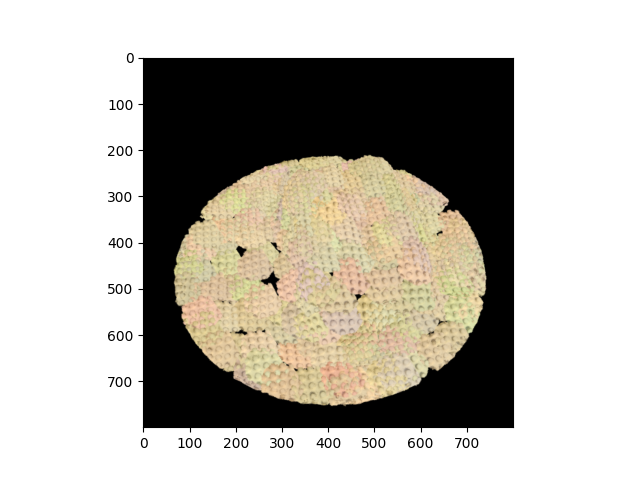

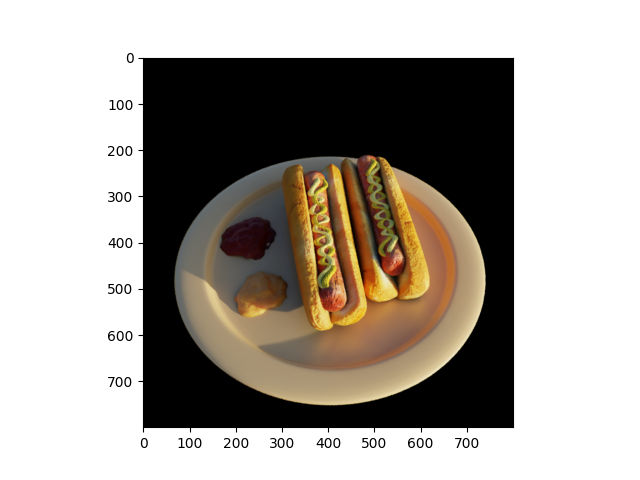

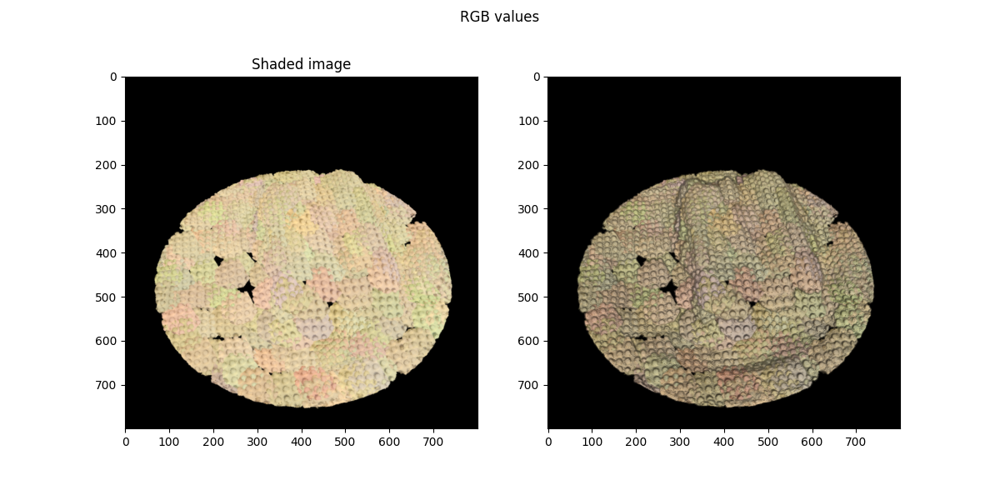

In [503]:
SCALING_FACTOR = 1.
# Sample camera

gaussians_opt._scaling.data /=  SCALING_FACTOR





# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


# Visualize
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()







scaling_for_depth_blurring = 1.1

render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, _= render_pkg["render"], render_pkg["depth"]


gaussians_opt._scaling.data /= scaling_for_depth_blurring
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
_, depth_scaled= render_pkg["render"], render_pkg["depth"]
image_shaded = shade_image_gpu(img_color=image,
                               img_depth=depth_scaled,
                          ambnt_lght=torch.tensor(np.array([.1,.1,.1])*.5, dtype=torch.float32).to(device=device),
                          drct_lght_color=torch.tensor(np.array([1., 1., 1.]), dtype=torch.float32).to(device=device),
                          drct_lght_dir =torch.tensor(np.array([-.2, -.3, 2.6]), dtype=torch.float32).to(device=device))
                          # drct_lght_dir =torch.tensor(np.array([.2, .3, 6.6]), dtype=torch.float32).to(device=device))
                               # drct_lght_dir =torch.tensor(np.array([-1.0, 2.001, 3.0001]), dtype=torch.float32).to(device=device))
gaussians_opt._scaling.data *= scaling_for_depth_blurring



gaussians_opt._scaling.data *=  SCALING_FACTOR

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12,6))
fig.suptitle("RGB values")
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
image_rgb = np.clip(image_rgb*255, 0, 255).astype(np.uint8) 
ax0 = ax[0].imshow(image_rgb)
ax[0].set_title("Initial image")

image_rgb = image_shaded.detach().cpu().numpy().transpose(1, 2, 0)
image_rgb = np.clip(image_rgb*255, 0, 255).astype(np.uint8) 
ax1 = ax[1].imshow(image_rgb)
ax[0].set_title("Shaded image")

plt.show()




In [409]:
gaussians_opt._features_dc.data.shape, N, C

(torch.Size([542800, 1, 3]), 2714, 200)

In [419]:
torch.mean(reg_loss)

tensor(0.3290, device='cuda:0')

# Now optimize for colors

In [438]:
content_gaussians.restore(torch.load("/home/dimakot55/output_data/gs/GT_hotdog/chkpnt30000.pth")[0], opt)
gaussians_opt.restore(torch.load("./fit_hotdog_with_lego_200_clusters_v1/chkpnt1.pth")[0], opt)

In [504]:
gaussians_opt._features_dc.requires_grad = True
gaussians_opt._features_rest.requires_grad = False

In [505]:
# optimizer_color = torch.optim.Adam([gaussians_opt._features_dc, gaussians_opt._features_rest], lr=1e-2)
optimizer_color = torch.optim.Adam([gaussians_opt._features_dc], lr=1e-2)
# optimizer_color = torch.optim.Adam([colors], lr=1e-2)

losses_color = []
losses_color_reg = []

In [506]:


for step in tqdm(range(5001)):
    optimizer_color.zero_grad()
    if True:
        # Pick a random Camera
        if not viewpoint_stack:
           viewpoint_stack = scene_opt.getTrainCameras().copy()
        viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
    # Optimization gaussians
    render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
    image, depth= render_pkg["render"], render_pkg["depth"]
    # Content gaussians
    render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
    image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


    colors_reshaped = torch.reshape(gaussians_opt._features_dc, (C, N, 1, 3))
    loss_color_reg = torch.mean(torch.std(colors_reshaped, dim=1))
    # loss_color_reg = torch.mean(torch.square(colors_reshaped))

    loss_rgb = l1_loss(image, image_cont)  
    
    loss = loss_rgb + loss_color_reg * 1e-1
    loss.backward()

    optimizer_color.step()
    losses_color.append(float(loss_rgb.detach().cpu().numpy()))
    losses_color_reg.append(float(loss_color_reg.detach().cpu().numpy()))



    
    if step % 100 == 0:
        print(f"loss_rgb:{loss_rgb:.7f}, losses_color_reg:{loss_color_reg:.7f}")



/tmp/ipykernel_504340/2404923381.py:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for step in tqdm(range(5001)):


  0%|          | 0/5001 [00:00<?, ?it/s]

loss_rgb:0.0692179, losses_color_reg:0.3290335
loss_rgb:0.0520716, losses_color_reg:0.0500682
loss_rgb:0.0206022, losses_color_reg:0.0327017
loss_rgb:0.0413898, losses_color_reg:0.0386165
loss_rgb:0.0248415, losses_color_reg:0.0425639
loss_rgb:0.0378131, losses_color_reg:0.0466030
loss_rgb:0.0155518, losses_color_reg:0.0446885
loss_rgb:0.0151360, losses_color_reg:0.0435578
loss_rgb:0.0199742, losses_color_reg:0.0458813
loss_rgb:0.0196622, losses_color_reg:0.0482206
loss_rgb:0.0164851, losses_color_reg:0.0457400
loss_rgb:0.0195741, losses_color_reg:0.0449530
loss_rgb:0.0260952, losses_color_reg:0.0463835
loss_rgb:0.0250223, losses_color_reg:0.0521987
loss_rgb:0.0200438, losses_color_reg:0.0466716
loss_rgb:0.0282439, losses_color_reg:0.0455452


KeyboardInterrupt: 

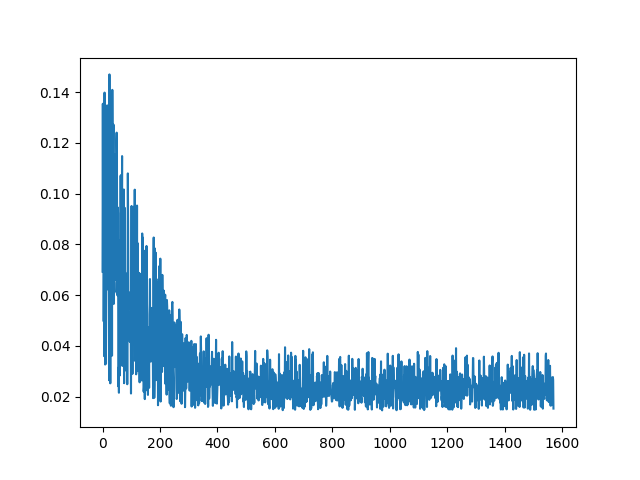

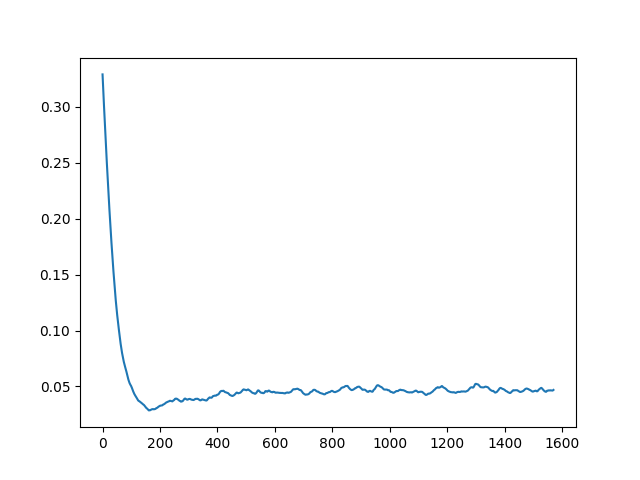

In [507]:
plt.figure()
plt.plot(losses_color)
plt.show()

plt.figure()
plt.plot(losses_color_reg)
plt.show()

In [509]:
viewpoint_stack = scene_opt.getTrainCameras().copy()
viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))

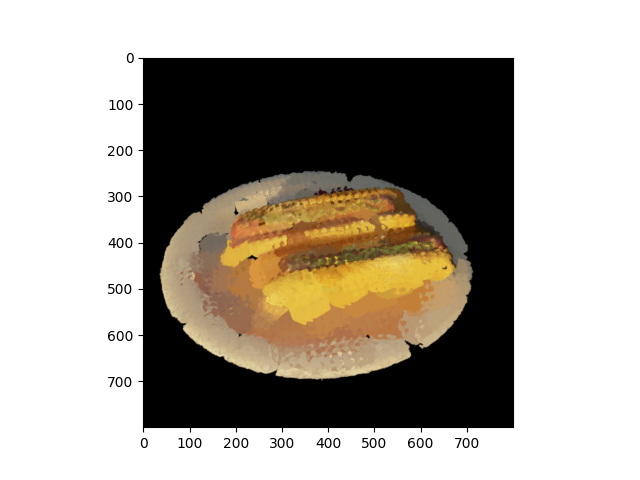

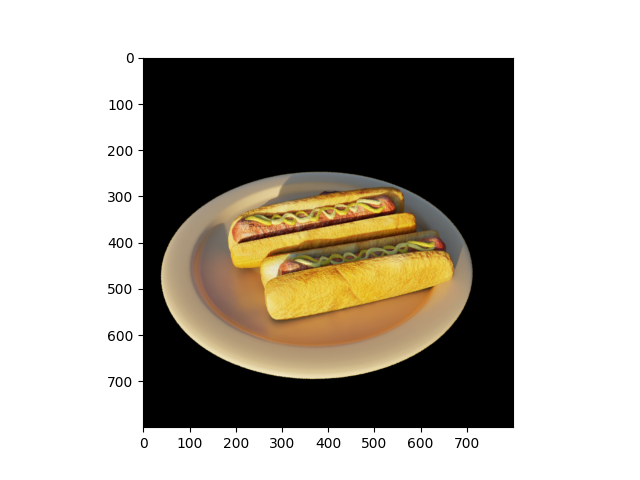

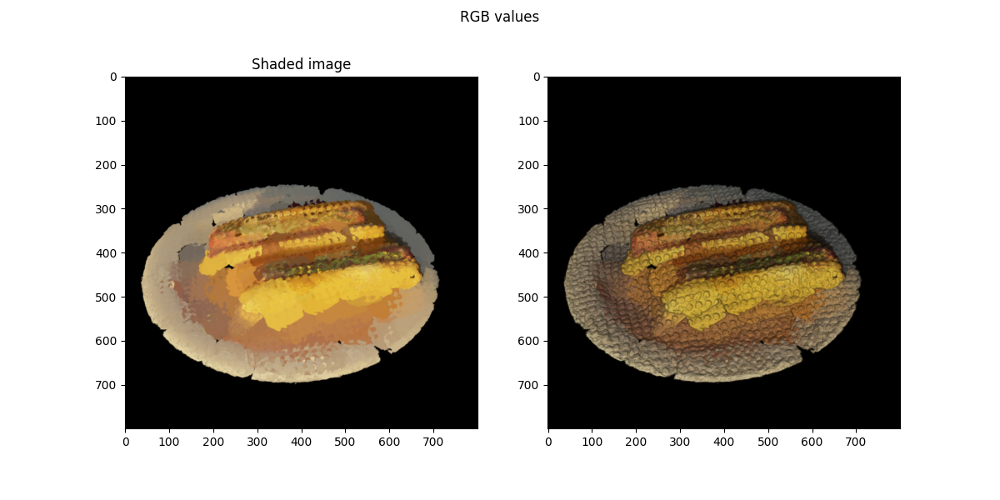

In [510]:
SCALING_FACTOR = 1.
# Sample camera

gaussians_opt._scaling.data /=  SCALING_FACTOR





# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


# Visualize
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()







scaling_for_depth_blurring = 1.1

render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, _= render_pkg["render"], render_pkg["depth"]


gaussians_opt._scaling.data /= scaling_for_depth_blurring
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
_, depth_scaled= render_pkg["render"], render_pkg["depth"]
image_shaded = shade_image_gpu(img_color=image,
                               img_depth=depth_scaled,
                          ambnt_lght=torch.tensor(np.array([.1,.1,.1])*.5, dtype=torch.float32).to(device=device),
                          drct_lght_color=torch.tensor(np.array([1., 1., 1.]), dtype=torch.float32).to(device=device),
                          drct_lght_dir =torch.tensor(np.array([-.2, -.3, 2.6]), dtype=torch.float32).to(device=device))
                          # drct_lght_dir =torch.tensor(np.array([.2, .3, 6.6]), dtype=torch.float32).to(device=device))
                               # drct_lght_dir =torch.tensor(np.array([-1.0, 2.001, 3.0001]), dtype=torch.float32).to(device=device))
gaussians_opt._scaling.data *= scaling_for_depth_blurring



gaussians_opt._scaling.data *=  SCALING_FACTOR

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12,6))
fig.suptitle("RGB values")
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
image_rgb = np.clip(image_rgb*255, 0, 255).astype(np.uint8) 
ax0 = ax[0].imshow(image_rgb)
ax[0].set_title("Initial image")

image_rgb = image_shaded.detach().cpu().numpy().transpose(1, 2, 0)
image_rgb = np.clip(image_rgb*255, 0, 255).astype(np.uint8) 
ax1 = ax[1].imshow(image_rgb)
ax[0].set_title("Shaded image")

plt.show()




In [511]:
import sys
sys.path.append("../")

from scene import GaussianModel
MODEL_DIR = './dummy_scene/'
MODEL_DIR_NEW = './fit_hotdog_with_lego_200_clusters_v2_colored/'
os.makedirs(MODEL_DIR_NEW, exist_ok = True)

! cp -r {MODEL_DIR}* {MODEL_DIR_NEW}
# ls MODEL_DIR


iteration=1
torch.save((gaussians_opt.capture(), iteration), MODEL_DIR_NEW + "/chkpnt" + str(iteration) + ".pth")
gaussians_opt.save_ply(os.path.join(MODEL_DIR_NEW, "point_cloud/iteration_1/", "point_cloud.ply"))



In [302]:
losses_color = []

gaussians_opt.training_setup(opt)
# for param_group in gaussians_opt.optimizer.param_groups:
#         param_group['lr'] = 1e-4


gaussians_opt._xyz.requires_grad = False
gaussians_opt._features_dc.requires_grad = True
gaussians_opt._features_rest.requires_grad = False
gaussians_opt._scaling.requires_grad = False
gaussians_opt._rotation.requires_grad = False
gaussians_opt._opacity.requires_grad = False
gaussians_opt.max_radii2D.requires_grad = False

In [303]:

for step in tqdm(range(5001)):
    gaussians_opt.optimizer.zero_grad()
    if True:
        # Pick a random Camera
        if not viewpoint_stack:
           viewpoint_stack = scene_opt.getTrainCameras().copy()
        viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
    # Optimization gaussians
    render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
    image, depth= render_pkg["render"], render_pkg["depth"]
    # Content gaussians
    render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
    image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


    loss_rgb = l1_loss(image, image_cont) 
    
    loss = loss_rgb
    loss.backward()

    gaussians_opt.optimizer.step()
    losses_color.append(float(loss_rgb.detach().cpu().numpy()))



    
    if step % 100 == 0:
        print(f"loss_rgb:{loss_rgb:.7f}")



/tmp/ipykernel_504340/3201841820.py:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for step in tqdm(range(5001)):


  0%|          | 0/5001 [00:00<?, ?it/s]

loss_rgb:0.1401907
loss_rgb:0.0503510
loss_rgb:0.0332035
loss_rgb:0.0345448
loss_rgb:0.0357986
loss_rgb:0.0328486
loss_rgb:0.0171343
loss_rgb:0.0235408
loss_rgb:0.0434037
loss_rgb:0.0345820
loss_rgb:0.0141803
loss_rgb:0.0244571
loss_rgb:0.0143464


KeyboardInterrupt: 

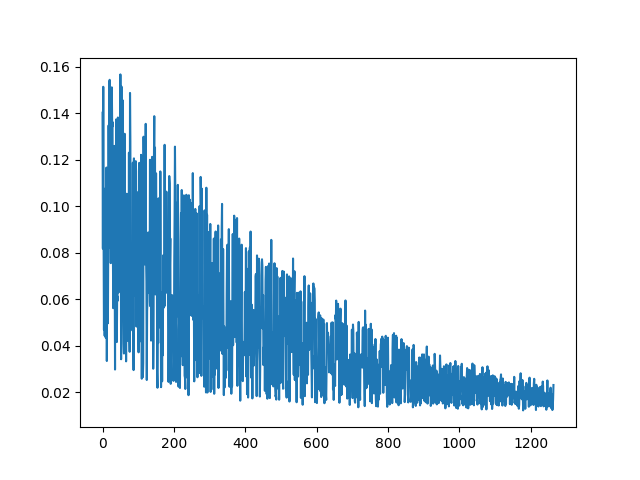

In [304]:
plt.figure()
plt.plot(losses_color)
plt.show()

In [310]:
viewpoint_stack = scene_opt.getTrainCameras().copy()
viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


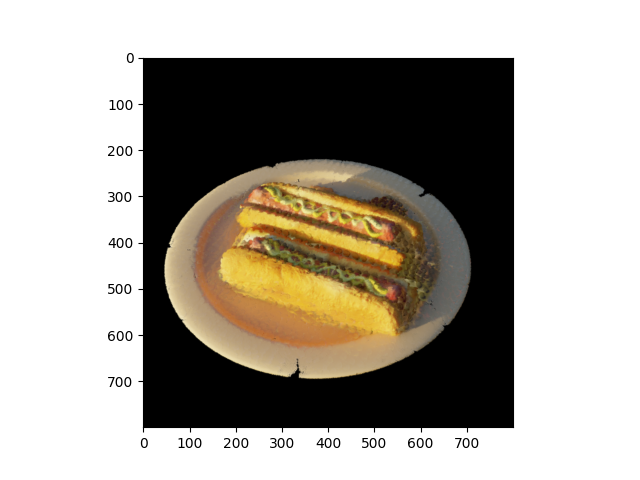

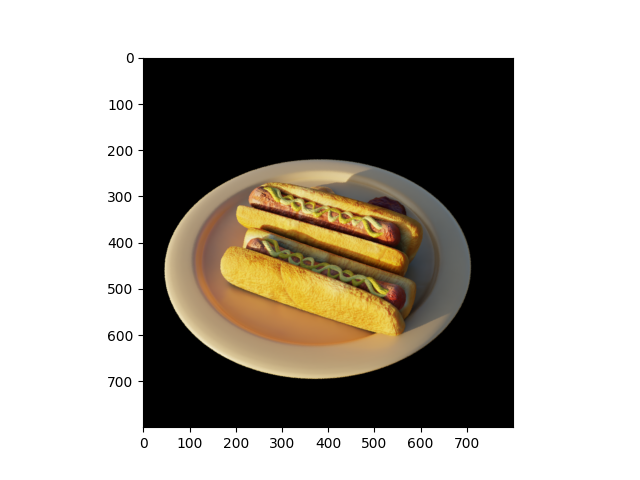

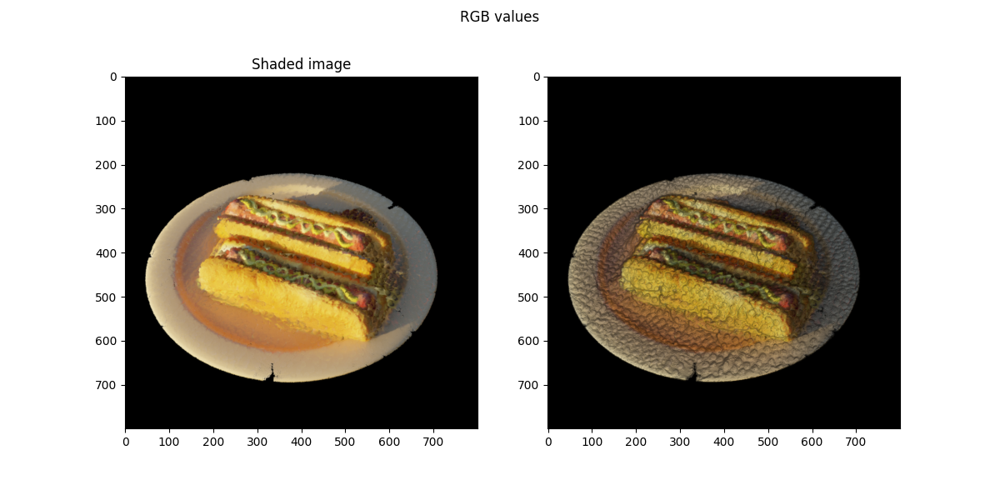

In [311]:
SCALING_FACTOR = 1.
# Sample camera

gaussians_opt._scaling.data /=  SCALING_FACTOR





# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


# Visualize
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()







scaling_for_depth_blurring = 1.1

render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, _= render_pkg["render"], render_pkg["depth"]


gaussians_opt._scaling.data /= scaling_for_depth_blurring
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
_, depth_scaled= render_pkg["render"], render_pkg["depth"]
image_shaded = shade_image_gpu(img_color=image,
                               img_depth=depth_scaled,
                          ambnt_lght=torch.tensor(np.array([.1,.1,.1])*.5, dtype=torch.float32).to(device=device),
                          drct_lght_color=torch.tensor(np.array([1., 1., 1.]), dtype=torch.float32).to(device=device),
                          drct_lght_dir =torch.tensor(np.array([-.2, -.3, 2.6]), dtype=torch.float32).to(device=device))
                          # drct_lght_dir =torch.tensor(np.array([.2, .3, 6.6]), dtype=torch.float32).to(device=device))
                               # drct_lght_dir =torch.tensor(np.array([-1.0, 2.001, 3.0001]), dtype=torch.float32).to(device=device))
gaussians_opt._scaling.data *= scaling_for_depth_blurring



gaussians_opt._scaling.data *=  SCALING_FACTOR

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12,6))
fig.suptitle("RGB values")
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
image_rgb = np.clip(image_rgb*255, 0, 255).astype(np.uint8) 
ax0 = ax[0].imshow(image_rgb)
ax[0].set_title("Initial image")

image_rgb = image_shaded.detach().cpu().numpy().transpose(1, 2, 0)
image_rgb = np.clip(image_rgb*255, 0, 255).astype(np.uint8) 
ax1 = ax[1].imshow(image_rgb)
ax[0].set_title("Shaded image")

plt.show()


